In [86]:
%load_ext autoreload
%autoreload 2
import numpy as np
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl

import sys
import os

pltfxn_fp = '/Users/manda/REU24/PyGEM-EB/pygem_eb/processing'
sys.path.append(pltfxn_fp)

from plotting_fxns import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [133]:
glacier = 'Gulkana'
id = '0' #Original Data
date = str(pd.Timestamp.today()).replace('-','_')[0:10]
#date = '2024_07_02'
data_fp = f'/Users/manda/REU24/Output/EB/{glacier}_{date}_#.nc'
ds,startdate,enddate = getds(data_fp.replace('#',id))

id = '1' #Synthetic HW
ds2,startdate,enddate = getds(data_fp.replace('#',id))

id = '2' #No Heatwaves
ds3,startdate,enddate = getds(data_fp.replace('#',id))

id = '10'
ds4,startdate,enddate = getds(data_fp.replace('#',id))

# base_fp = f'/home/claire/research/Output/EB/Gulkana_2024_05_07_3.nc'
# base_ds,_,_ = getds(base_fp)
#stake_df = pd.read_csv('~/research/MB_data/Stakes/gulkanaAB23_ALL.csv')
#stake_df.index = pd.to_datetime(stake_df['Date'])
#temp_df = pd.read_csv('~/research/MB_data/Gulkana/field_data/iButton_2023_all.csv',index_col=0)
#temp_df = temp_df.set_index(pd.to_datetime(temp_df.index) - pd.Timedelta(hours=8))

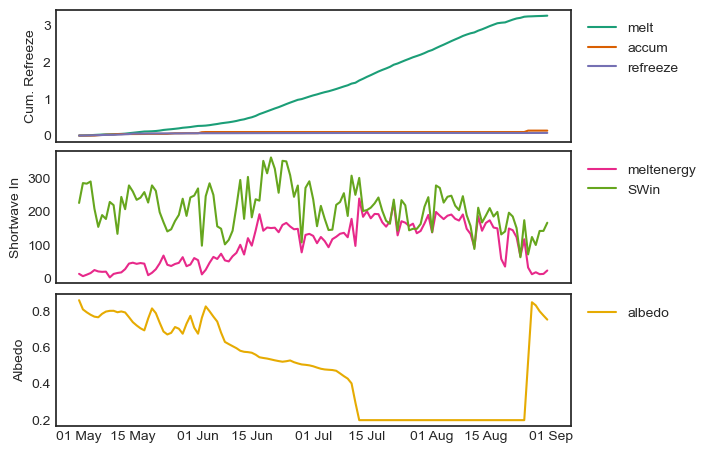

In [89]:
simple_plot(ds,0,[startdate,enddate],[['melt','accum','refreeze'],['meltenergy','SWin'],['albedo']])
dates = pd.date_range(startdate,enddate,freq='d')

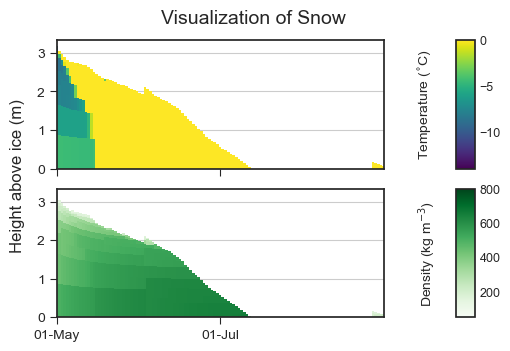

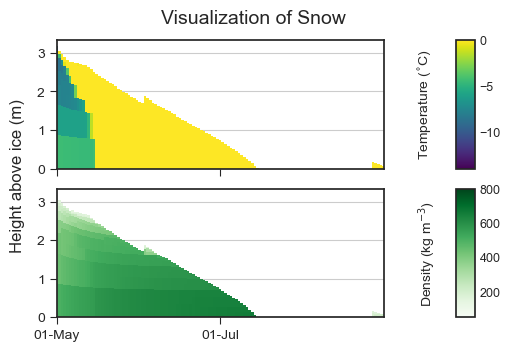

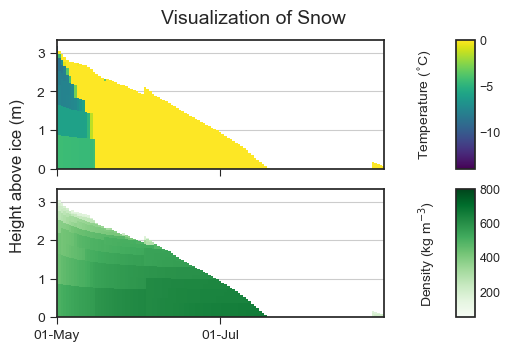

In [90]:
dates = pd.date_range(startdate,enddate,freq='d')
visualize_layers(ds,0,dates,['layertemp','layerdensity'])
visualize_layers(ds2,0,dates,['layertemp','layerdensity'])
visualize_layers(ds3,0,dates,['layertemp','layerdensity'])

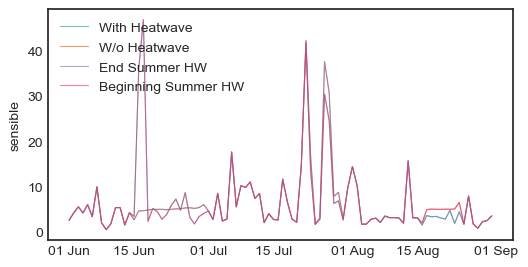

In [10]:
compare_runs([ds,ds2,ds3,ds4],[startdate,enddate],['With Heatwave','W/o Heatwave','End Summer HW', 'Beginning Summer HW'],'sensible')

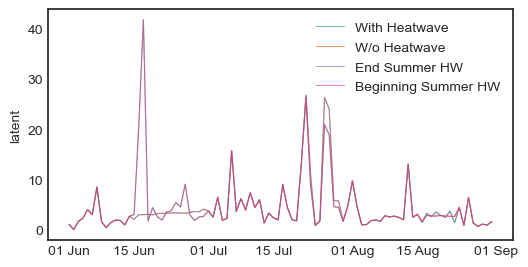

In [11]:
compare_runs([ds,ds2,ds3,ds4],[startdate,enddate],['With Heatwave','W/o Heatwave','End Summer HW', 'Beginning Summer HW'],'latent')

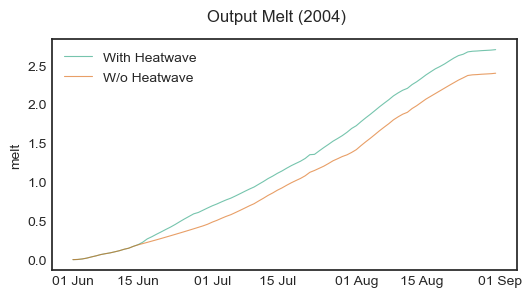

In [56]:
compare_runs([ds,ds2],[startdate,enddate],['With Heatwave','W/o Heatwave'],'melt',t='Output Melt (2004)')

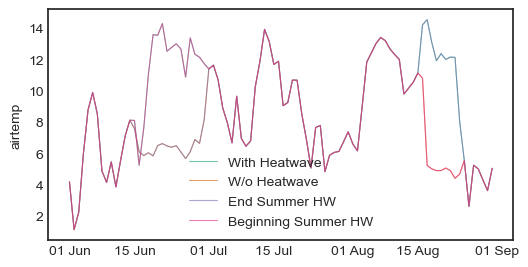

In [13]:
compare_runs([ds,ds2,ds3,ds4],[startdate,enddate],['With Heatwave','W/o Heatwave','End Summer HW', 'Beginning Summer HW'],'airtemp')

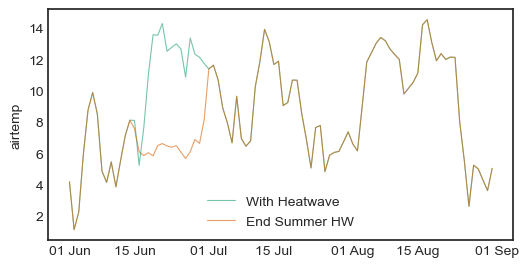

In [33]:
compare_runs([ds,ds3],[startdate,enddate],['With Heatwave','End Summer HW'],'airtemp')

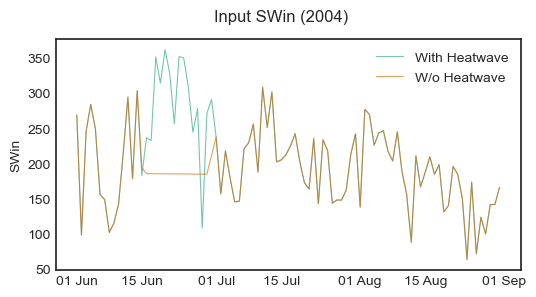

In [32]:
compare_runs([ds,ds3],[startdate,enddate],['With Heatwave','W/o Heatwave'],'SWin', t='Input SWin (2004)')

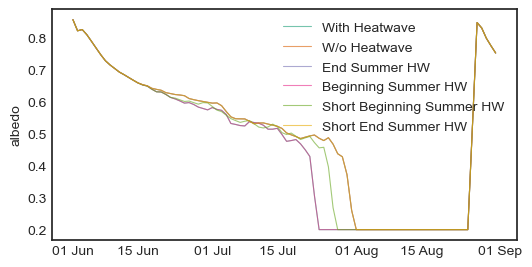

In [7]:
compare_runs([ds,ds2,ds3,ds4,ds5,ds6],[startdate,enddate],['With Heatwave','W/o Heatwave','End Summer HW', 'Beginning Summer HW', 'Short Beginning Summer HW', 'Short End Summer HW'],'albedo')

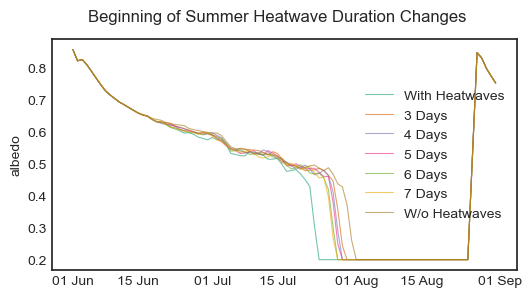

In [34]:
compare_runs([ds,ds7,ds8,ds9,ds10,ds5,ds2],[startdate,enddate],['With Heatwaves','3 Days','4 Days', '5 Days', '6 Days','7 Days','W/o Heatwaves'],'albedo',t='Beginning of Summer Heatwave Duration Changes')

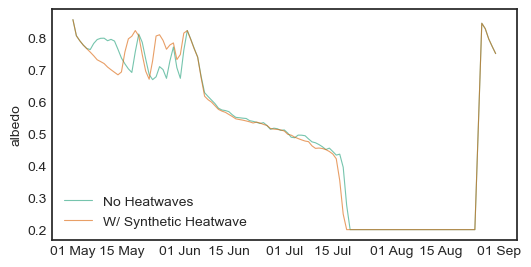

In [134]:
compare_runs([ds3,ds4],[startdate,enddate],['No Heatwaves','W/ Synthetic Heatwave'],'albedo')

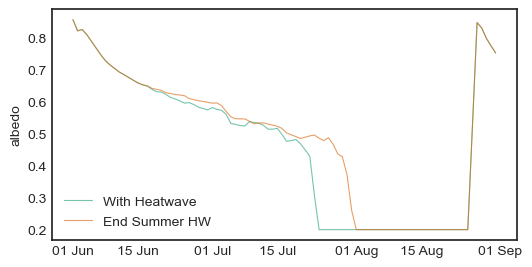

In [17]:
compare_runs([ds,ds3],[startdate,enddate],['With Heatwave','End Summer HW'],'albedo')

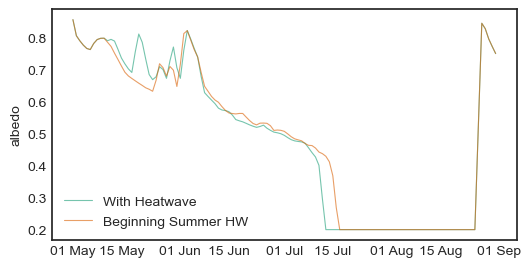

In [106]:
compare_runs([ds,ds4],[startdate,enddate],['With Heatwave','Beginning Summer HW'],'albedo')

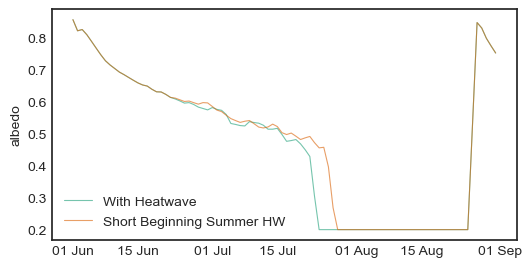

In [5]:
compare_runs([ds,ds5],[startdate,enddate],['With Heatwave','Short Beginning Summer HW'],'albedo')

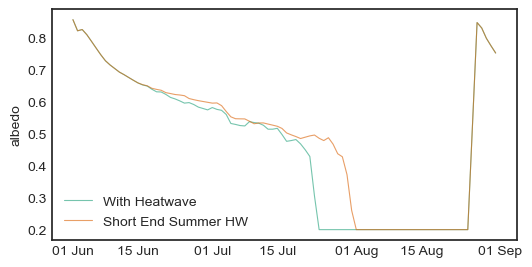

In [6]:
compare_runs([ds,ds6],[startdate,enddate],['With Heatwave','Short End Summer HW'],'albedo')

In [9]:
def difference_variable(ds, ds2, date_range, labels, variable):
    # Extracting the date range
    startdate, enddate = date_range
    
    # Filtering the datasets based on the date range
    ds_filtered = ds.sel(time=slice(startdate, enddate))
    ds2_filtered = ds2.sel(time=slice(startdate, enddate))
    
    # Extracting the specified variable (albedo)
    var_ds = ds_filtered[variable]
    var_ds2 = ds2_filtered[variable]
    
    # Calculating the difference
    var_diff = var_ds - var_ds2
    
    # Plotting the difference
    fig,ax = plt.subplots(figsize=(6,3))
    c = plt.cm.Dark2(1)
    var_diff.plot(ax=ax, label=f'{labels[0]} - {labels[1]}', color=c, alpha=0.6, linewidth=0.8)
    date_form = mpl.dates.DateFormatter('%d %b')
    ax.xaxis.set_major_formatter(date_form)
    ax.set_ylabel(f'{variable} Difference')
    ax.grid(True)
    fig.suptitle(f'Difference in {variable} between {labels[0]} and {labels[1]}')
    ax.set_title('')

    if variable == 'albedo':    
        non_zero_divergence = var_diff.where(var_diff != 0, drop=True).time
        zero_crossings = var_diff.where(var_diff >= 0, drop=True).time
        more_neg = var_diff.where(var_diff <= -0.05, drop=True).time

        if non_zero_divergence.size > 0:
            first_divergence_date = non_zero_divergence[0].values
            print(f"The difference diverges from zero for the first time on: {first_divergence_date}")
        if more_neg.size > 0:
            cross_date = more_neg[0].values
            print(f"The difference goes below -0.05 on: {cross_date}")
            return_date = zero_crossings.where(zero_crossings > cross_date, drop=True)
            if return_date.size > 0:
                end_date = return_date[0].values
                print(f"The difference goes back to zero on: {end_date}")
            else:
                print("The difference does not return to zero within the date range.")
        else:
            print("The difference does not go below -0.05 within the date range.")
    else:
        return None

The difference diverges from zero for the first time on: 2004-06-16T12:30:00.000000000
The difference goes below -0.05 on: 2004-07-22T12:30:00.000000000
The difference goes back to zero on: 2004-07-31T12:30:00.000000000


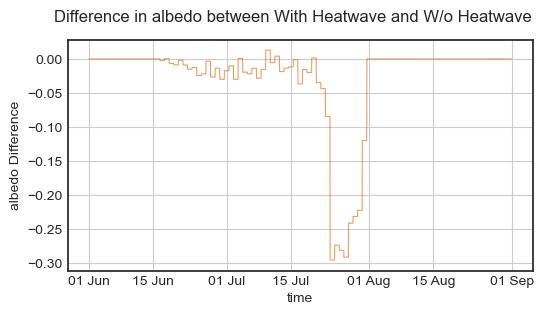

In [14]:
difference_variable(ds,ds2,[startdate,enddate],['With Heatwave','W/o Heatwave'],'albedo')

The difference diverges from zero for the first time on: 2004-08-26T12:30:00.000000000
The difference does not go below -0.05 within the date range.


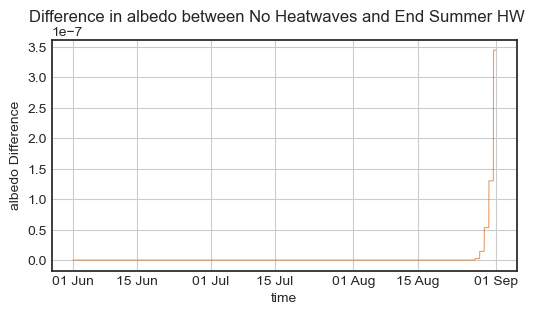

In [13]:
difference_variable(ds2,ds3,[startdate,enddate],['No Heatwaves','End Summer HW'],'albedo')

The difference diverges from zero for the first time on: 2004-08-26T12:30:00.000000000
The difference does not go below -0.05 within the date range.


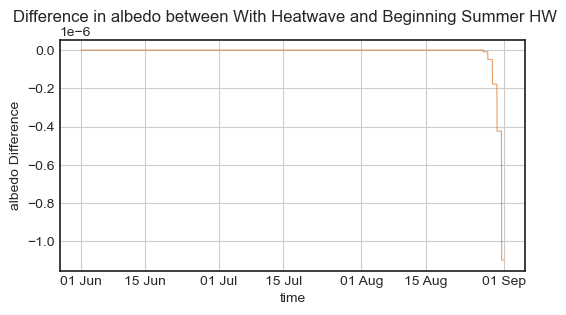

In [11]:
difference_variable(ds,ds4,[startdate,enddate],['With Heatwave','Beginning Summer HW'],'albedo')

The difference diverges from zero for the first time on: 2004-08-26T12:30:00.000000000
The difference does not go below -0.05 within the date range.


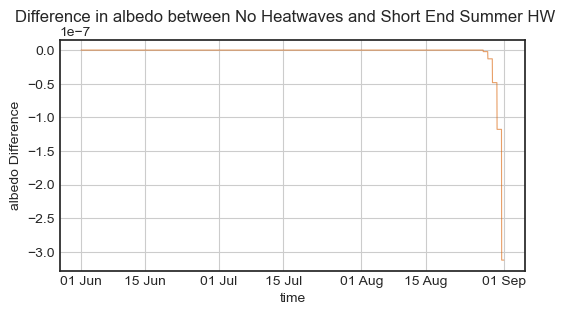

In [14]:
difference_variable(ds2,ds6,[startdate,enddate],['No Heatwaves','Short End Summer HW'],'albedo')

The difference diverges from zero for the first time on: 2004-06-23T12:30:00.000000000
The difference goes below -0.05 on: 2004-07-22T12:30:00.000000000
The difference goes back to zero on: 2004-07-27T12:30:00.000000000


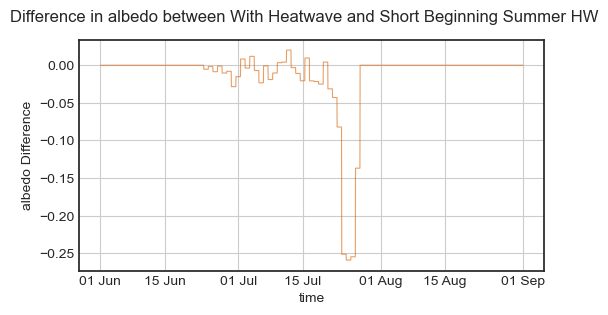

In [15]:
difference_variable(ds,ds5,[startdate,enddate],['With Heatwave','Short Beginning Summer HW'],'albedo')

The difference diverges from zero for the first time on: 2004-06-16T12:30:00.000000000
The difference goes below -0.05 on: 2004-07-26T12:30:00.000000000
The difference goes back to zero on: 2004-07-31T12:30:00.000000000


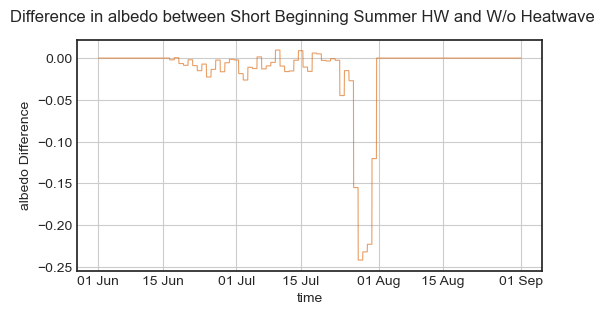

In [22]:
difference_variable(ds5,ds2,[startdate,enddate],['Short Beginning Summer HW','W/o Heatwave'],'albedo')

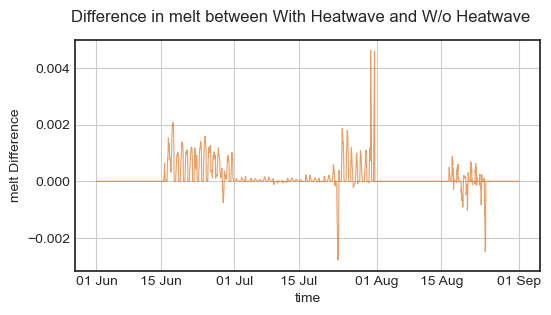

In [18]:
difference_variable(ds,ds2,[startdate,enddate],['With Heatwave','W/o Heatwave'],'melt')

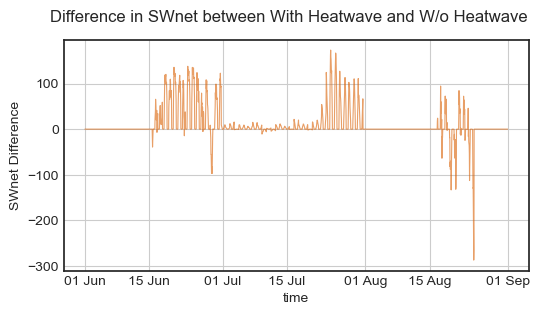

In [18]:
difference_variable(ds,ds2,[startdate,enddate],['With Heatwave','W/o Heatwave'],'SWnet')

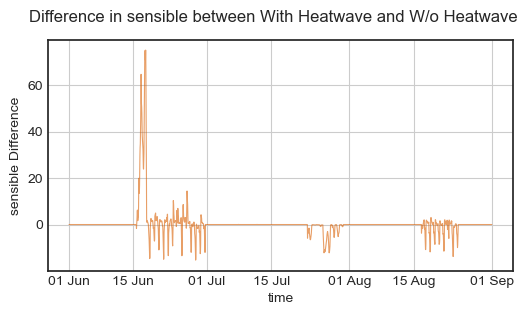

In [19]:
difference_variable(ds,ds2,[startdate,enddate],['With Heatwave','W/o Heatwave'],'sensible')

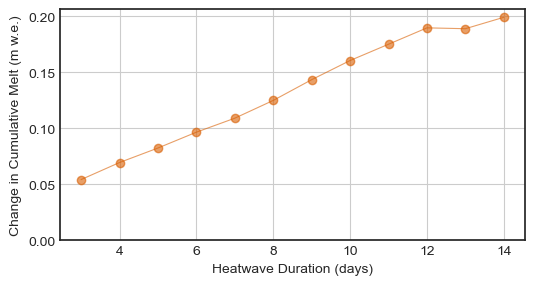

In [80]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import matplotlib.dates as mpl_dates

def calculate_cumulative_melt(ds, ds2, startdate, variable='melt', min_duration=3, max_duration=14):
    cumulative_melt_changes = []

    for duration in range(min_duration, max_duration + 1):
        enddate = np.datetime64(startdate) + np.timedelta64(duration, 'D')
        
        # Filter the datasets based on the duration
        ds_filtered = ds.sel(time=slice(startdate, enddate))
        ds2_filtered = ds2.sel(time=slice(startdate, enddate))
        
        # Calculate the cumulative melt
        var_ds = ds_filtered[variable].cumsum(dim='time')
        var_ds2 = ds2_filtered[variable].cumsum(dim='time')
        
        # Calculate the difference in cumulative melt
        cumulative_melt_diff = (var_ds - var_ds2).isel(time=-1).values  # Difference at the end of the duration
        cumulative_melt_changes.append(cumulative_melt_diff)
    
    return cumulative_melt_changes

def plot_cumulative_melt_changes(cumulative_melt_changes, min_duration=3, max_duration=14):
    durations = list(range(min_duration, max_duration + 1))
    
    fig, ax = plt.subplots(figsize=(6, 3))
    c = plt.cm.Dark2(1)
    
    ax.plot(durations, cumulative_melt_changes, label='Cumulative Melt Change', color=c, alpha=0.6, linewidth=0.8, marker='o')
    ax.set_xlabel('Heatwave Duration (days)')
    ax.set_ylabel('Change in Cumulative Melt (m w.e.)')
        
    ax.set_ylim(bottom=0)

    ax.grid(True)
    
    ax.set_title('')

    plt.show()

# Example usage
startdate = '2004-06-16'  # Example start date
cumulative_melt_changes = calculate_cumulative_melt(ds, ds2, startdate)
plot_cumulative_melt_changes(cumulative_melt_changes)


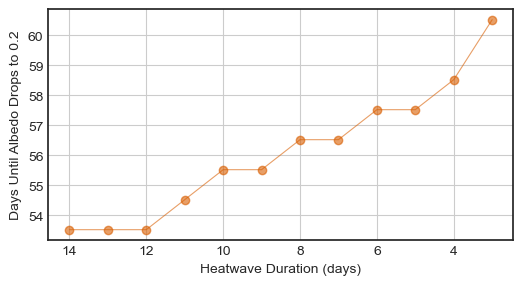

In [79]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr

def calculate_days_until_albedo_drop(ds_list, heatwave_start, variable='albedo', threshold=0.2):
    days_until_albedo_drop = []

    heatwave_start = np.datetime64(heatwave_start)
    
    for ds in ds_list:
        # Find the time when albedo drops to or below the threshold
        albedo_drop_time = ds[variable].where(ds[variable] <= threshold, drop=True).time
        
        if len(albedo_drop_time) > 0:
            # Calculate the number of days until the albedo drops
            days_until_drop = (albedo_drop_time[0] - heatwave_start) / np.timedelta64(1, 'D')
            days_until_albedo_drop.append(days_until_drop)
        else:
            # If albedo does not drop to the threshold, append NaN or a large value
            days_until_albedo_drop.append(np.nan)
    
    return days_until_albedo_drop

def plot_days_until_albedo_drop(days_until_albedo_drop, durations):
    fig, ax = plt.subplots(figsize=(6, 3))
    c = plt.cm.Dark2(1)
    
    ax.plot(durations, days_until_albedo_drop, label='Days Until Albedo Drops to 0.2', color=c, alpha=0.6, linewidth=0.8, marker='o')
    
    ax.set_xlabel('Heatwave Duration (days)')
    ax.set_ylabel('Days Until Albedo Drops to 0.2')
    ax.invert_xaxis()
    ax.grid(True)
    ax.set_title('')
    
    plt.show()

# Example usage
heatwave_start = '2004-06-01'  # Heatwave start date
ds_list = [ds6, ds7, ds8, ds9, ds10, ds11, ds12, ds13, ds14, ds15, ds16, ds17]
durations = [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]

days_until_albedo_drop = calculate_days_until_albedo_drop(ds_list, heatwave_start)
plot_days_until_albedo_drop(days_until_albedo_drop, durations)


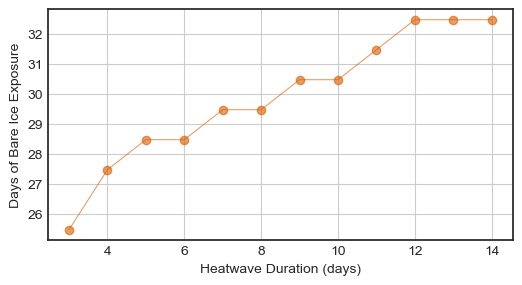

In [81]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr

def calculate_days_of_bare_ice_exposure(ds_list, heatwave_start, snowfall_event, variable='albedo', threshold=0.2):
    days_of_bare_ice_exposure = []

    heatwave_start = np.datetime64(heatwave_start)
    snowfall_event = np.datetime64(snowfall_event)
    
    for ds in ds_list:
        # Find the time when albedo drops to or below the threshold
        albedo_drop_time = ds[variable].where(ds[variable] <= threshold, drop=True).time
        
        if len(albedo_drop_time) > 0:
            # Calculate the number of days of bare ice exposure
            days_of_exposure = (snowfall_event - albedo_drop_time[0]) / np.timedelta64(1, 'D')
            days_of_bare_ice_exposure.append(days_of_exposure)
        else:
            # If albedo does not drop to the threshold, append NaN or a large value
            days_of_bare_ice_exposure.append(np.nan)
    
    return days_of_bare_ice_exposure

def plot_days_of_bare_ice_exposure(days_of_bare_ice_exposure, durations):
    fig, ax = plt.subplots(figsize=(6, 3))
    c = plt.cm.Dark2(1)
    
    ax.plot(durations, days_of_bare_ice_exposure, label='Days of Bare Ice Exposure', color=c, alpha=0.6, linewidth=0.8, marker='o')
    
    ax.set_xlabel('Heatwave Duration (days)')
    ax.set_ylabel('Days of Bare Ice Exposure')
    ax.grid(True)
    ax.set_title('')
    
    plt.show()

# Example usage
heatwave_start = '2004-06-01'  # Heatwave start date
snowfall_event = '2004-08-26'  # Snowfall event date in late August
ds_list = [ds6, ds7, ds8, ds9, ds10, ds11, ds12, ds13, ds14, ds15, ds16, ds17]
durations = [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]

days_of_bare_ice_exposure = calculate_days_of_bare_ice_exposure(ds_list, heatwave_start, snowfall_event)
plot_days_of_bare_ice_exposure(days_of_bare_ice_exposure, durations)


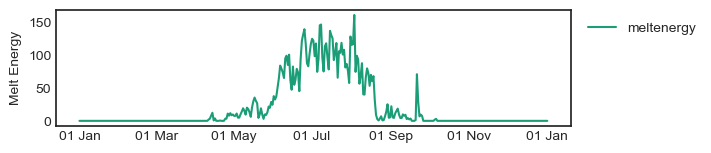

In [29]:
id = '12'
ds3, startdate, enddate = getds(data_fp.replace('#',id))

simple_plot(ds3,0,[pd.to_datetime('2000-01-01 00:30'),pd.to_datetime('2001-01-01 00:30')],[['meltenergy']])


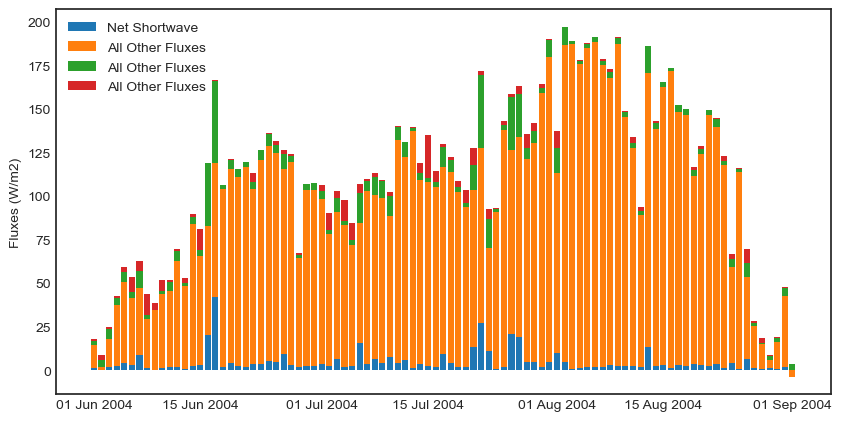

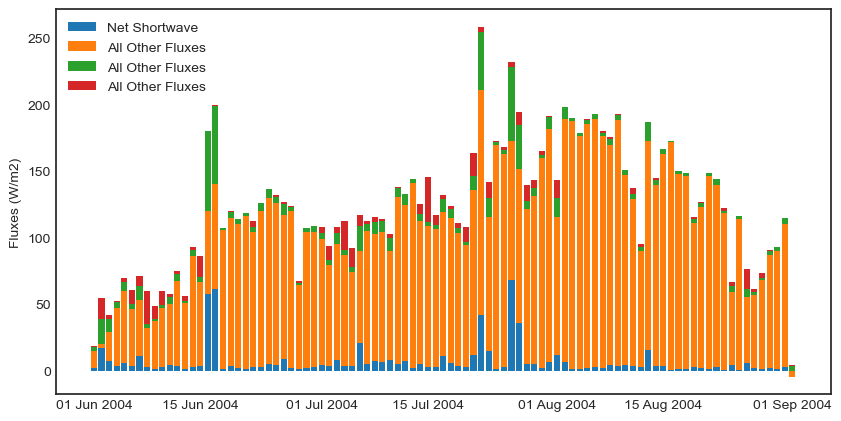

In [105]:
stacked_eb_barplot(ds,[startdate,enddate],'d','',False)
stacked_eb_barplot(ds2,[startdate,enddate],'d','',False)

In [55]:
lat = 63.5
lon = 143.625
summer_months = [6, 7, 8]
month_names = ['June', 'July', 'August']

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
ds = xr.open_dataset(file_path)

ds_subset = ds.sel(lat=lat, lon=lon, method='nearest')

time_index = pd.to_datetime(ds_subset.indexes['time'])

is_summer = np.isin(time_index.month, summer_months)
ds_summer = ds_subset.isel(time=is_summer)

output_file_path = '/Users/manda/REU24/Output/MERRA2_processing/subset_summer.nc'
ds_summer.to_netcdf(output_file_path)

print(f"Subsetted data saved to {output_file_path}")


Subsetted data saved to /Users/manda/REU24/Output/MERRA2_processing/subset_summer.nc


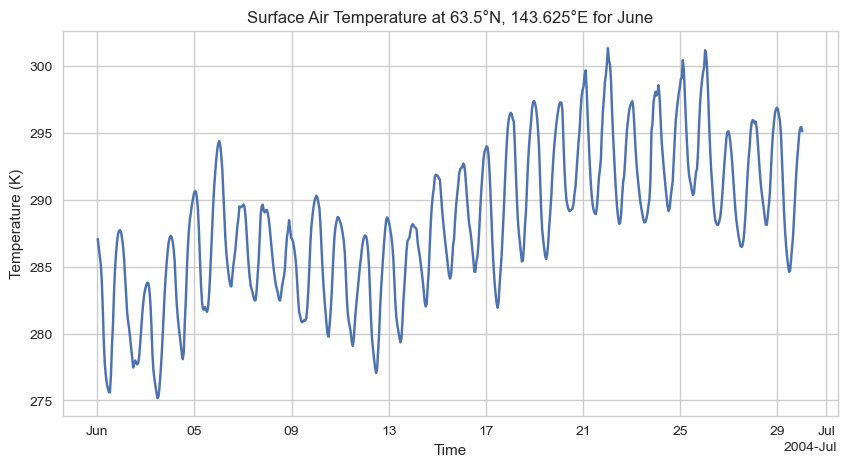

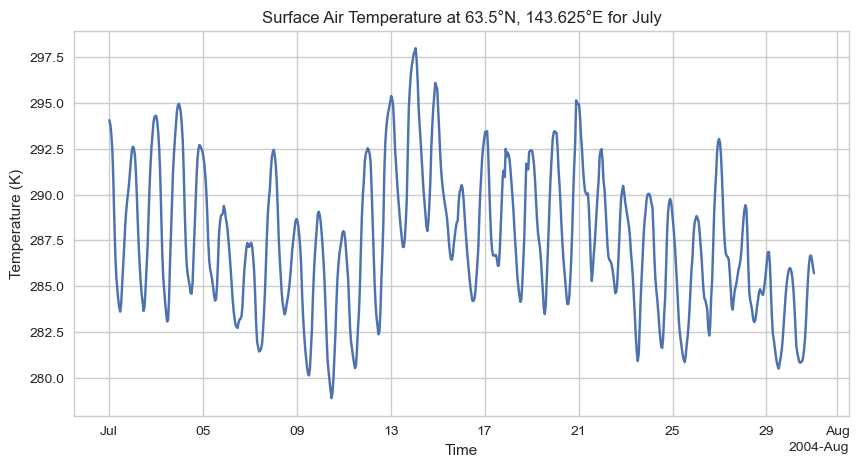

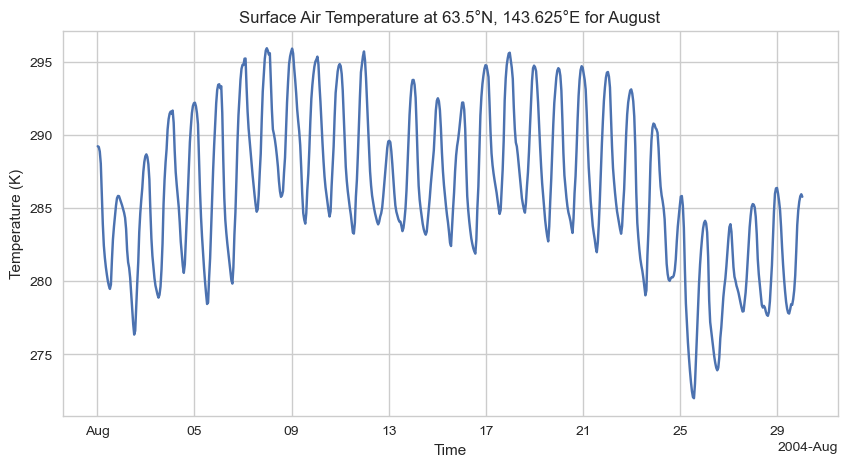

In [40]:
June_startdate = '2004-06-01 00:30:00'
June_enddate = '2004-06-30 00:30:00'
July_startdate = '2004-07-01 00:30:00'
July_enddate = '2004-07-31 00:30:00'
August_startdate = '2004-08-01 00:30:00'
August_enddate = '2004-08-30 00:30:00'
for month, month_name in zip(summer_months, month_names):
    start_date = globals()[f"{month_name}_startdate"]
    end_date = globals()[f"{month_name}_enddate"]
    ds_month = ds_subset.sel(time=slice(start_date, end_date))
    
    plt.figure(figsize=(10, 5))
    ds_month['T2M'].plot()
    plt.title(f'Surface Air Temperature at {lat}°N, {lon}°E for {month_name}')
    plt.xlabel('Time')
    plt.ylabel('Temperature (K)')
    plt.grid(True)
    plt.show()

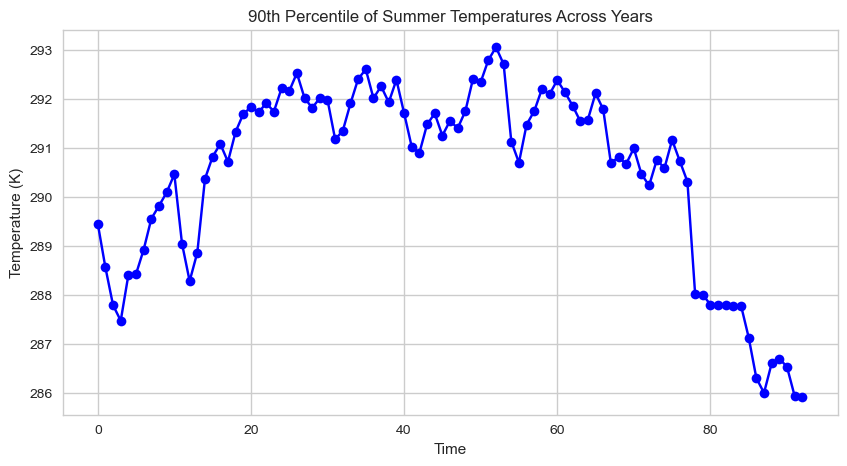

In [103]:
ds_summers = ds.sel(lat=lat, lon=lon, method='nearest').sel(time=ds['time.month'].isin(summer_months))

percentile_90 = ds_summers['T2M'].groupby('time.dayofyear').reduce(np.nanpercentile, q=90, dim='time')

df_percentile_90 = pd.DataFrame({
    'Date': pd.date_range(start='2000-01-01', periods=365)[percentile_90['dayofyear'] - 1],
    '90thPercentileTemperature': percentile_90.values
})

df_percentile_90['Date'] = df_percentile_90['Date'].dt.strftime('%Y-%m-%d %H:%M:%S')

output_csv_path = '/Users/manda/REU24/Output/MERRA2_processing/90th_percentile_temperatures.csv'
df_percentile_90.to_csv(output_csv_path, index=False)

plt.figure(figsize=(10, 5))
df_percentile_90['90thPercentileTemperature'].plot(marker='o', linestyle='-', color='b')
plt.title('90th Percentile of Summer Temperatures Across Years')
plt.xlabel('Time')
plt.ylabel('Temperature (K)')
plt.grid(True)
plt.show()

In [ ]:
time_index = pd.to_datetime(ds_summer.indexes['time'])

is_2004_summer = (time_index.year == 2004) & (time_index.month.isin(summer_months))
ds_2004_summer = ds_summer.isel(time=is_2004_summer)

plt.figure(figsize=(15, 7))

for month, month_name in zip(summer_months, month_names):
    is_month = time_index[is_2004_summer].month == month
    ds_month = ds_2004_summer.isel(time=is_month)
    plt.plot(ds_month['time'], ds_month['T2M'], label=f'{month_name} 2004')

df_percentile_90['Date'] = pd.to_datetime(df_percentile_90['Date'])
df_percentile_90['Date'] = df_percentile_90['Date'].apply(lambda x: x.replace(year=2004))
plt.plot(df_percentile_90['Date'], df_percentile_90['90thPercentileTemperature'], marker='o', linestyle='-', color='r', label='90th Percentile')

plt.legend()
plt.title('Surface Air Temperature at 63.5°N, 143.625°E for Summer Months (2004) and 90th Percentile')
plt.xlabel('Day of the Year')
plt.ylabel('Temperature (K)')
plt.grid(True)
plt.show()


In [ ]:
for year in range(2000, 2024):
    is_year_summer = (time_index.year == year) & (time_index.month.isin(summer_months))
    ds_year_summer = ds_summer.isel(time=is_year_summer)

    plt.figure(figsize=(15, 7))

    for month, month_name in zip(summer_months, month_names):
        is_month = time_index[is_year_summer].month == month
        ds_month = ds_year_summer.isel(time=is_month)
        plt.plot(ds_month['time'], ds_month['T2M'], label=f'{month_name} {year}')

    df_percentile_90_copy = df_percentile_90.copy()
    df_percentile_90_copy['Date'] = df_percentile_90_copy['Date'].apply(lambda x: x.replace(year=year))
    plt.plot(df_percentile_90_copy['Date'], df_percentile_90_copy['90thPercentileTemperature'], marker='o', linestyle='-', color='r', label='90th Percentile')

    plt.legend()
    plt.title(f'Surface Air Temperature at 63.5°N, 143.625°E for Summer Months ({year}) and 90th Percentile')
    plt.xlabel('Date')
    plt.ylabel('Temperature (K)')
    plt.grid(True)
    plt.show()

# CORRECTED FOR DAILY MAX TEMPS

In [58]:
lat = 63.5
lon = 143.625
summer_months = [6, 7, 8]
month_names = ['June', 'July', 'August']

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
output_file_path = '/Users/manda/REU24/Output/MERRA2_processing/daily_max_temps.nc'

ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable (assuming it's named 'T2M' in the dataset)
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Resample to daily frequency and take the maximum temperature for each day
daily_max_temps = t2m_point.resample(time='D').max()

daily_max_temps.to_netcdf(output_file_path)



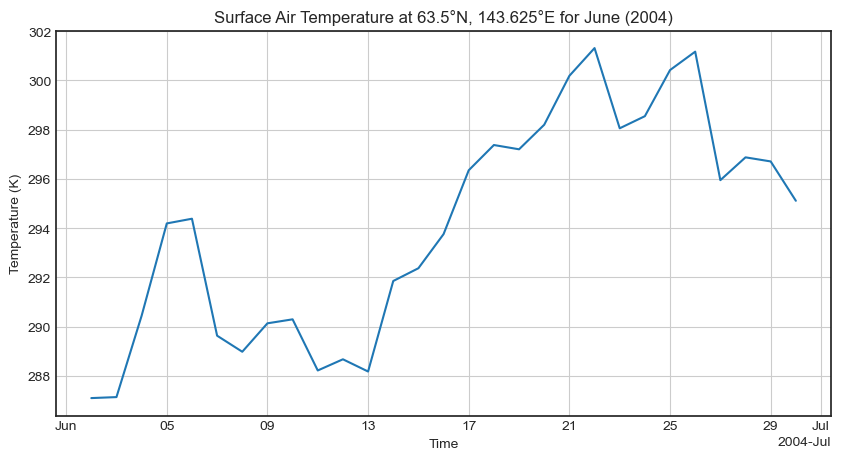

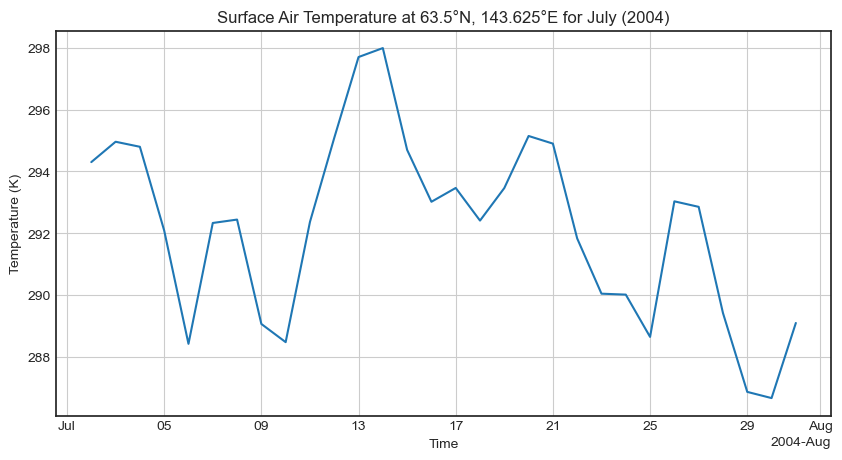

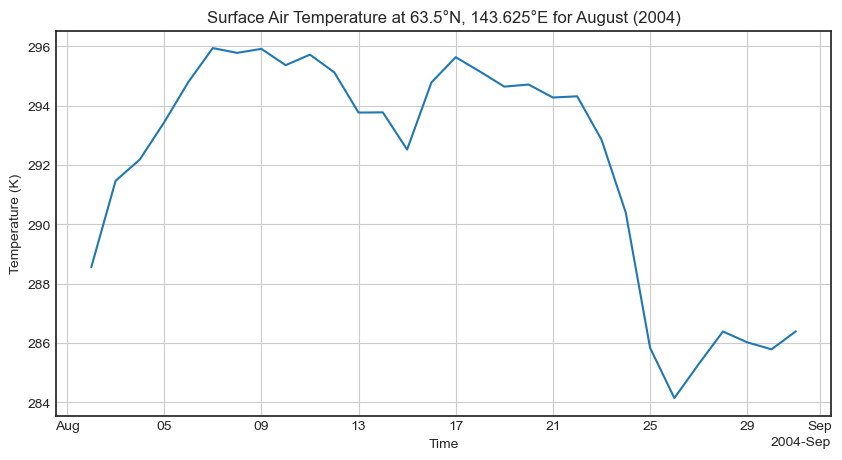

In [54]:
date_ranges = {
    'June': ('2004-06-01 00:30:00', '2004-06-30 00:30:00'),
    'July': ('2004-07-01 00:30:00', '2004-07-31 00:30:00'),
    'August': ('2004-08-01 00:30:00', '2004-08-31 00:30:00')
}

# Plot data for each summer month
for month_name in month_names:
    start_date, end_date = date_ranges[month_name]
    ds_month = daily_max_temps.sel(time=slice(start_date, end_date))
    
    plt.figure(figsize=(10, 5))
    ds_month.plot()
    plt.title(f'Surface Air Temperature at {lat}°N, {lon}°E for {month_name} (2004)')
    plt.xlabel('Time')
    plt.ylabel('Temperature (K)')
    plt.grid(True)
    plt.show()

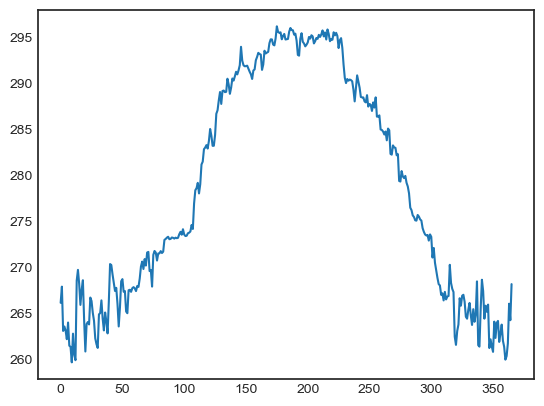

In [60]:
output_file_path = '/Users/manda/REU24/Output/MERRA2_processing/daily_max_temps_90th_percentile.nc'
percentile_90 = daily_max_temps.groupby('time.dayofyear').reduce(
    np.percentile, q=90)
percentile_90.to_netcdf(output_file_path)
plt.plot(percentile_90)


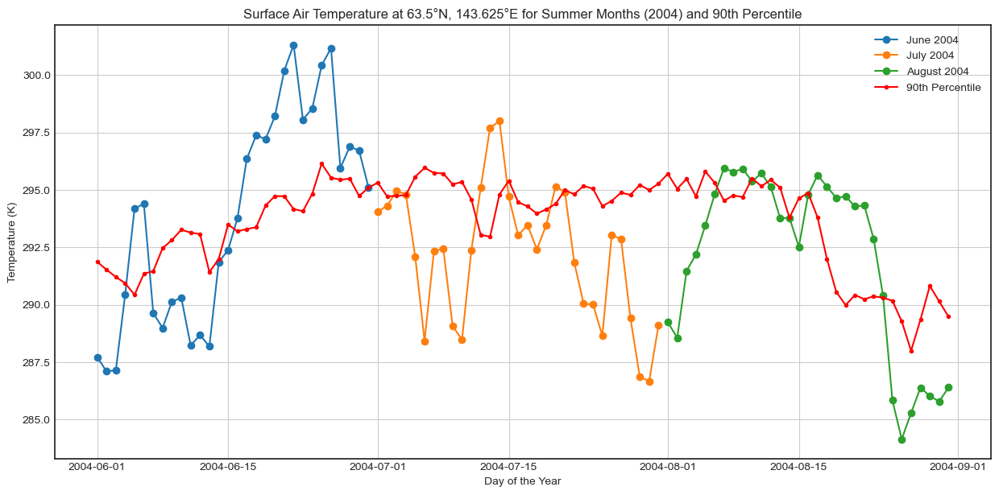

In [90]:
time_index = pd.to_datetime(daily_max_temps['time'].values)
is_2004_summer = (time_index.year == 2004) & (time_index.month.isin(summer_months))
ds_2004_summer = daily_max_temps.isel(time=is_2004_summer)

df_percentile_90 = percentile_90.to_dataframe(name='90thPercentileTemperature').reset_index()
df_percentile_90['Date'] = pd.to_datetime(df_percentile_90['dayofyear'], format='%j')
df_percentile_90['Date'] = df_percentile_90['Date'].apply(lambda x: x.replace(year=2004))
df_percentile_90 = df_percentile_90[df_percentile_90['Date'].dt.month.isin(summer_months)]

plt.figure(figsize=(15, 7))

for month, month_name in zip(summer_months, month_names):
    is_month = time_index[is_2004_summer].month == month
    ds_month = ds_2004_summer.isel(time=is_month)
    plt.plot(ds_month['time'], ds_month, marker='o', label=f'{month_name} 2004')

plt.plot(df_percentile_90['Date'], df_percentile_90['90thPercentileTemperature'], marker='.', linestyle='-', color='r', label='90th Percentile')

plt.legend()
plt.title('Surface Air Temperature at 63.5°N, 143.625°E for Summer Months (2004) and 90th Percentile')
plt.xlabel('Day of the Year')
plt.ylabel('Temperature (K)')
plt.grid(True)
plt.show()


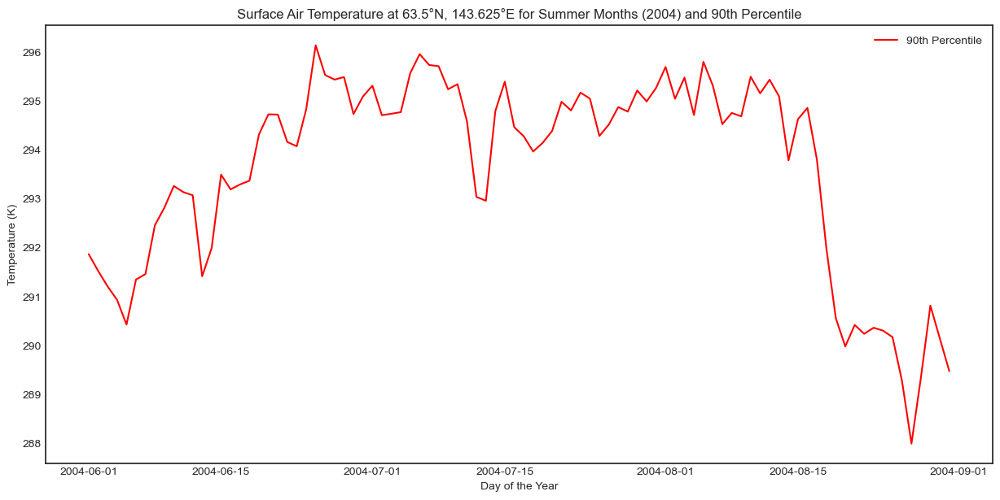

In [62]:
time_index = pd.to_datetime(daily_max_temps['time'].values)
is_2004_summer = (time_index.year == 2004) & (time_index.month.isin(summer_months))
ds_2004_summer = daily_max_temps.isel(time=is_2004_summer)

df_percentile_90 = percentile_90.to_dataframe(name='90thPercentileTemperature').reset_index()
df_percentile_90['Date'] = pd.to_datetime(df_percentile_90['dayofyear'], format='%j')
df_percentile_90['Date'] = df_percentile_90['Date'].apply(lambda x: x.replace(year=2004))
df_percentile_90 = df_percentile_90[df_percentile_90['Date'].dt.month.isin(summer_months)]

plt.figure(figsize=(15, 7))

plt.plot(df_percentile_90['Date'], df_percentile_90['90thPercentileTemperature'], linestyle='-', color='r', label='90th Percentile')

plt.legend()
plt.title('Surface Air Temperature at 63.5°N, 143.625°E for Summer Months (2004) and 90th Percentile')
plt.xlabel('Day of the Year')
plt.ylabel('Temperature (K)')
plt.show()


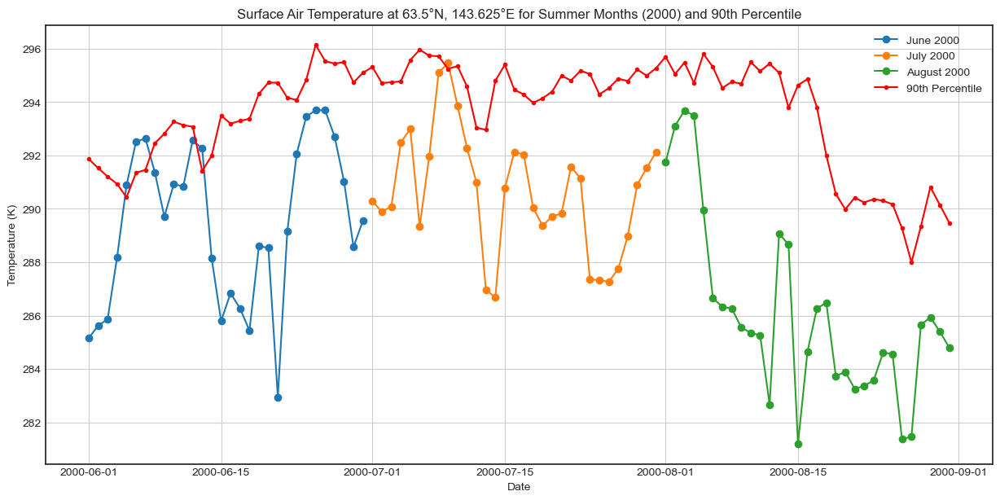

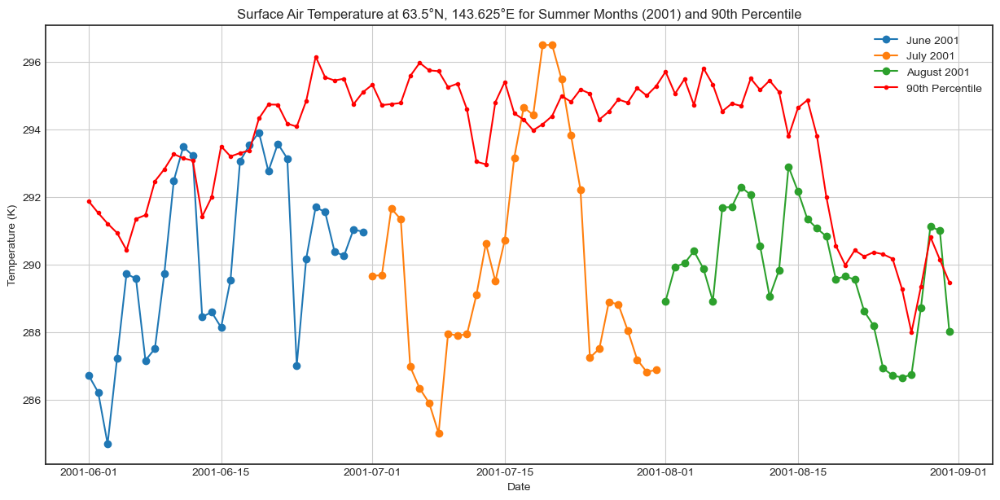

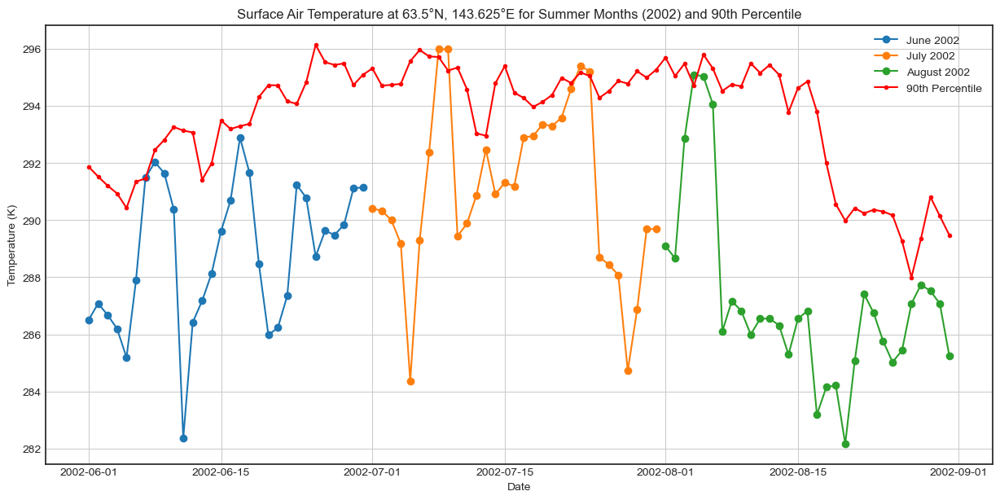

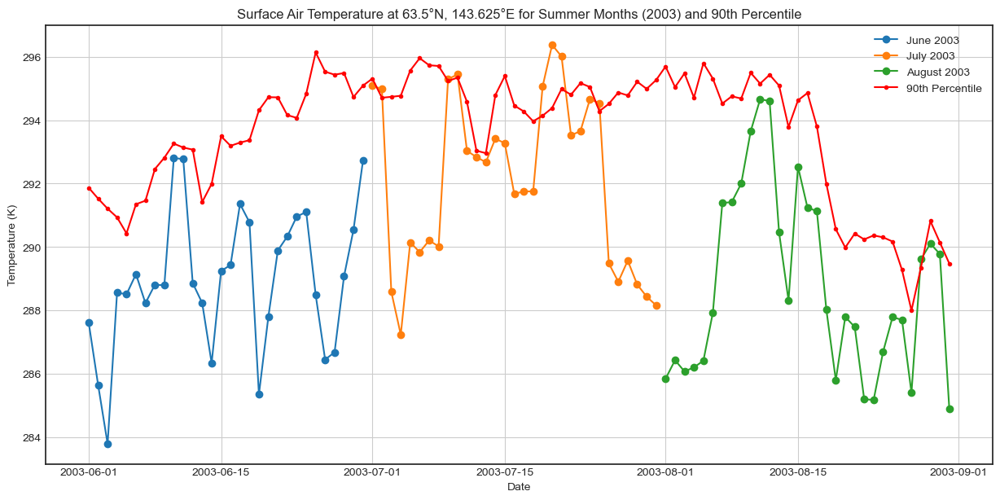

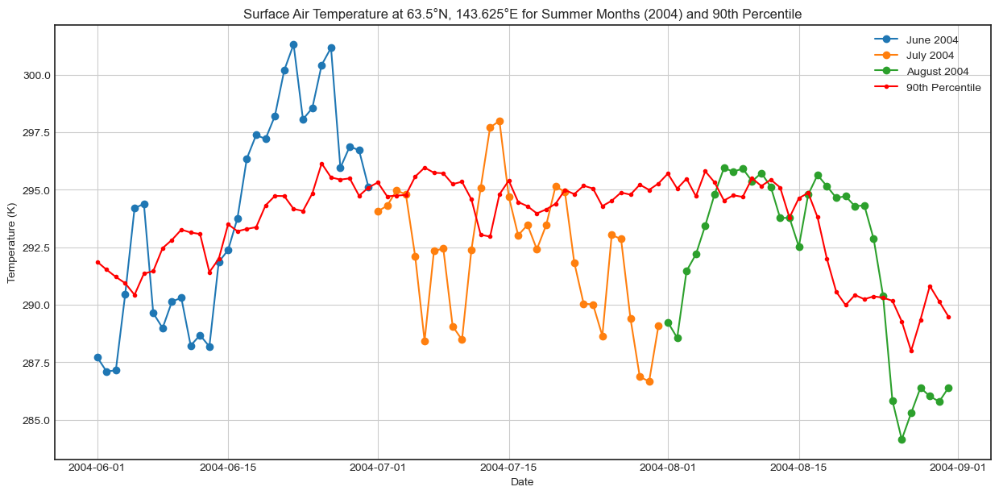

...

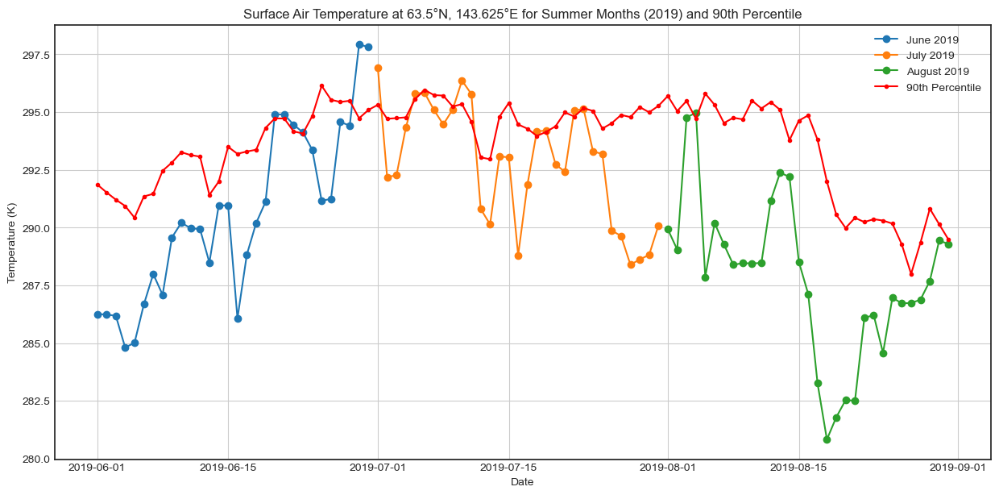

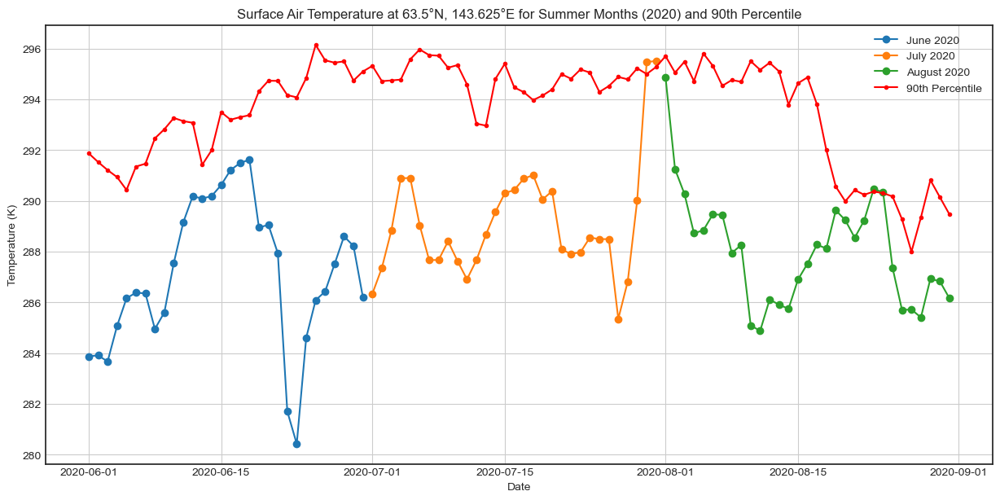

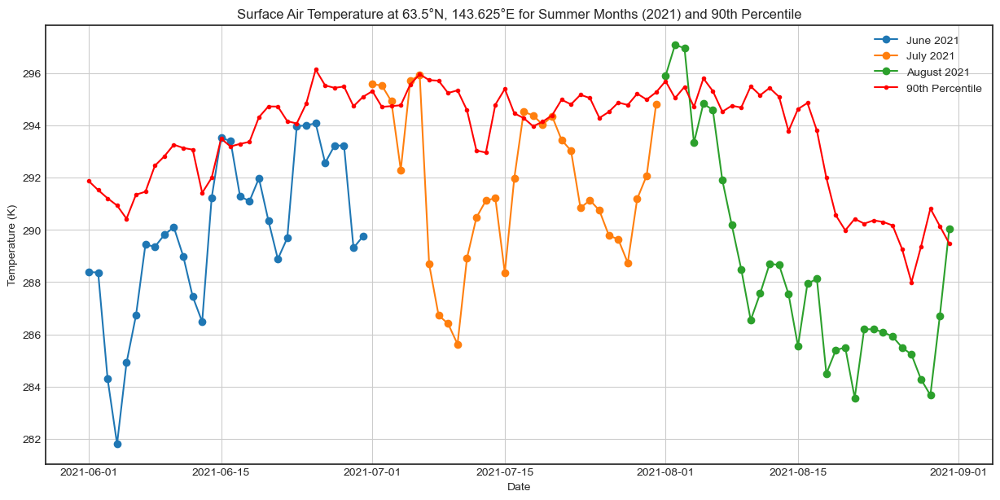

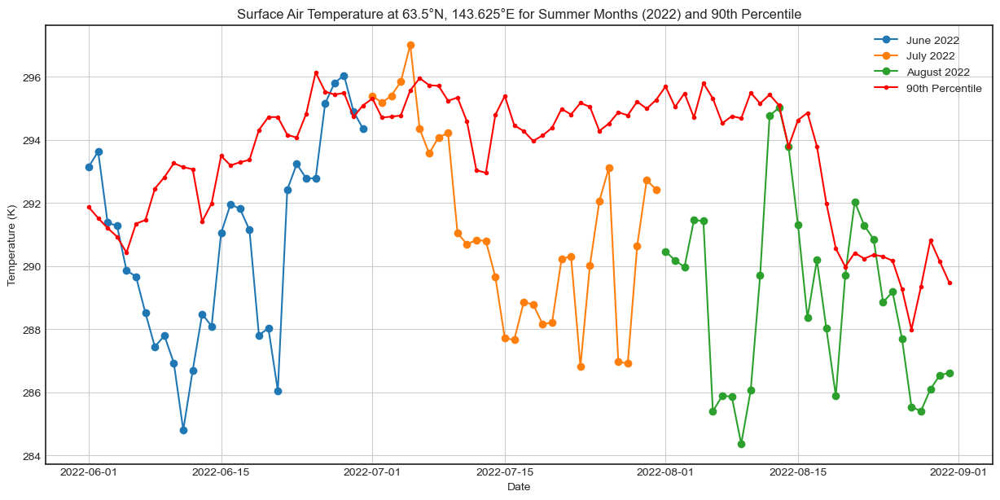

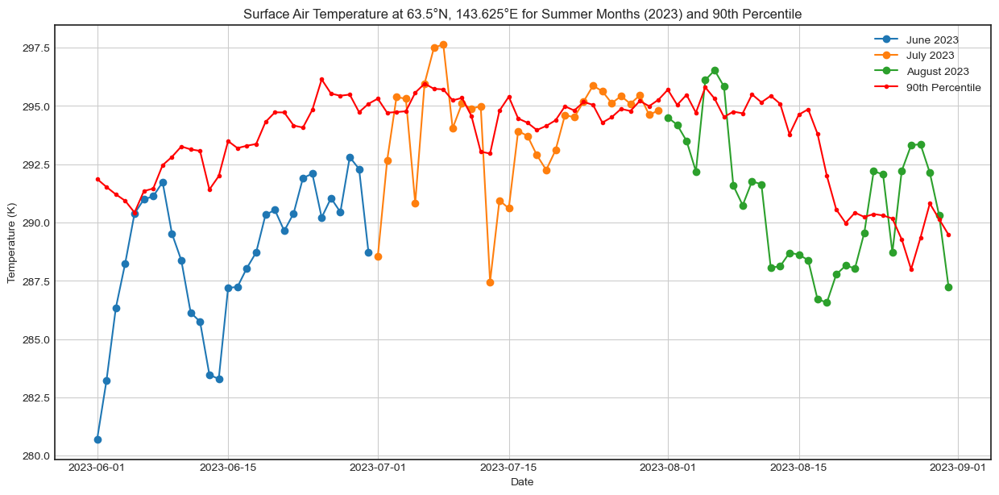

In [84]:
df_percentile_90 = percentile_90.to_dataframe(name='90thPercentileTemperature').reset_index()
df_percentile_90['Date'] = pd.to_datetime(df_percentile_90['dayofyear'], format='%j')
df_percentile_90['Date'] = df_percentile_90['Date'].apply(lambda x: x.replace(year=2000))

df_percentile_90 = df_percentile_90[df_percentile_90['Date'].dt.month.isin(summer_months)]

for year in range(2000, 2024):
    is_year_summer = (daily_max_temps['time.year'] == year) & (daily_max_temps['time.month'].isin(summer_months))
    ds_year_summer = daily_max_temps.sel(time=is_year_summer)

    plt.figure(figsize=(15, 7))

    for month, month_name in zip(summer_months, month_names):
        is_month = ds_year_summer['time.month'] == month
        ds_month = ds_year_summer.sel(time=is_month)
        plt.plot(ds_month['time'], ds_month, marker='o', label=f'{month_name} {year}')

    df_percentile_90_copy = df_percentile_90.copy()
    df_percentile_90_copy['Date'] = df_percentile_90_copy['Date'].apply(lambda x: x.replace(year=year))
    plt.plot(df_percentile_90_copy['Date'], df_percentile_90_copy['90thPercentileTemperature'], marker='.', linestyle='-', color='r', label='90th Percentile')

    plt.legend()
    plt.title(f'Surface Air Temperature at 63.5°N, 143.625°E for Summer Months ({year}) and 90th Percentile')
    plt.xlabel('Date')
    plt.ylabel('Temperature (K)')
    plt.grid(True)
    plt.show()

In [117]:
def merge_overlapping_periods(periods):
    sorted_periods = sorted(periods)
    merged_periods = []

    for start, end in sorted_periods:
        if merged_periods and start <= merged_periods[-1][1]:  # Overlapping or consecutive
            merged_periods[-1] = (merged_periods[-1][0], max(end, merged_periods[-1][1]))
        else:
            merged_periods.append((start, end))

    return merged_periods

def find_periods_exceeding_threshold(daily_max_temps, percentile_data, summer_months, consecutive_days_threshold):
    periods_exceeding_mask = []

    is_summer = daily_max_temps['time.month'].isin(summer_months)
    ds_summer = daily_max_temps.sel(time=is_summer)

    years = range(2000, 2024)
    df_percentile_copy = percentile_data.copy()
    df_percentile_copy['Date'] = pd.to_datetime(df_percentile_copy['dayofyear'], format='%j')

    for year in years:
        df_percentile_copy_year = df_percentile_copy.copy()
        df_percentile_copy_year['Date'] = df_percentile_copy_year['Date'].apply(lambda x: x.replace(year=year))

        percentile_mask = df_percentile_copy_year['90thPercentileTemperature'].values

        temperatures = ds_summer.values

        exceed_count = 0
        exceed_start = None
        exceed_end = None

        for i in range(len(temperatures)):
            if temperatures[i] > percentile_mask[i%92]:
                if exceed_count == 0:
                    exceed_start = ds_summer['time'][i].values
                exceed_count += 1
            else:
                if exceed_count >= consecutive_days_threshold:
                    exceed_end = ds_summer['time'][i-1].values
                    periods_exceeding_mask.append((exceed_start, exceed_end))
                exceed_count = 0

        if exceed_count >= consecutive_days_threshold:
            exceed_end = ds_summer['time'][-1].values
            periods_exceeding_mask.append((exceed_start, exceed_end))

    periods_exceeding_mask = merge_overlapping_periods(periods_exceeding_mask)

    return periods_exceeding_mask

# Example usage:
# Assuming daily_max_temps and df_percentile_90_copy are defined elsewhere in your code

summer_months = [6, 7, 8]  # June, July, August
consecutive_days_threshold = 6

periods_exceeding_threshold = find_periods_exceeding_threshold(daily_max_temps, df_percentile_90_copy, summer_months, consecutive_days_threshold)

for start, end in periods_exceeding_threshold:
    print(f"Period exceeding {consecutive_days_threshold} consecutive days above 90th percentile: {start} to {end}")


Period exceeding 6 consecutive days above 90th percentile: 2004-06-16T00:00:00.000000000 to 2004-06-30T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2004-08-17T00:00:00.000000000 to 2004-08-24T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2005-06-09T00:00:00.000000000 to 2005-06-14T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2005-08-10T00:00:00.000000000 to 2005-08-16T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2006-06-10T00:00:00.000000000 to 2006-06-15T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2007-08-26T00:00:00.000000000 to 2007-08-31T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2023-07-23T00:00:00.000000000 to 2023-07-29T00:00:00.000000000


In [137]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

#Isolating the Max Daily Temperatures

lat = 63.5
lon = 143.625
summer_months = [6, 7, 8]
month_names = ['June', 'July', 'August']

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
output_file_path_max = '/Users/manda/REU24/Output/MERRA2_processing/daily_max_temps.nc'

ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable (assuming it's named 'T2M' in the dataset)
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Resample to daily frequency and take the maximum temperature for each day
daily_max_temps = t2m_point.resample(time='D').max()

daily_max_temps.to_netcdf(output_file_path_max)

#Identify 90th Percentile

output_file_path_90 = '/Users/manda/REU24/Output/MERRA2_processing/daily_max_temps_90th_percentile.nc'
percentile_90 = daily_max_temps.groupby('time.dayofyear').reduce(np.percentile, q=90)

percentile_90.to_netcdf(output_file_path_90)

#Subset Data to Get Summer Months

time_index = pd.to_datetime(daily_max_temps['time'].values)
is_2004_summer = (time_index.year == 2004) & (time_index.month.isin(summer_months))
ds_2004_summer = daily_max_temps.isel(time=is_2004_summer)

df_percentile_90 = percentile_90.to_dataframe(name='90thPercentileTemperature').reset_index()
df_percentile_90['Date'] = pd.to_datetime(df_percentile_90['dayofyear'], format='%j')
df_percentile_90['Date'] = df_percentile_90['Date'].apply(lambda x: x.replace(year=2004))
df_percentile_90 = df_percentile_90[df_percentile_90['Date'].dt.month.isin(summer_months)]

df_percentile_90_copy = df_percentile_90.copy()

#Find Periods Exceeding 90th Percentile

def merge_overlapping_periods(periods):
    sorted_periods = sorted(periods)
    merged_periods = []

    for start, end in sorted_periods:
        if merged_periods and start <= merged_periods[-1][1]:  # Overlapping or consecutive
            merged_periods[-1] = (merged_periods[-1][0], max(end, merged_periods[-1][1]))
        else:
            merged_periods.append((start, end))

    return merged_periods

def find_periods_exceeding_threshold(daily_max_temps, percentile_data, summer_months, consecutive_days_threshold):
    periods_exceeding_mask = []

    is_summer = daily_max_temps['time.month'].isin(summer_months)
    ds_summer = daily_max_temps.sel(time=is_summer)

    years = range(2000, 2024)
    df_percentile_copy = percentile_data.copy()
    df_percentile_copy['Date'] = pd.to_datetime(df_percentile_copy['dayofyear'], format='%j')

    for year in years:
        df_percentile_copy_year = df_percentile_copy.copy()
        df_percentile_copy_year['Date'] = df_percentile_copy_year['Date'].apply(lambda x: x.replace(year=year))

        percentile_mask = df_percentile_copy_year['90thPercentileTemperature'].values

        temperatures = ds_summer.values

        exceed_count = 0
        exceed_start = None
        exceed_end = None

        for i in range(len(temperatures)):
            if temperatures[i] > percentile_mask[i%92]:
                if exceed_count == 0:
                    exceed_start = ds_summer['time'][i].values
                exceed_count += 1
            else:
                if exceed_count >= consecutive_days_threshold:
                    exceed_end = ds_summer['time'][i-1].values
                    periods_exceeding_mask.append((exceed_start, exceed_end))
                exceed_count = 0

        if exceed_count >= consecutive_days_threshold:
            exceed_end = ds_summer['time'][-1].values
            periods_exceeding_mask.append((exceed_start, exceed_end))

    periods_exceeding_mask = merge_overlapping_periods(periods_exceeding_mask)

    return periods_exceeding_mask

# Example usage:
# Assuming daily_max_temps and df_percentile_90_copy are defined elsewhere in your code

summer_months = [6, 7, 8]  # June, July, August
consecutive_days_threshold = 6

periods_exceeding_threshold = find_periods_exceeding_threshold(daily_max_temps, df_percentile_90_copy, summer_months, consecutive_days_threshold)

for start, end in periods_exceeding_threshold:
    print(f"Period exceeding {consecutive_days_threshold} consecutive days above 90th percentile: {start} to {end}")

Period exceeding 6 consecutive days above 90th percentile: 2004-06-16T00:00:00.000000000 to 2004-06-30T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2004-08-17T00:00:00.000000000 to 2004-08-24T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2005-06-09T00:00:00.000000000 to 2005-06-14T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2005-08-10T00:00:00.000000000 to 2005-08-16T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2006-06-10T00:00:00.000000000 to 2006-06-15T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2007-08-26T00:00:00.000000000 to 2007-08-31T00:00:00.000000000
Period exceeding 6 consecutive days above 90th percentile: 2023-07-23T00:00:00.000000000 to 2023-07-29T00:00:00.000000000


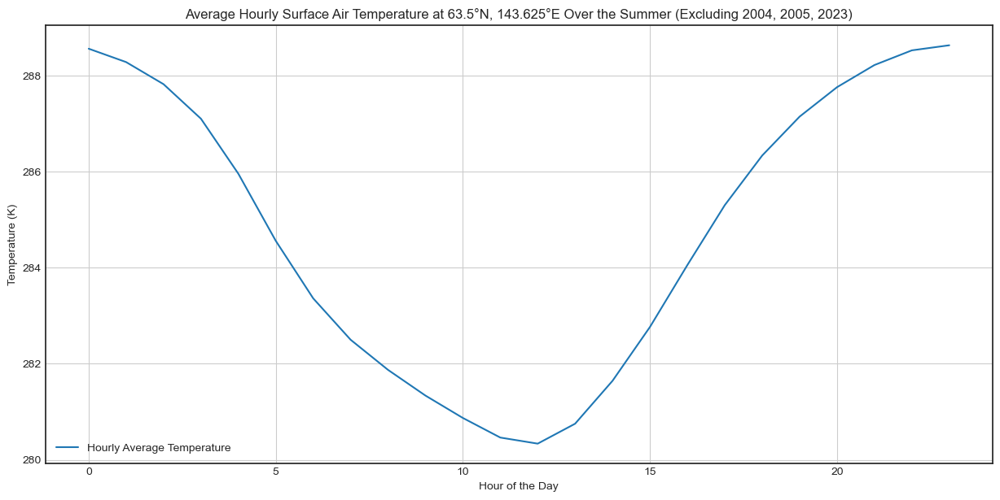

In [14]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = 143.625
summer_months = [6, 7, 8]
exclude_years = [2004, 2005, 2023]

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'

# Load the dataset
ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer = t2m_point['time.month'].isin(summer_months)
summer_t2m = t2m_point.sel(time=is_summer)

# Resample to hourly frequency and calculate the average temperature for each hour
hourly_avg_temps = summer_t2m.groupby(summer_t2m['time.hour']).mean(dim='time')

# Plot the average hourly temperature over the summer period
plt.figure(figsize=(15, 7))
hourly_avg_temps.plot(label='Hourly Average Temperature')
plt.title('Average Hourly Surface Air Temperature at 63.5°N, 143.625°E Over the Summer (Excluding 2004, 2005, 2023)')
plt.xlabel('Hour of the Day')
plt.ylabel('Temperature (K)')
plt.legend()
plt.grid(True)
plt.show()


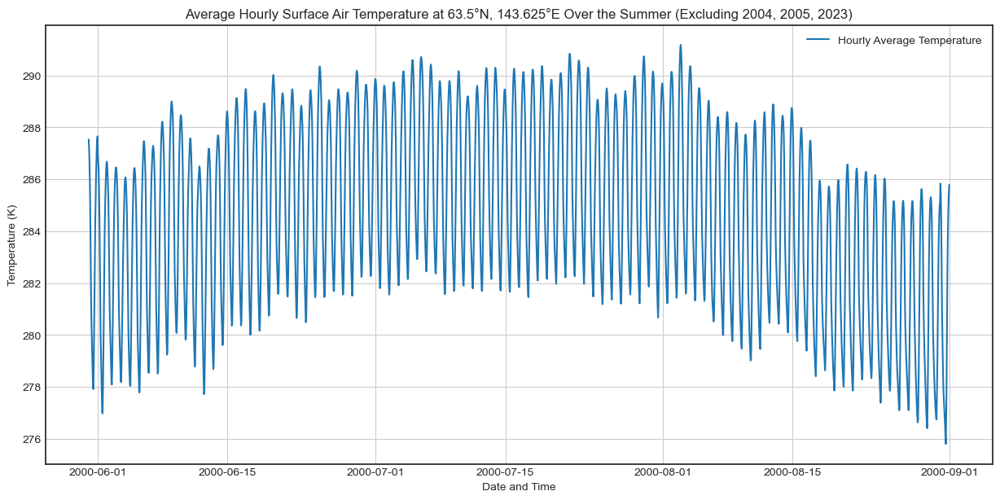

In [15]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = 143.625
summer_months = [6, 7, 8]
exclude_years = [2004, 2005, 2023]

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'

# Load the dataset
ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer = t2m_point['time.month'].isin(summer_months)
summer_t2m = t2m_point.sel(time=is_summer)

# Convert to DataFrame for easier handling
df_summer_t2m = summer_t2m.to_dataframe().reset_index()

# Calculate the average temperature for each hour of each day in the summer period
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

# Group by day of the year and hour to get the average temperature
hourly_avg_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].mean().reset_index()

# Convert back to datetime for plotting
# Assuming the year 2000 as a reference for creating datetime objects
hourly_avg_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_avg_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_avg_temps['hour'], unit='h')

# Plot the average hourly temperature over the summer period
plt.figure(figsize=(15, 7))
plt.plot(hourly_avg_temps['time'], hourly_avg_temps['T2M'], label='Hourly Average Temperature')
plt.title('Average Hourly Surface Air Temperature at 63.5°N, 143.625°E Over the Summer (Excluding 2004, 2005, 2023)')
plt.xlabel('Date and Time')
plt.ylabel('Temperature (K)')
plt.legend()
plt.grid(True)
plt.show()


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave.nc


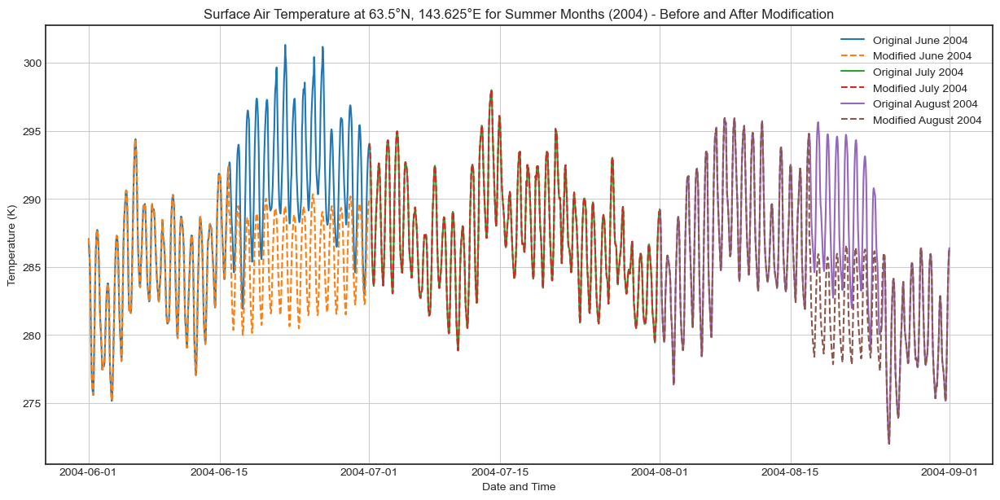

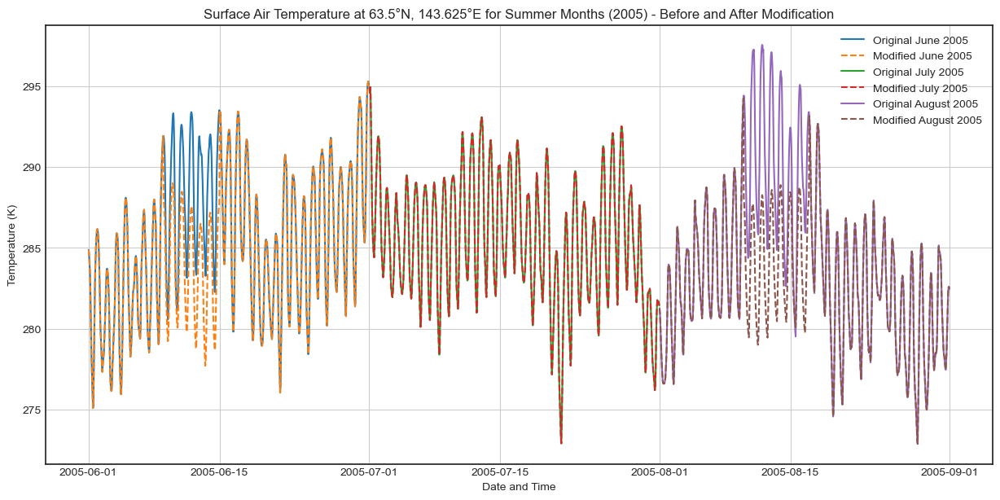

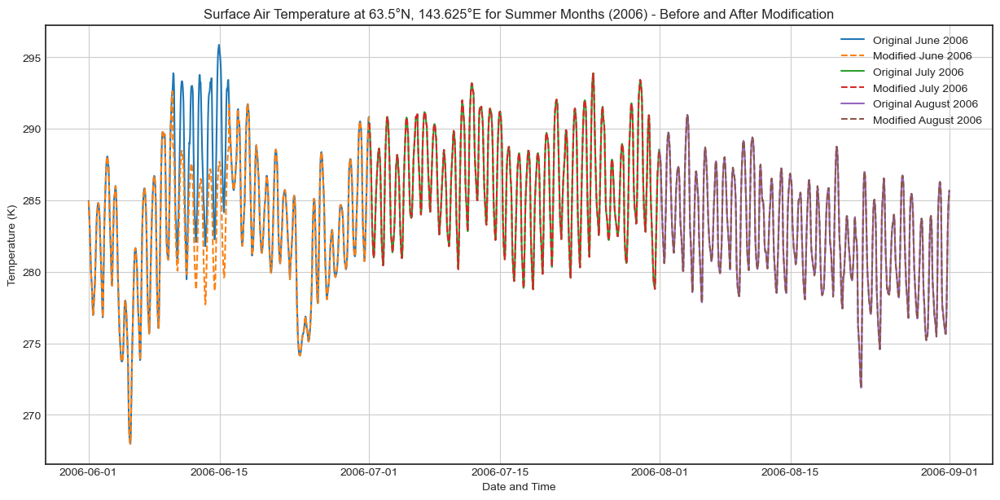

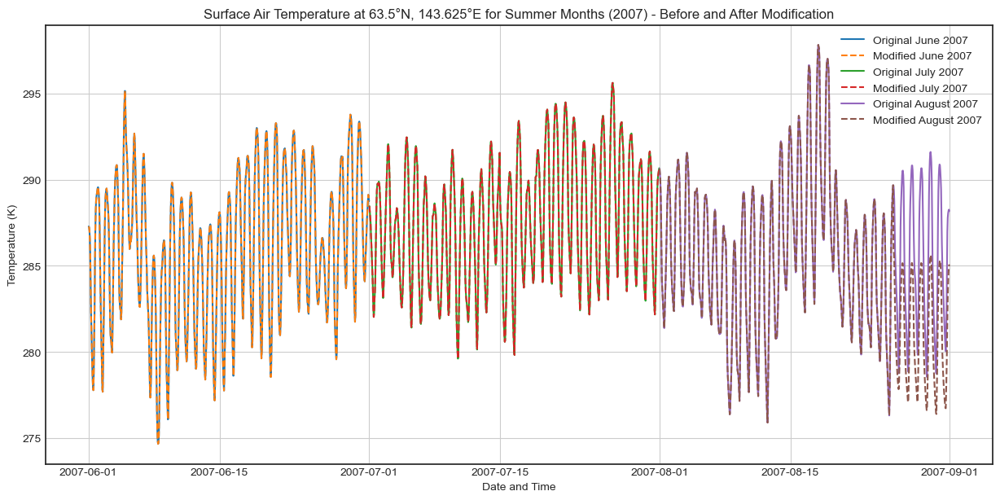

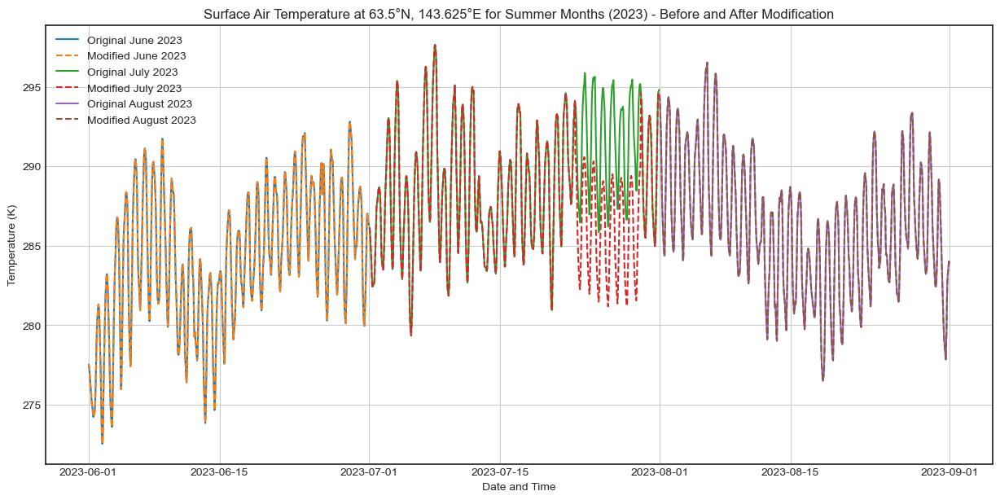

In [119]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = 143.625
summer_months = [6, 7, 8]
heatwave_periods = [
    ('2004-06-16', '2004-06-30'),
    ('2004-08-17', '2004-08-24'),
    ('2005-06-09', '2005-06-14'),
    ('2005-08-10', '2005-08-16'),
    ('2006-06-10', '2006-06-15'),
    ('2007-08-26', '2007-08-31'),
    ('2023-07-23', '2023-07-29')
]

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave.nc'

# Load the dataset
ds_notsubset = xr.open_dataset(file_path)

if 'units' not in ds_notsubset['T2M'].attrs:
    ds_notsubset['T2M'].attrs['units'] = 'K'

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years
is_not_heatwave_year = ~t2m_point['time.year'].isin([2004, 2005, 2023])
t2m_point_non_heatwave = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer = t2m_point_non_heatwave['time.month'].isin(summer_months)
summer_t2m = t2m_point_non_heatwave.sel(time=is_summer)

# Calculate the average temperature profile for each hour of each day in the summer period
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

# Group by day of the year and hour to get the average temperature
hourly_avg_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].mean().reset_index()

# Create a new DataFrame to hold the modified data
df_t2m_point = t2m_point.to_dataframe().reset_index()

# Replace heatwave days with the average temperature profile
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            avg_temp = hourly_avg_temps[(hourly_avg_temps['day_of_year'] == day_of_year) & (hourly_avg_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = avg_temp


# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

unique_lats = np.unique(ds_modified['lat'].values)
unique_lons = np.unique(ds_modified['lon'].values)

# Create new coordinate arrays
lat_dim = xr.DataArray(unique_lats, dims='lat', name='lat')
lon_dim = xr.DataArray(unique_lons, dims='lon', name='lon')

# Reshape the T2M variable
reshaped_T2M = ds_modified['T2M'].values.reshape(len(ds_modified['time']), len(unique_lats), len(unique_lons))

# Create a new dataset with the desired structure
ds_new_restructured = xr.Dataset(
    {
        'T2M': (['time', 'lat', 'lon'], reshaped_T2M)
    },
    coords={
        'time': ds_modified['time'],
        'lat': lat_dim,
        'lon': lon_dim
    }
)

ds_new_restructured['T2M'].attrs['units'] = 'K'

ds_new_restructured.to_netcdf(output_file_path)

print(f"Modified dataset saved to {output_file_path}")

modified_years = [2004, 2005, 2006, 2007, 2023]
for year in modified_years:
    is_year = t2m_point['time.year'] == year
    ds_year = t2m_point.sel(time=is_year)
    ds_modified_year = ds_modified.sel(time=is_year)

    plt.figure(figsize=(15, 7))

    for month, month_name in zip(summer_months, ['June', 'July', 'August']):
        is_month = ds_year['time.month'] == month
        ds_month = ds_year.sel(time=is_month)
        ds_modified_month = ds_modified_year.sel(time=is_month)

        plt.plot(ds_month['time'], ds_month, label=f'Original {month_name} {year}')
        plt.plot(ds_modified_month['time'], ds_modified_month['T2M'], linestyle='--', label=f'Modified {month_name} {year}')

    plt.title(f'Surface Air Temperature at 63.5°N, 143.625°E for Summer Months ({year}) - Before and After Modification')
    plt.xlabel('Date and Time')
    plt.ylabel('Temperature (K)')
    plt.legend()
    plt.grid(True)
    plt.show()


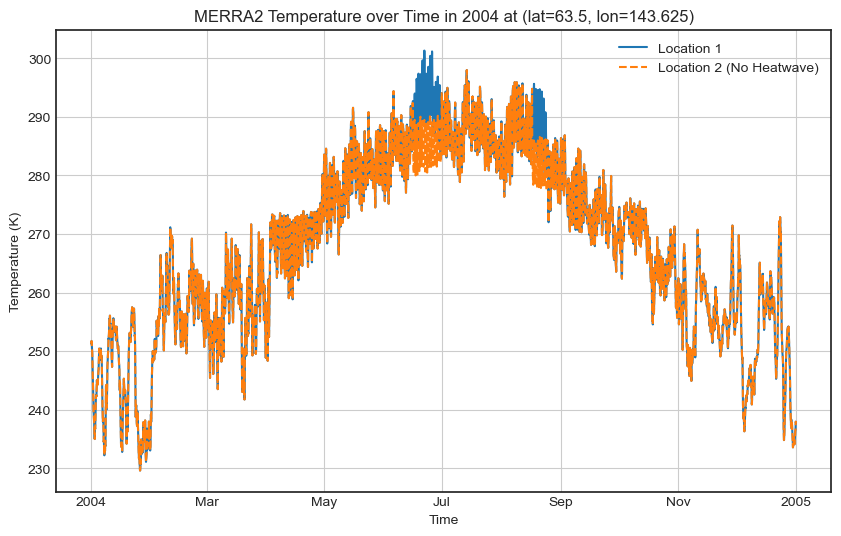

In [121]:
import matplotlib.pyplot as plt
import xarray as xr

# Define the file paths
file_path_1 = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
file_path_2 = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave.nc'

# Load the NetCDF files
dataset_1 = xr.open_dataset(file_path_1)
dataset_2 = xr.open_dataset(file_path_2)

temperature_1 = dataset_1['T2M']
temperature_2 = dataset_2['T2M']

temperature_at_location_1 = temperature_1.sel(lat=63.5, lon=143.625, method='nearest')
temperature_at_location_2 = temperature_2.sel(lat=63.5, lon=143.625, method='nearest')

temperature_at_location_1_2004 = temperature_at_location_1.sel(time=slice('2004-01-01', '2004-12-31'))
temperature_at_location_2_2004 = temperature_at_location_2.sel(time=slice('2004-01-01', '2004-12-31'))

# Plot the temperature data for the year 2004
plt.figure(figsize=(10, 6))
temperature_at_location_1_2004.plot(label='Location 1', linestyle='-')
temperature_at_location_2_2004.plot(label='Location 2 (No Heatwave)', linestyle='--')
plt.title('MERRA2 Temperature over Time in 2004 at (lat=63.5, lon=143.625)')
plt.xlabel('Time')
plt.ylabel('Temperature (K)')
plt.legend()
plt.grid(True)
plt.show()

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_SWGDN_no_heatwave.nc


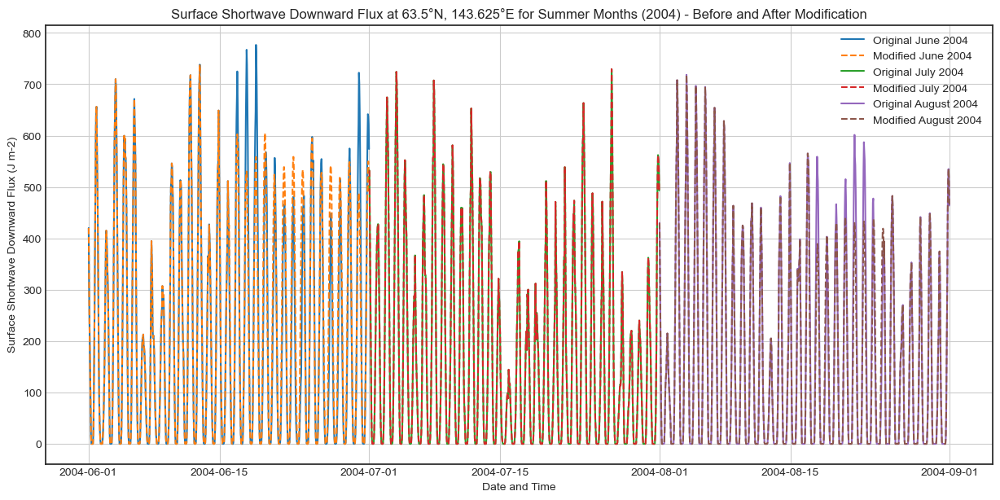

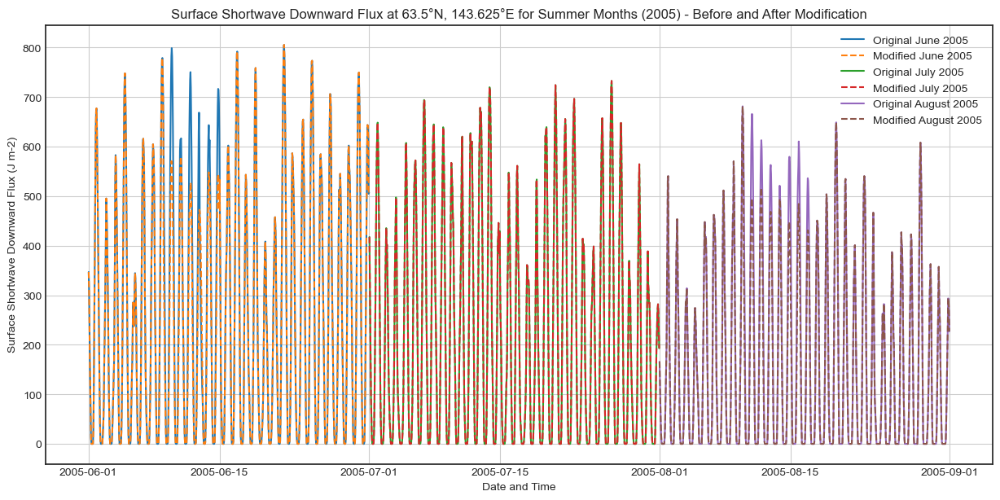

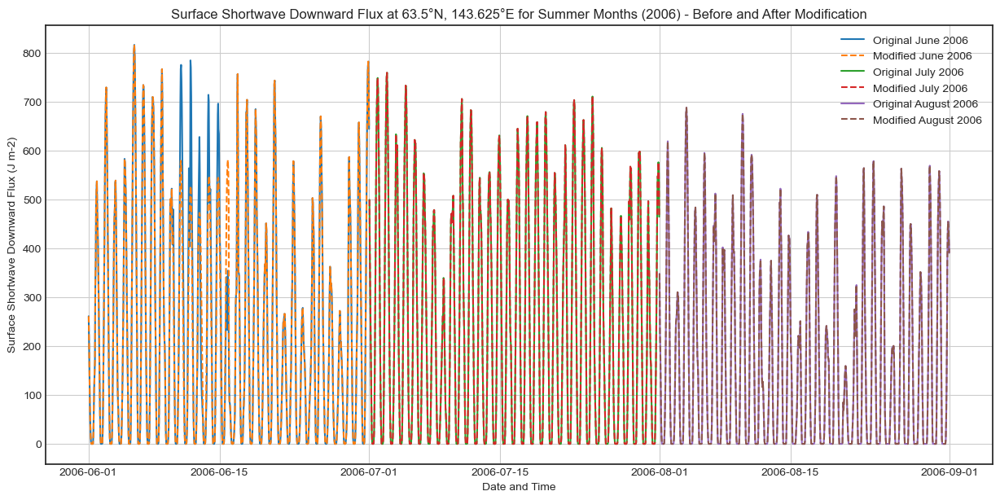

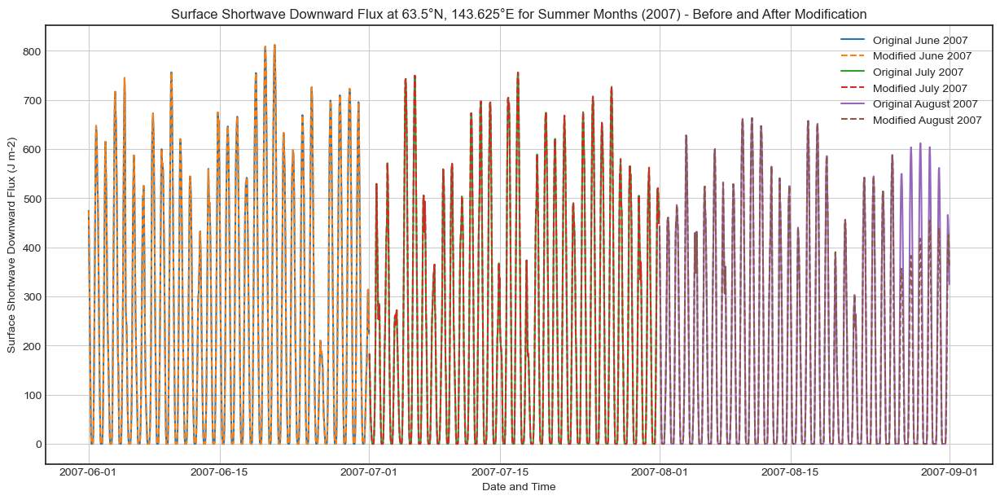

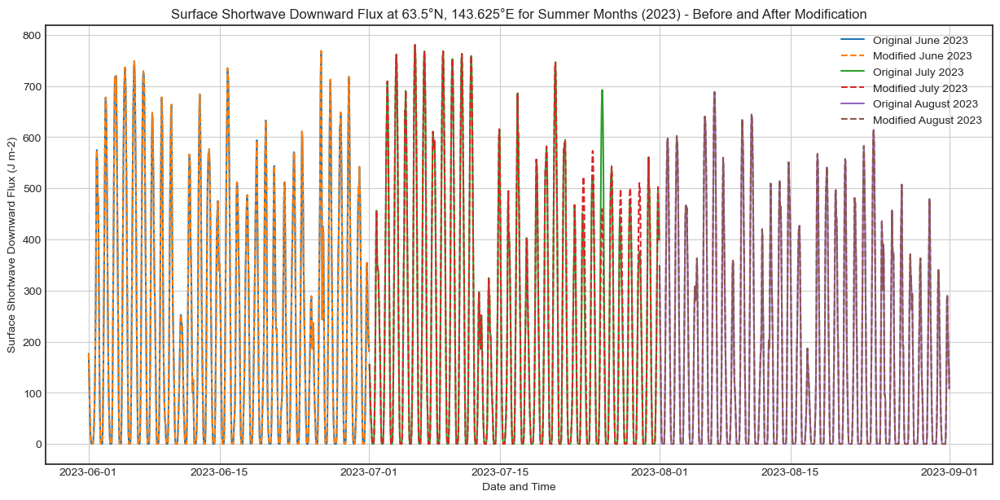

In [123]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = 143.625
summer_months = [6, 7, 8]
heatwave_periods = [
    ('2004-06-16', '2004-06-30'),
    ('2004-08-17', '2004-08-24'),
    ('2005-06-09', '2005-06-14'),
    ('2005-08-10', '2005-08-16'),
    ('2006-06-10', '2006-06-15'),
    ('2007-08-26', '2007-08-31'),
    ('2023-07-23', '2023-07-29')
]

file_path = '/Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_SWGDN_60_-150.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_SWGDN_no_heatwave.nc'

# Load the dataset
ds_notsubset = xr.open_dataset(file_path)

# Set units if they are missing
if 'units' not in ds_notsubset['SWGDN'].attrs:
    ds_notsubset['SWGDN'].attrs['units'] = 'J m-2'

# Select the SWGDN variable
swgdn = ds_notsubset['SWGDN']

# Select the nearest point to the given lat/lon
swgdn_point = swgdn.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
swgdn_point['time'] = pd.to_datetime(swgdn_point['time'].values)

# Filter out the heatwave years
is_not_heatwave_year = ~swgdn_point['time.year'].isin([2004, 2005, 2023])
swgdn_point_non_heatwave = swgdn_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer = swgdn_point_non_heatwave['time.month'].isin(summer_months)
summer_swgdn = swgdn_point_non_heatwave.sel(time=is_summer)

# Calculate the average surface shortwave downward flux profile for each hour of each day in the summer period
df_summer_swgdn = summer_swgdn.to_dataframe().reset_index()
df_summer_swgdn['hour'] = df_summer_swgdn['time'].dt.hour
df_summer_swgdn['day_of_year'] = df_summer_swgdn['time'].dt.dayofyear

# Group by day of the year and hour to get the average surface shortwave downward flux
hourly_avg_swgdn = df_summer_swgdn.groupby(['day_of_year', 'hour'])['SWGDN'].mean().reset_index()

# Create a new DataFrame to hold the modified data
df_swgdn_point = swgdn_point.to_dataframe().reset_index()

# Replace heatwave days with the average surface shortwave downward flux profile
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        
        for hour in range(24):
            mask = (df_swgdn_point['time'].dt.year == year) & (df_swgdn_point['time'].dt.dayofyear == day_of_year) & (df_swgdn_point['time'].dt.hour == hour)
            avg_swgdn = hourly_avg_swgdn[(hourly_avg_swgdn['day_of_year'] == day_of_year) & (hourly_avg_swgdn['hour'] == hour)]['SWGDN'].values[0]
            df_swgdn_point.loc[mask, 'SWGDN'] = avg_swgdn

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_swgdn_point.set_index(['time']).to_xarray()

unique_lats = np.unique(ds_modified['lat'].values)
unique_lons = np.unique(ds_modified['lon'].values)

# Create new coordinate arrays
lat_dim = xr.DataArray(unique_lats, dims='lat', name='lat')
lon_dim = xr.DataArray(unique_lons, dims='lon', name='lon')

# Reshape the SWGDN variable
reshaped_SWGDN = ds_modified['SWGDN'].values.reshape(len(ds_modified['time']), len(unique_lats), len(unique_lons))

# Create a new dataset with the desired structure
ds_new_restructured = xr.Dataset(
    {
        'SWGDN': (['time', 'lat', 'lon'], reshaped_SWGDN)
    },
    coords={
        'time': ds_modified['time'],
        'lat': lat_dim,
        'lon': lon_dim
    }
)

ds_new_restructured['SWGDN'].attrs['units'] = 'J m-2'

ds_new_restructured.to_netcdf(output_file_path)

print(f"Modified dataset saved to {output_file_path}")

# Plotting the results
modified_years = [2004, 2005, 2006, 2007, 2023]
for year in modified_years:
    is_year = swgdn_point['time.year'] == year
    ds_year = swgdn_point.sel(time=is_year)
    ds_modified_year = ds_modified.sel(time=is_year)

    plt.figure(figsize=(15, 7))

    for month, month_name in zip(summer_months, ['June', 'July', 'August']):
        is_month = ds_year['time.month'] == month
        ds_month = ds_year.sel(time=is_month)
        ds_modified_month = ds_modified_year.sel(time=is_month)

        plt.plot(ds_month['time'], ds_month, label=f'Original {month_name} {year}')
        plt.plot(ds_modified_month['time'], ds_modified_month['SWGDN'], linestyle='--', label=f'Modified {month_name} {year}')

    plt.title(f'Surface Shortwave Downward Flux at 63.5°N, 143.625°E for Summer Months ({year}) - Before and After Modification')
    plt.xlabel('Date and Time')
    plt.ylabel('Surface Shortwave Downward Flux (J m-2)')
    plt.legend()
    plt.grid(True)
    plt.show()


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_no_heatwave.nc


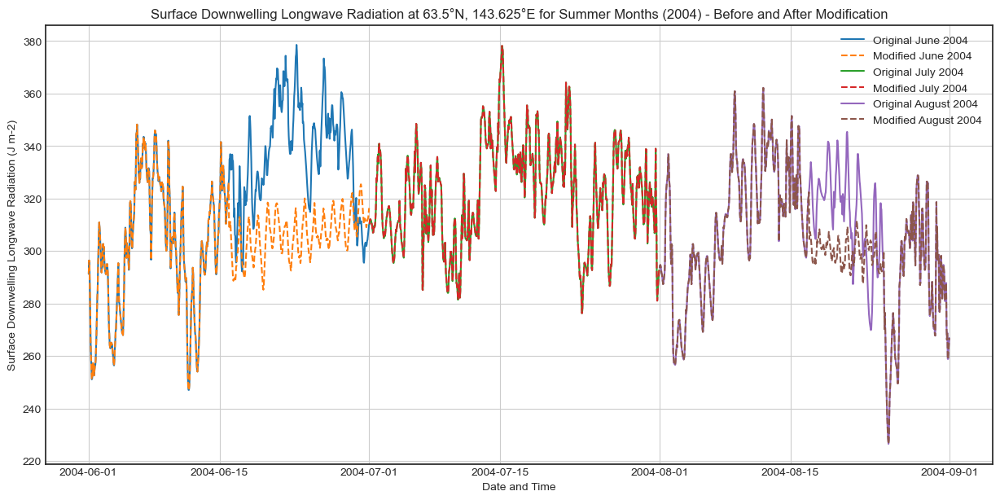

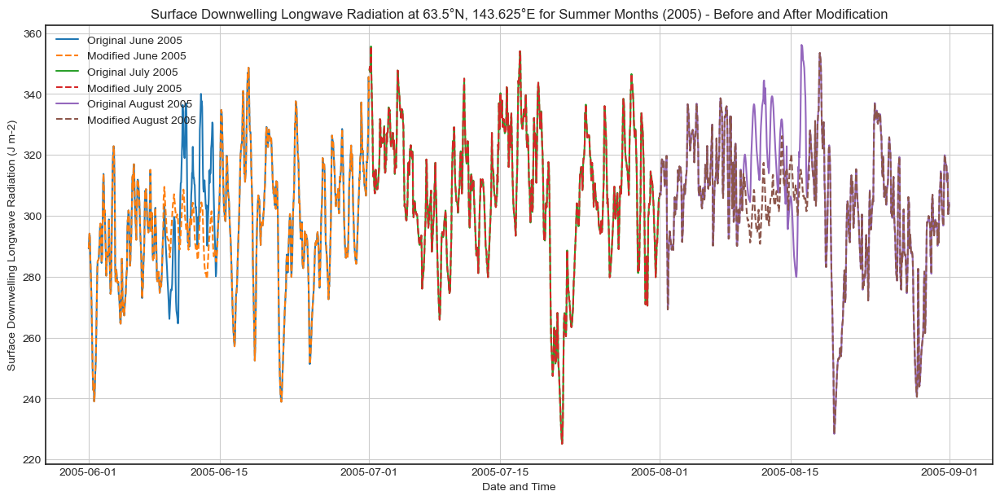

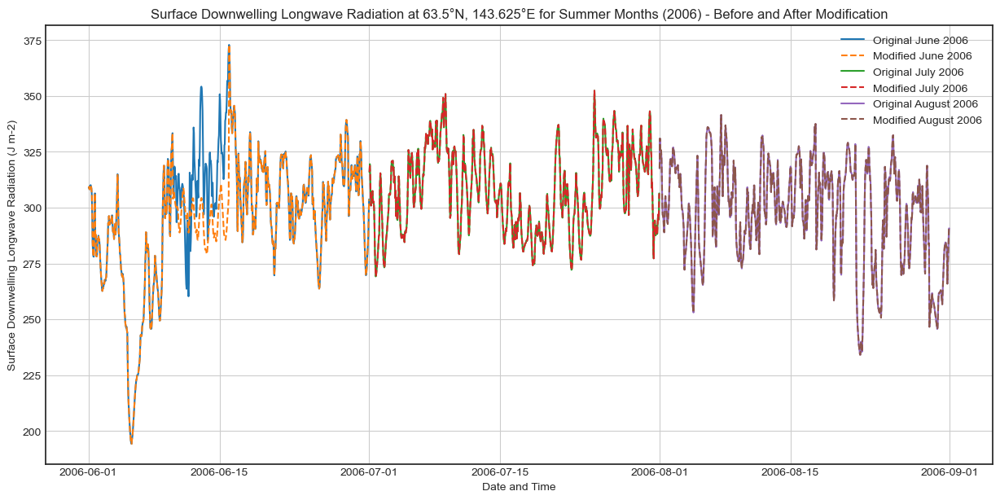

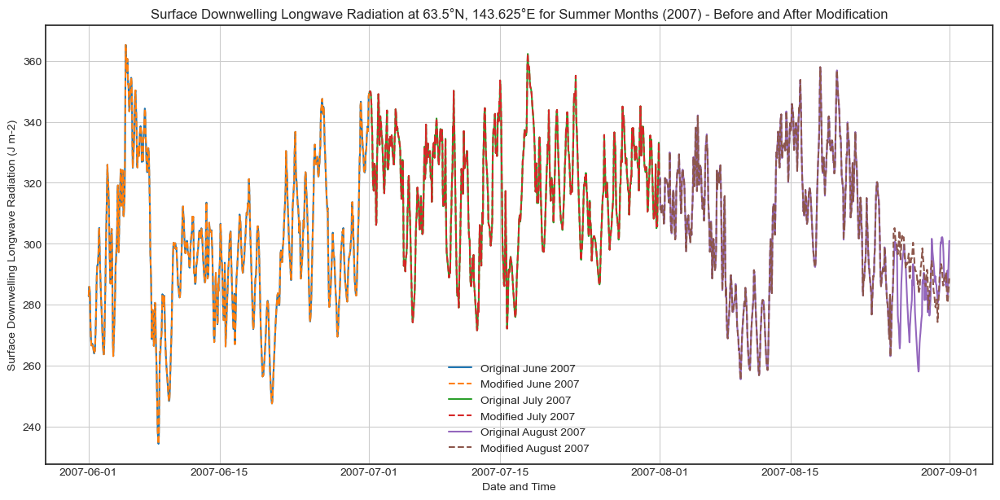

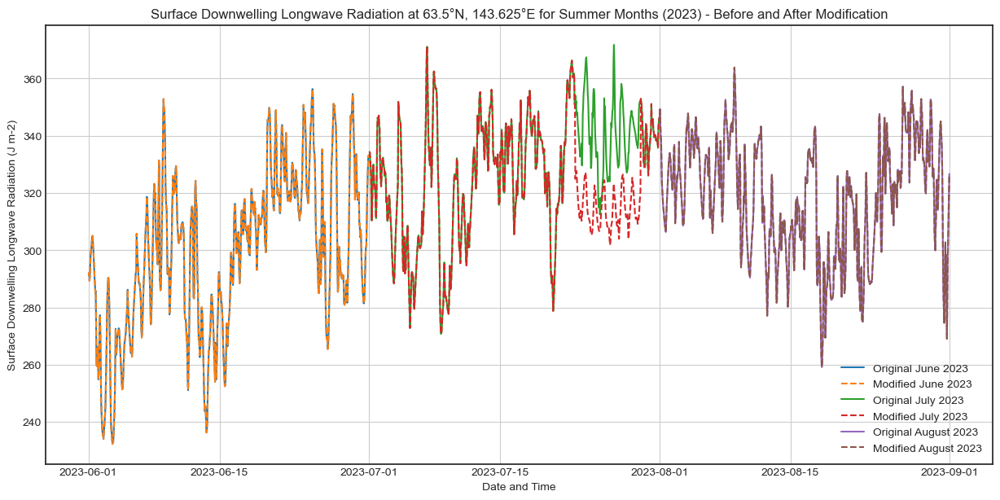

In [125]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = -143.625
summer_months = [6, 7, 8]
heatwave_periods = [
    ('2004-06-16', '2004-06-30'),
    ('2004-08-17', '2004-08-24'),
    ('2005-06-09', '2005-06-14'),
    ('2005-08-10', '2005-08-16'),
    ('2006-06-10', '2006-06-15'),
    ('2007-08-26', '2007-08-31'),
    ('2023-07-23', '2023-07-29')
]

file_path = '/Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_60_-150.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_no_heatwave.nc'

# Load the dataset
ds_notsubset = xr.open_dataset(file_path)

# Set units if they are missing
if 'units' not in ds_notsubset['LWGAB'].attrs:
    ds_notsubset['LWGAB'].attrs['units'] = 'J m-2'

# Select the LWGAB variable
lwgab = ds_notsubset['LWGAB']

# Select the nearest point to the given lat/lon
lwgab_point = lwgab.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
lwgab_point['time'] = pd.to_datetime(lwgab_point['time'].values)

# Filter out the heatwave years
is_not_heatwave_year = ~lwgab_point['time.year'].isin([2004, 2005, 2023])
lwgab_point_non_heatwave = lwgab_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer = lwgab_point_non_heatwave['time.month'].isin(summer_months)
summer_lwgab = lwgab_point_non_heatwave.sel(time=is_summer)

# Calculate the average surface downwelling longwave radiation profile for each hour of each day in the summer period
df_summer_lwgab = summer_lwgab.to_dataframe().reset_index()
df_summer_lwgab['hour'] = df_summer_lwgab['time'].dt.hour
df_summer_lwgab['day_of_year'] = df_summer_lwgab['time'].dt.dayofyear

# Group by day of the year and hour to get the average surface downwelling longwave radiation
hourly_avg_lwgab = df_summer_lwgab.groupby(['day_of_year', 'hour'])['LWGAB'].mean().reset_index()

# Create a new DataFrame to hold the modified data
df_lwgab_point = lwgab_point.to_dataframe().reset_index()

# Replace heatwave days with the average surface downwelling longwave radiation profile
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        
        for hour in range(24):
            mask = (df_lwgab_point['time'].dt.year == year) & (df_lwgab_point['time'].dt.dayofyear == day_of_year) & (df_lwgab_point['time'].dt.hour == hour)
            avg_lwgab = hourly_avg_lwgab[(hourly_avg_lwgab['day_of_year'] == day_of_year) & (hourly_avg_lwgab['hour'] == hour)]['LWGAB'].values[0]
            df_lwgab_point.loc[mask, 'LWGAB'] = avg_lwgab

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_lwgab_point.set_index(['time']).to_xarray()

unique_lats = np.unique(ds_modified['lat'].values)
unique_lons = np.unique(ds_modified['lon'].values)

# Create new coordinate arrays
lat_dim = xr.DataArray(unique_lats, dims='lat', name='lat')
lon_dim = xr.DataArray(unique_lons, dims='lon', name='lon')

# Reshape the LWGAB variable
reshaped_LWGAB = ds_modified['LWGAB'].values.reshape(len(ds_modified['time']), len(unique_lats), len(unique_lons))

# Create a new dataset with the desired structure
ds_new_restructured = xr.Dataset(
    {
        'LWGAB': (['time', 'lat', 'lon'], reshaped_LWGAB)
    },
    coords={
        'time': ds_modified['time'],
        'lat': lat_dim,
        'lon': lon_dim
    }
)

ds_new_restructured['LWGAB'].attrs['units'] = 'J m-2'

ds_new_restructured.to_netcdf(output_file_path)

print(f"Modified dataset saved to {output_file_path}")

# Plotting the results
modified_years = [2004, 2005, 2006, 2007, 2023]
for year in modified_years:
    is_year = lwgab_point['time.year'] == year
    ds_year = lwgab_point.sel(time=is_year)
    ds_modified_year = ds_modified.sel(time=is_year)

    plt.figure(figsize=(15, 7))

    for month, month_name in zip(summer_months, ['June', 'July', 'August']):
        is_month = ds_year['time.month'] == month
        ds_month = ds_year.sel(time=is_month)
        ds_modified_month = ds_modified_year.sel(time=is_month)

        plt.plot(ds_month['time'], ds_month, label=f'Original {month_name} {year}')
        plt.plot(ds_modified_month['time'], ds_modified_month['LWGAB'], linestyle='--', label=f'Modified {month_name} {year}')

    plt.title(f'Surface Downwelling Longwave Radiation at 63.5°N, 143.625°E for Summer Months ({year}) - Before and After Modification')
    plt.xlabel('Date and Time')
    plt.ylabel('Surface Downwelling Longwave Radiation (J m-2)')
    plt.legend()
    plt.grid(True)
    plt.show()


CORRECTED NO_HEATWAVE

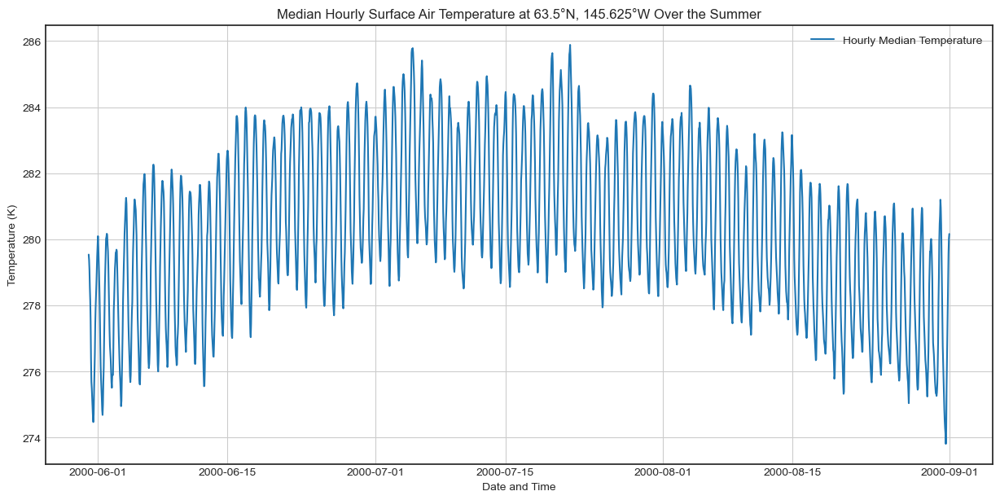

In [3]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'

# Load the dataset
ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter data for summer months
is_summer = t2m_point['time.month'].isin(summer_months)
summer_t2m = t2m_point.sel(time=is_summer)

# Convert to DataFrame for easier handling
df_summer_t2m = summer_t2m.to_dataframe().reset_index()

# Calculate the average temperature for each hour of each day in the summer period
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Plot the median hourly temperature over the summer period
plt.figure(figsize=(15, 7))
plt.plot(hourly_median_temps['time'], hourly_median_temps['T2M'], label='Hourly Median Temperature')
plt.title('Median Hourly Surface Air Temperature at 63.5°N, 145.625°W Over the Summer')
plt.xlabel('Date and Time')
plt.ylabel('Temperature (K)')
plt.legend()
plt.grid(True)
plt.show()


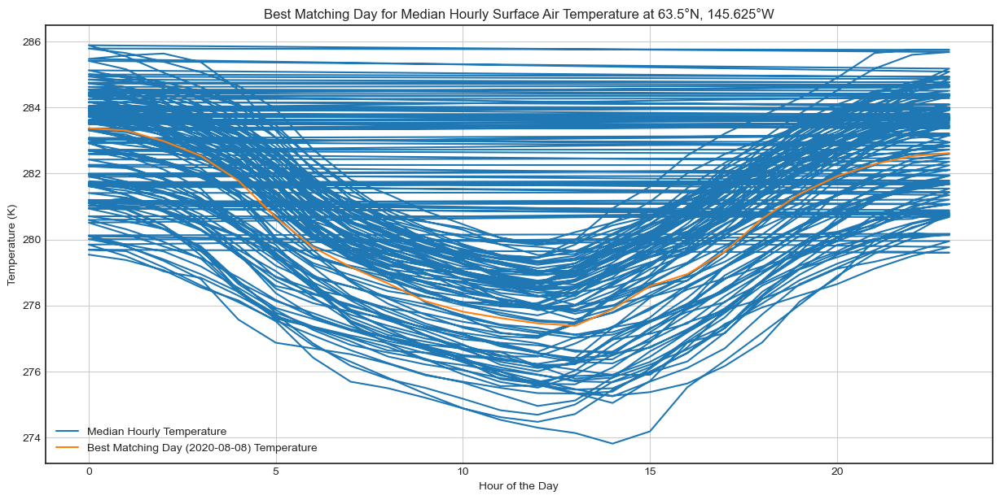

The day that best matches the median hourly temperatures is: 2020-08-08


In [4]:
from sklearn.metrics import mean_squared_error

best_day = None
lowest_mse = float('inf')

for day in df_summer_t2m['time'].dt.date.unique():
    day_df = df_summer_t2m[df_summer_t2m['time'].dt.date == day]
    if len(day_df) == 24:  # Ensure we have a complete day with 24 hourly temperatures
        # Merge day_df with hourly_median_temps to align hourly temperatures
        merged_df = day_df.merge(hourly_median_temps, on='hour', suffixes=('_day', '_median'))
        mse = mean_squared_error(merged_df['T2M_day'], merged_df['T2M_median'])
        if mse < lowest_mse:
            lowest_mse = mse
            best_day = day

# Get the best matching day's data
best_day_temps = df_summer_t2m[df_summer_t2m['time'].dt.date == best_day]

# Plot the best matching day’s temperatures
plt.figure(figsize=(15, 7))
plt.plot(hourly_median_temps['hour'], hourly_median_temps['T2M'], label='Median Hourly Temperature')
plt.plot(best_day_temps['hour'], best_day_temps['T2M'], label=f'Best Matching Day ({best_day}) Temperature')
plt.title(f'Best Matching Day for Median Hourly Surface Air Temperature at 63.5°N, 145.625°W')
plt.xlabel('Hour of the Day')
plt.ylabel('Temperature (K)')
plt.legend()
plt.grid(True)
plt.show()

print(f"The day that best matches the median hourly temperatures is: {best_day}")

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave.nc


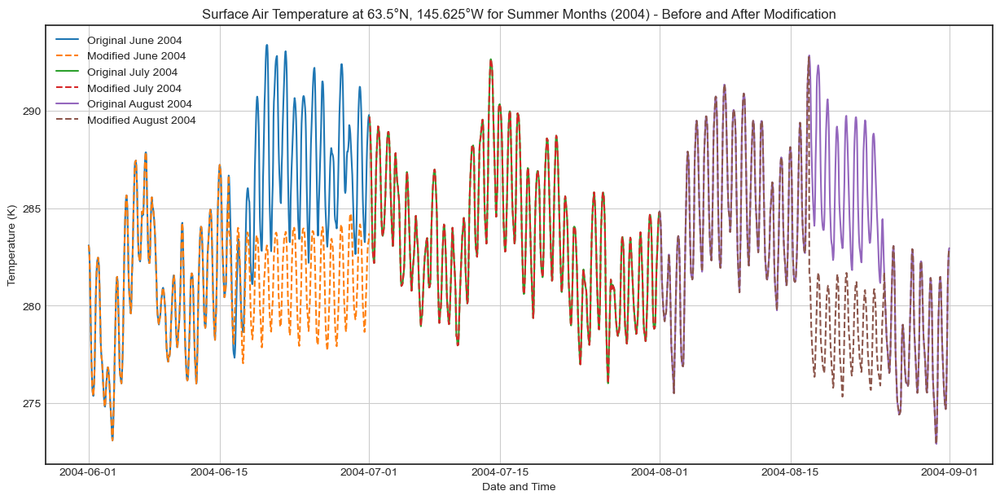

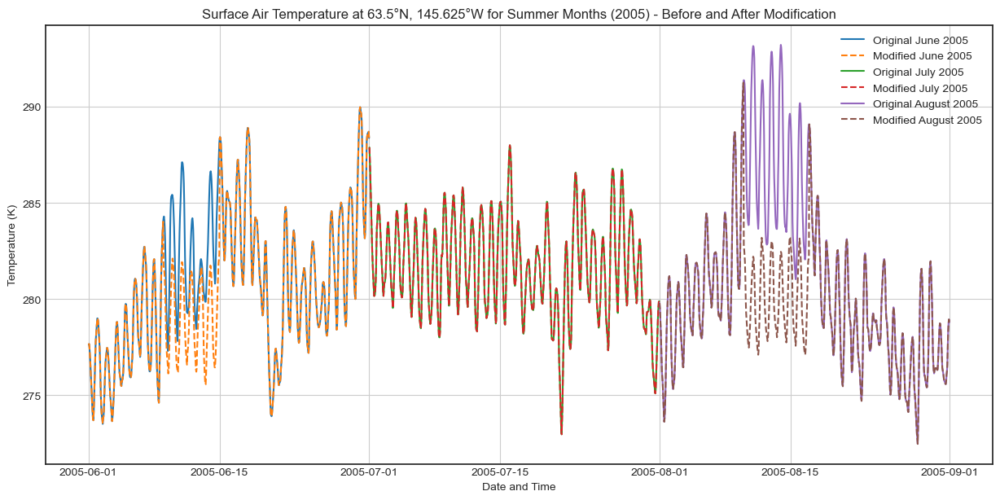

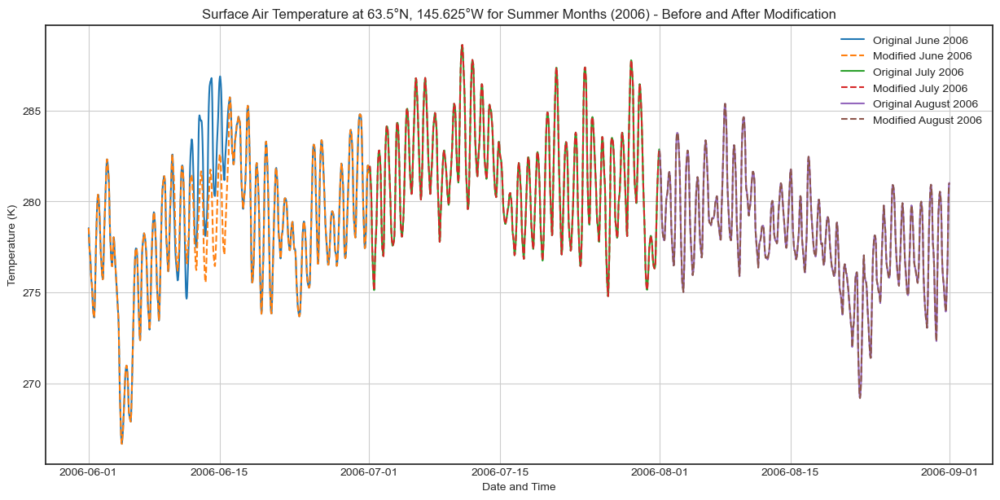

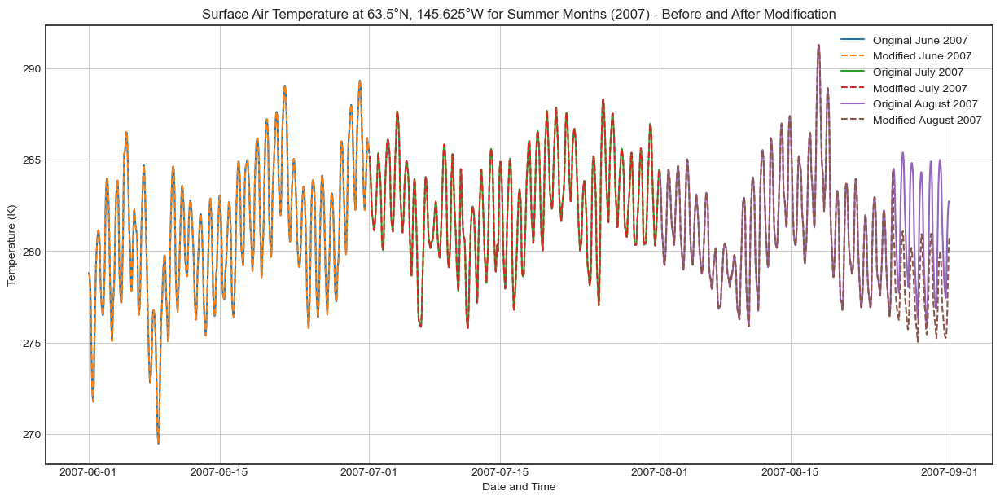

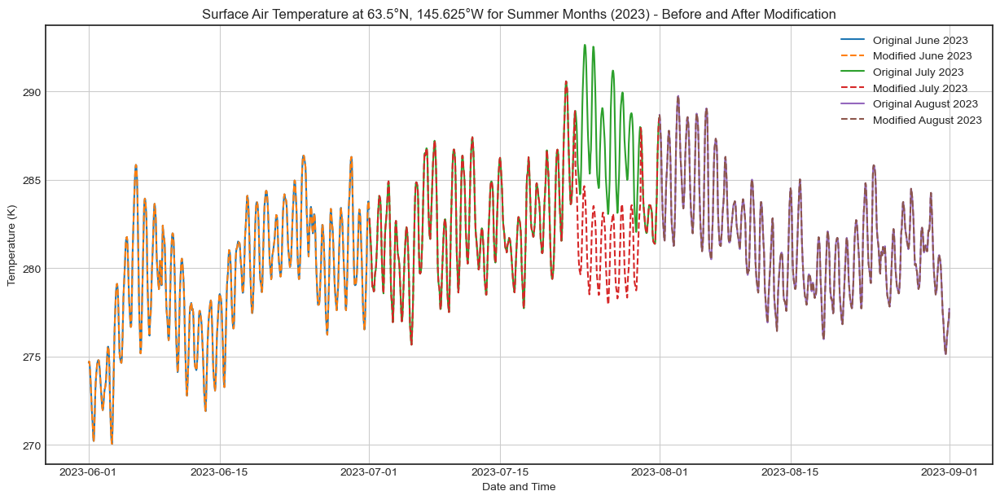

In [28]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [
    ('2004-06-16', '2004-06-30'),
    ('2004-08-17', '2004-08-24'),
    ('2005-06-09', '2005-06-14'),
    ('2005-08-10', '2005-08-16'),
    ('2006-06-10', '2006-06-15'),
    ('2007-08-26', '2007-08-31'),
    ('2023-07-23', '2023-07-29')
]

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave.nc'

ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter data for summer months
is_summer = t2m_point['time.month'].isin(summer_months)
summer_t2m = t2m_point.sel(time=is_summer)

# Convert to DataFrame for easier handling
df_summer_t2m = summer_t2m.to_dataframe().reset_index()

# Calculate the average temperature for each hour of each day in the summer period
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Create a new DataFrame to hold the modified data
df_t2m_point = t2m_point.to_dataframe().reset_index()

# Replace heatwave days with the median temperature profile
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

unique_lats = np.unique(ds_modified['lat'].values)
unique_lons = np.unique(ds_modified['lon'].values)

# Create new coordinate arrays
lat_dim = xr.DataArray(unique_lats, dims='lat', name='lat')
lon_dim = xr.DataArray(unique_lons, dims='lon', name='lon')

# Reshape the T2M variable
reshaped_T2M = ds_modified['T2M'].values.reshape(len(ds_modified['time']), len(unique_lats), len(unique_lons))

# Create a new dataset with the desired structure
ds_new_restructured = xr.Dataset(
    {
        'T2M': (['time', 'lat', 'lon'], reshaped_T2M)
    },
    coords={
        'time': ds_modified['time'],
        'lat': lat_dim,
        'lon': lon_dim
    }
)

ds_new_restructured['T2M'].attrs['units'] = 'K'

ds_new_restructured.to_netcdf(output_file_path)

print(f"Modified dataset saved to {output_file_path}")

modified_years = [2004, 2005, 2006, 2007, 2023]
for year in modified_years:
    is_year = t2m_point['time.year'] == year
    ds_year = t2m_point.sel(time=is_year)
    ds_modified_year = ds_modified.sel(time=is_year)

    plt.figure(figsize=(15, 7))

    for month, month_name in zip(summer_months, ['June', 'July', 'August']):
        is_month = ds_year['time.month'] == month
        ds_month = ds_year.sel(time=is_month)
        ds_modified_month = ds_modified_year.sel(time=is_month)

        plt.plot(ds_month['time'], ds_month, label=f'Original {month_name} {year}')
        plt.plot(ds_modified_month['time'], ds_modified_month['T2M'], linestyle='--', label=f'Modified {month_name} {year}')

    plt.title(f'Surface Air Temperature at 63.5°N, 145.625°W for Summer Months ({year}) - Before and After Modification')
    plt.xlabel('Date and Time')
    plt.ylabel('Temperature (K)')
    plt.legend()
    plt.grid(True)
    plt.show()


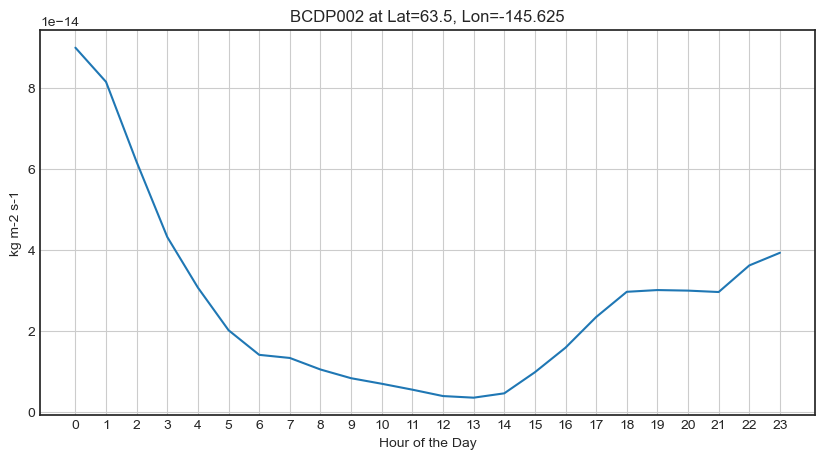

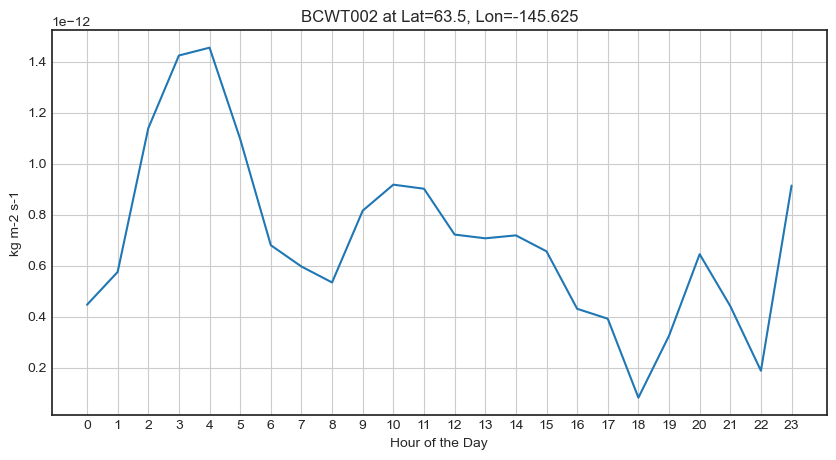

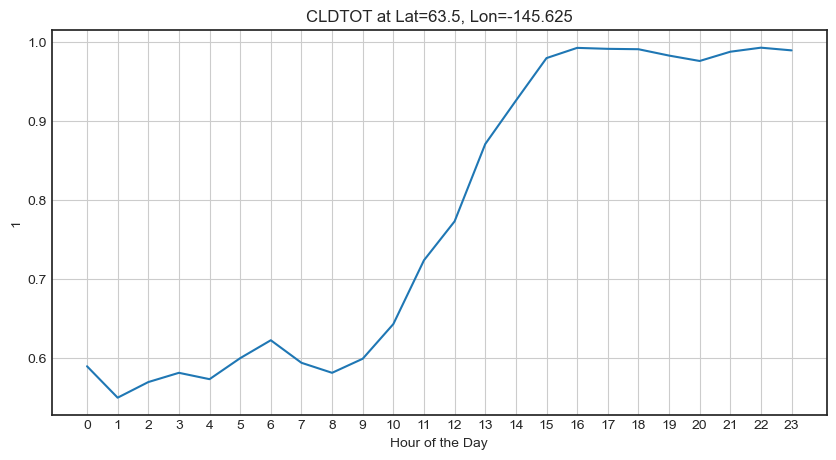

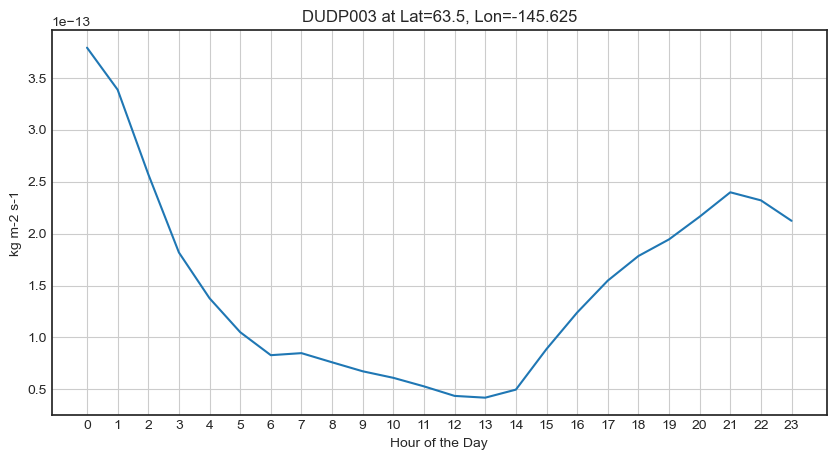

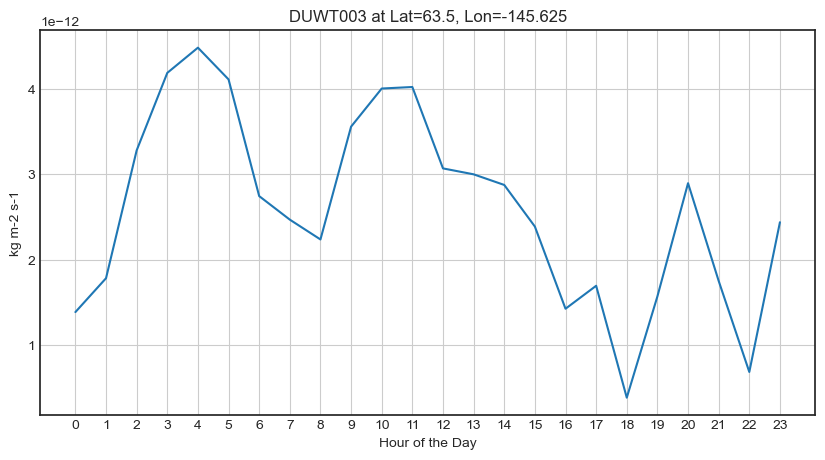

...

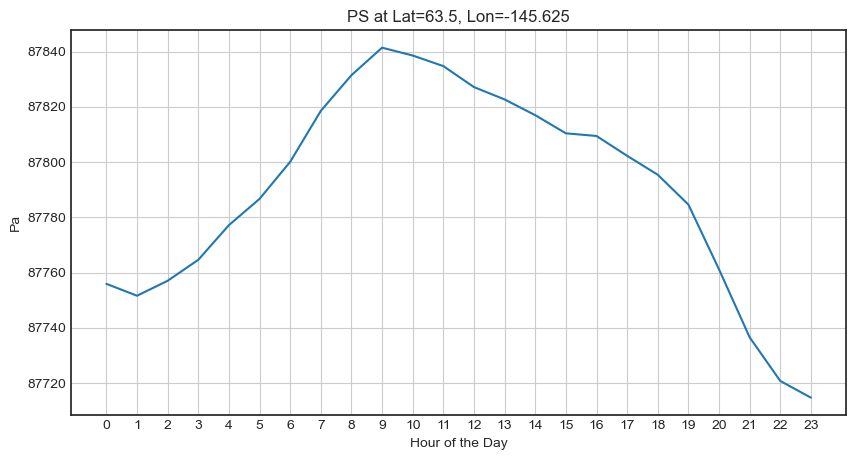

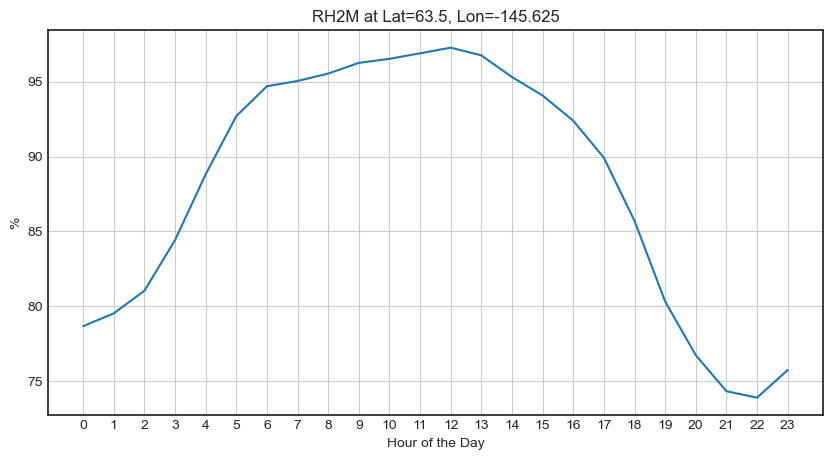

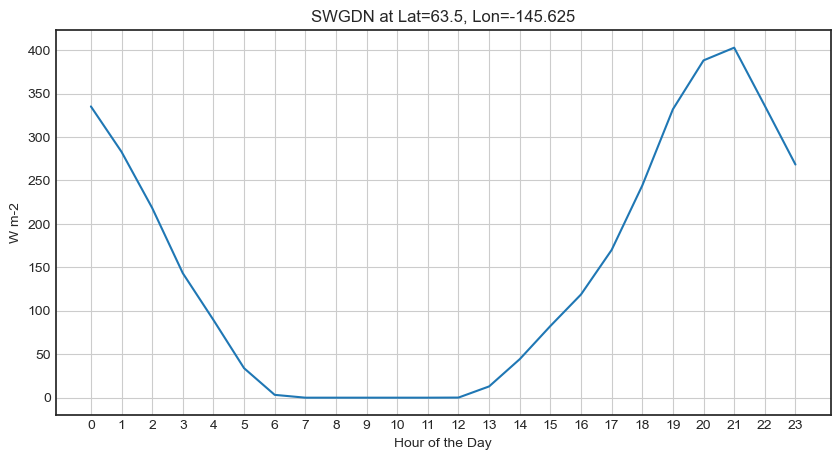

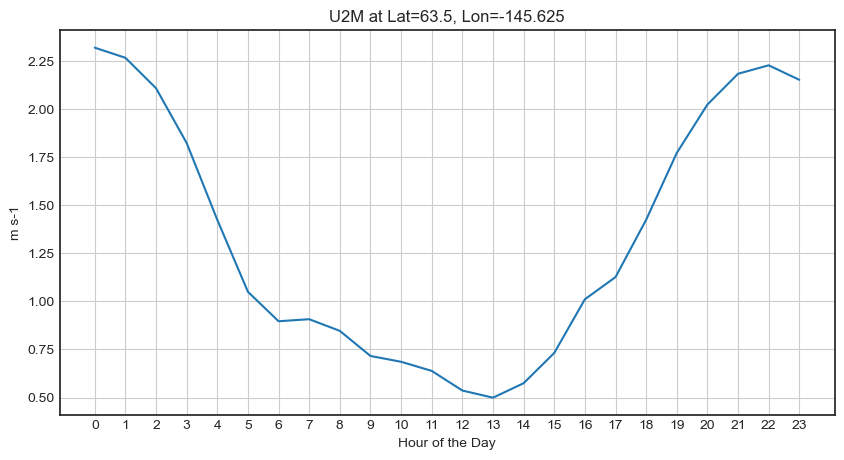

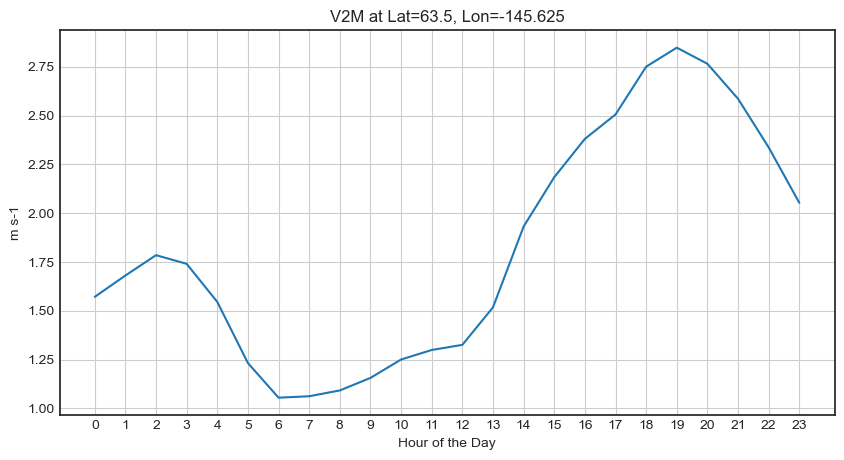

In [31]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# List of variables
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB',
        'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']

# Specify the latitude and longitude
lat = 63.5
lon = -145.625

# Load the NetCDF file for each variable
for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_60_-150.nc'
    data = xr.open_dataset(filename)

    # Select the nearest point to the specified lat/lon
    data_day_location = data.sel(lat=lat, lon=lon, method='nearest')
    # Convert time to pandas datetime for easier handling
    data_day_location['time'] = pd.to_datetime(data_day_location['time'].values)

    # Slice data for the specific day and time range
    data_day_location = data_day_location.sel(time=slice('2003-07-30T00:30:00', '2003-07-30T23:30:00'))

    # Plotting hourly data
    plt.figure(figsize=(10, 5))
    plt.plot(data_day_location['time.hour'], data_day_location[var])
    plt.title(f'{var} at Lat={lat}, Lon={lon}')
    plt.xlabel('Hour of the Day')
    plt.ylabel(data[var].attrs['units'])  # Assuming units are stored in attributes
    plt.grid(True)
    plt.xticks(range(0, 24))  # Set ticks for 24 hours
    plt.show()


In [5]:
import xarray as xr
import pandas as pd

# List of variables
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB',
        'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']

# Specify the latitude and longitude
lat = 63.5
lon = -145.625

# Define heatwave periods
heatwave_periods = [
    ('2004-06-16', '2004-06-30'),
    ('2004-08-17', '2004-08-24'),
    ('2005-06-09', '2005-06-14'),
    ('2005-08-10', '2005-08-16'),
    ('2006-06-10', '2006-06-15'),
    ('2007-08-26', '2007-08-31'),
    ('2023-07-23', '2023-07-29')
]

# Base date for replacement
replacement_date = '2020-08-08'

# Iterate over each variable
for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_60_-150.nc'
    data = xr.open_dataset(filename)
    
    # Select the nearest point to the specified lat/lon
    data_copy = data.copy()
    data_location = data_copy.sel(lat=lat, lon=lon, method='nearest')
    
    # Convert time to pandas datetime for easier handling
    data_location['time'] = pd.to_datetime(data_location['time'].values)
    
    # Extract data for the replacement date
    replacement_data = data_location.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    # Iterate over each heatwave period
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        # Iterate over each day in the heatwave period
        for date in pd.date_range(start_datetime, end_datetime):
            # Get the time slice for the current date
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            
            # Replace data for the current date with the replacement data
            data_location[var].loc[{'time': time_slice}] = replacement_data.values
    
    # Save the modified data to a new NetCDF file
    data_copy.loc[{'lat': lat, 'lon': lon}] = data_location
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_no_heatwave.nc'
    data_copy.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_no_heatwave.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_no_heatwave.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_no_heatwave.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_no_heatwave.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_no_heatwave.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_no_heatwave.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_no_heatwave.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_no_heatwave.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/RH2M/MERRA2_RH2M_no_heatwave.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_SWGDN_no_

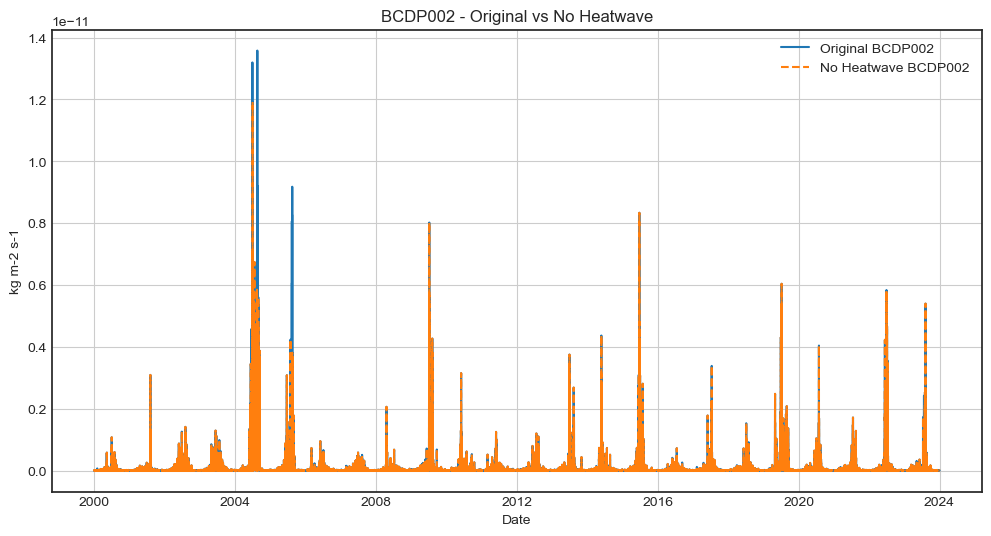

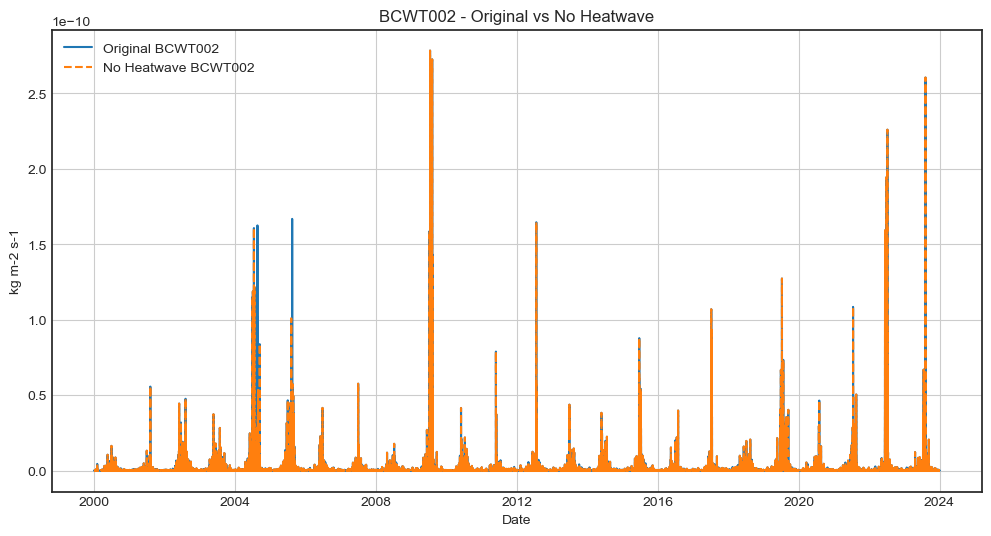

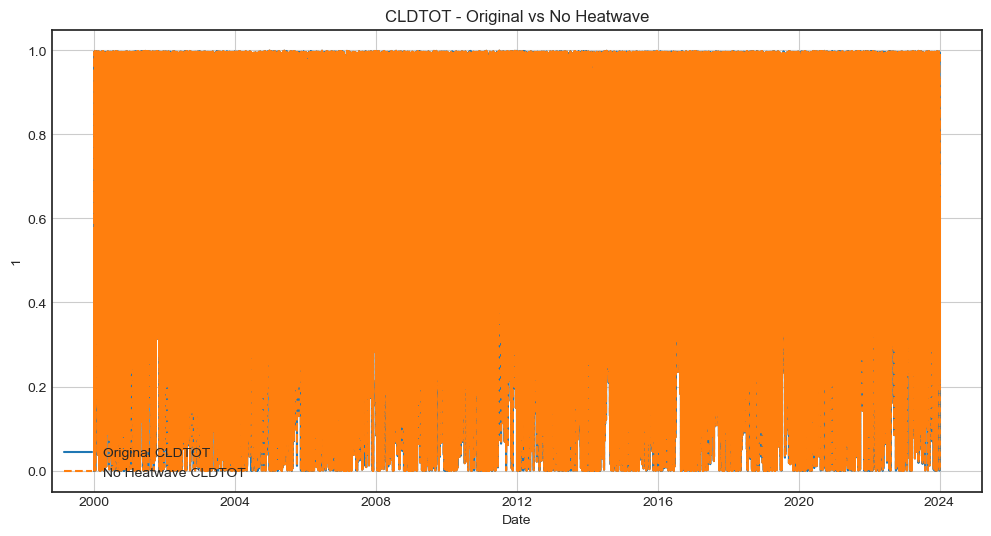

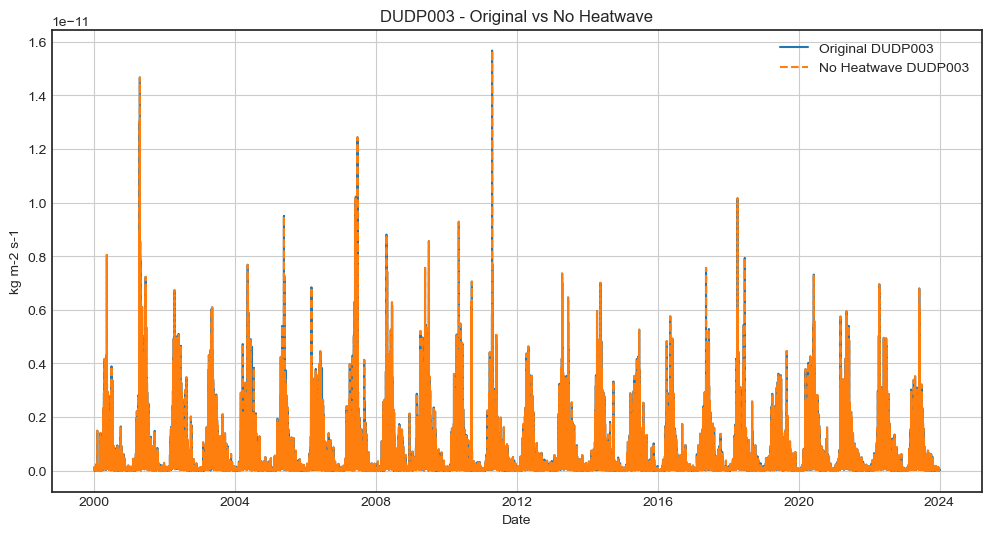

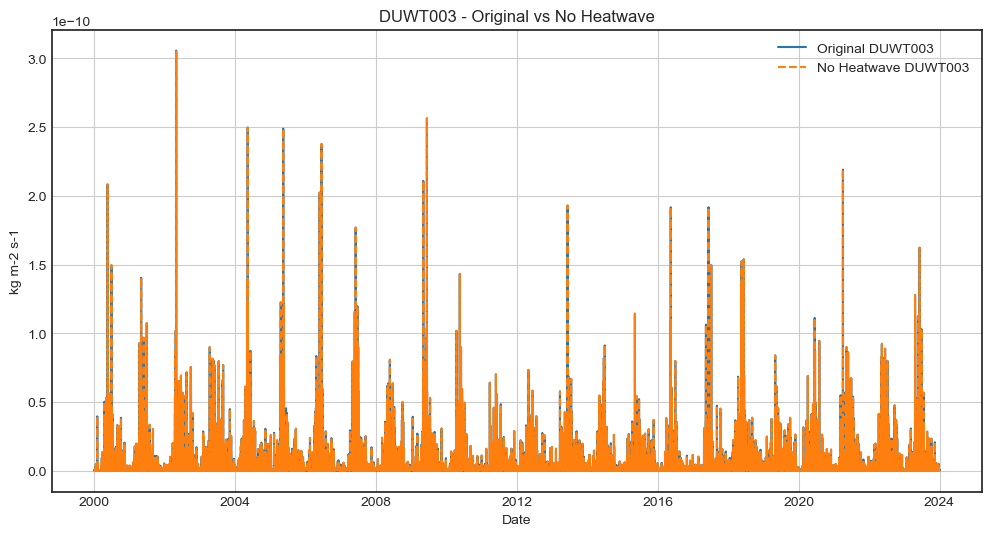

...

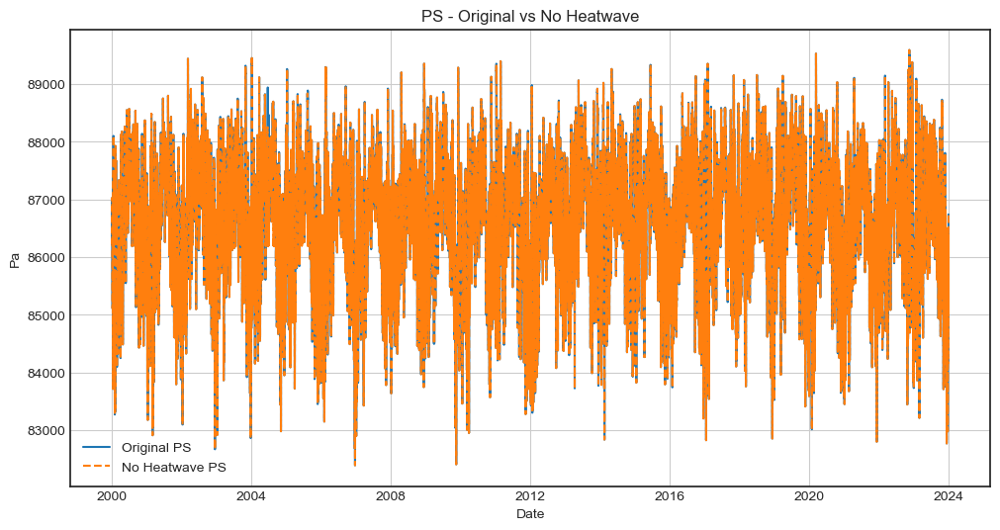

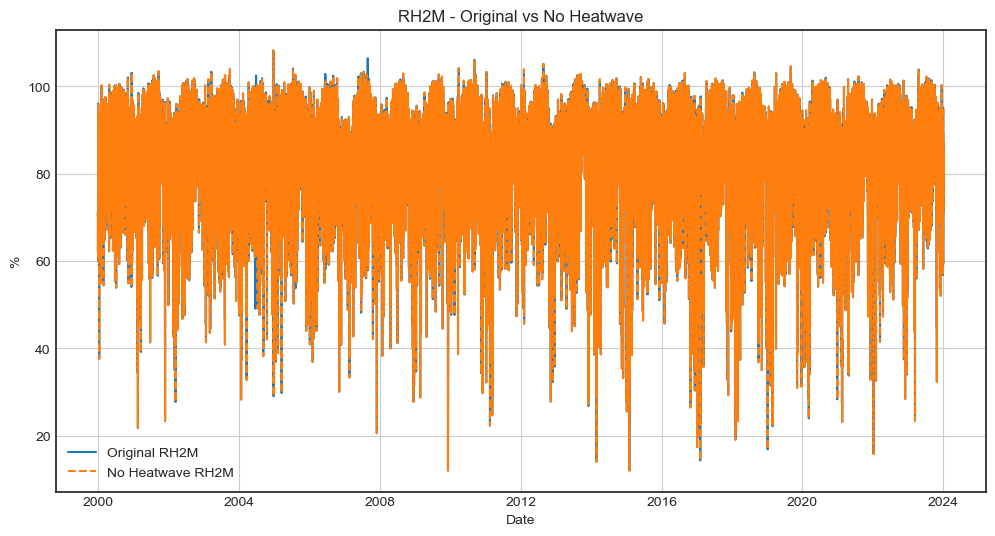

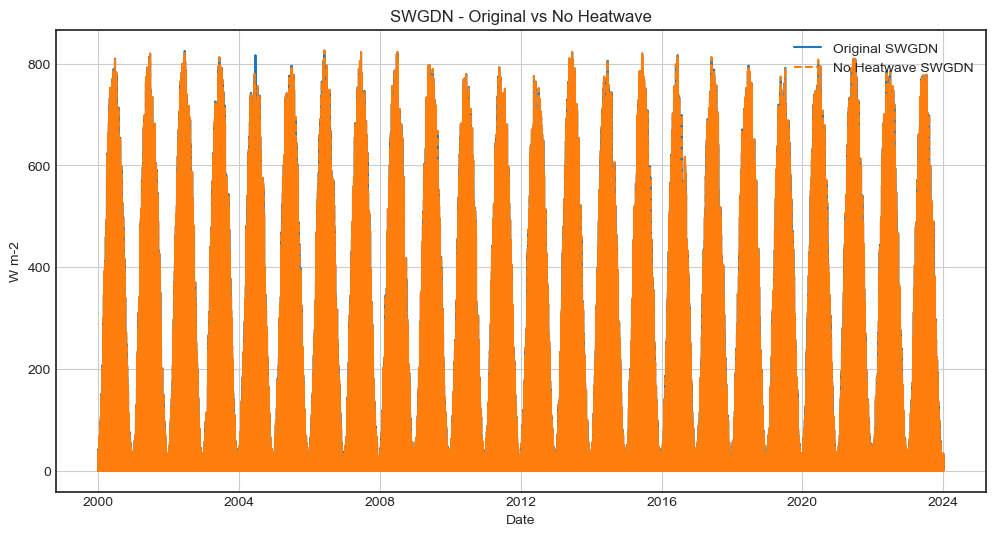

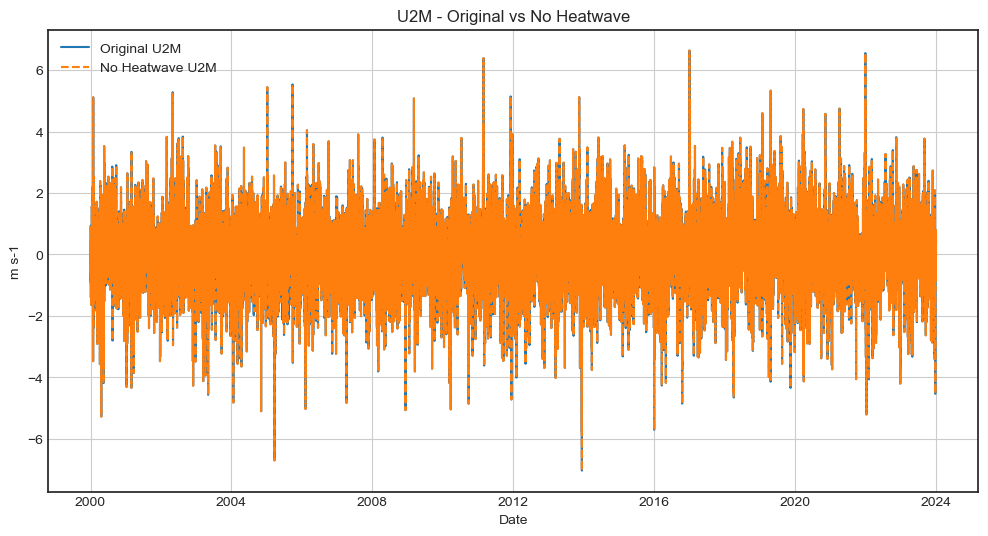

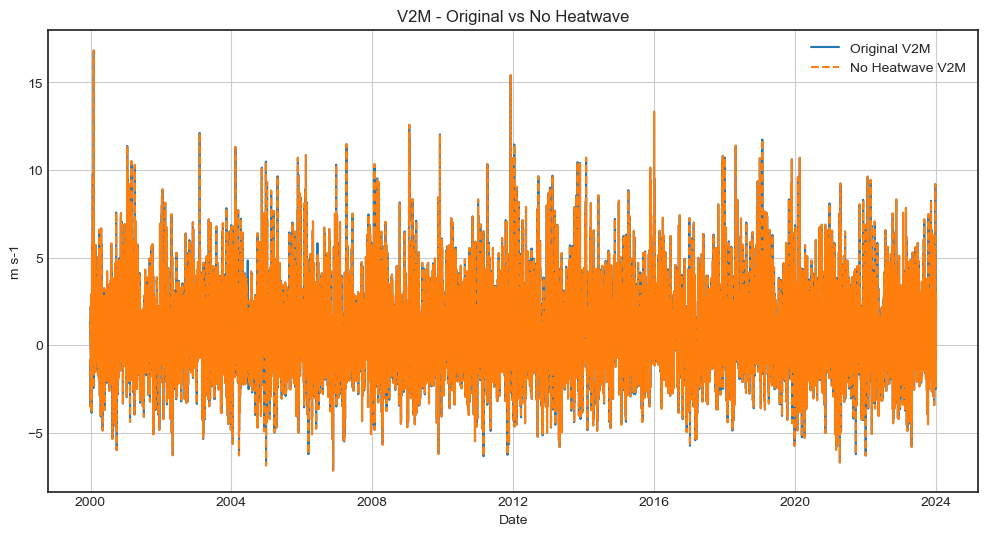

In [34]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Specify the latitude and longitude
lat = 63.5
lon = -145.625

# Define heatwave periods
heatwave_periods = [
    ('2004-06-16', '2004-06-30'),
    ('2004-08-17', '2004-08-24'),
    ('2005-06-09', '2005-06-14'),
    ('2005-08-10', '2005-08-16'),
    ('2006-06-10', '2006-06-15'),
    ('2007-08-26', '2007-08-31'),
    ('2023-07-23', '2023-07-29')
]

# List of variables
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB',
        'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']

# Iterate over each variable
for var in vars:
    # Load original dataset
    filename_original = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_60_-150.nc'
    data_original = xr.open_dataset(filename_original)
    
    filename_modified = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_no_heatwave.nc'
    data_mod = xr.open_dataset(filename_modified)

    data_location = data_original.sel(lat=lat, lon=lon, method='nearest').copy()  # Make a copy to avoid modifying original
    data_modified = data_mod.sel(lat=lat,lon=lon,method='nearest').copy()

    plt.figure(figsize=(12, 6))
    
    # Plot original data
    plt.plot(data_location['time'], data_location[var], label=f'Original {var}')
    
    # Plot modified (no_heatwave) data
    plt.plot(data_modified['time'], data_modified[var], linestyle='--', label=f'No Heatwave {var}')
    
    plt.title(f'{var} - Original vs No Heatwave')
    plt.xlabel('Date')
    plt.ylabel(data_original[var].attrs['units'])  # Assuming units are stored in attributes
    plt.legend()
    plt.grid(True)
    plt.show()

Playing Around With Inputs

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_beg_sum_2004.nc


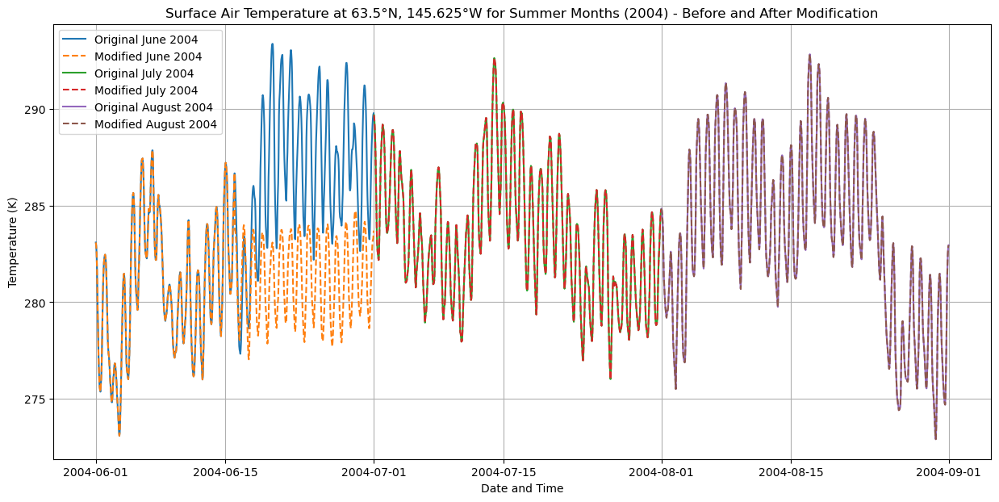

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/RH2M/MERRA2_RH2M_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_

In [1]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [
    ('2004-06-16', '2004-06-30')
]

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_beg_sum_2004.nc'

ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter data for summer months
is_summer = t2m_point['time.month'].isin(summer_months)
summer_t2m = t2m_point.sel(time=is_summer)

# Convert to DataFrame for easier handling
df_summer_t2m = summer_t2m.to_dataframe().reset_index()

# Calculate the average temperature for each hour of each day in the summer period
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Create a new DataFrame to hold the modified data
df_t2m_point = t2m_point.to_dataframe().reset_index()

# Replace heatwave days with the median temperature profile
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

unique_lats = np.unique(ds_modified['lat'].values)
unique_lons = np.unique(ds_modified['lon'].values)

# Create new coordinate arrays
lat_dim = xr.DataArray(unique_lats, dims='lat', name='lat')
lon_dim = xr.DataArray(unique_lons, dims='lon', name='lon')

# Reshape the T2M variable
reshaped_T2M = ds_modified['T2M'].values.reshape(len(ds_modified['time']), len(unique_lats), len(unique_lons))

# Create a new dataset with the desired structure
ds_new_restructured = xr.Dataset(
    {
        'T2M': (['time', 'lat', 'lon'], reshaped_T2M)
    },
    coords={
        'time': ds_modified['time'],
        'lat': lat_dim,
        'lon': lon_dim
    }
)

ds_new_restructured['T2M'].attrs['units'] = 'K'

ds_new_restructured.to_netcdf(output_file_path)

print(f"Modified dataset saved to {output_file_path}")

modified_years = [2004]
for year in modified_years:
    is_year = t2m_point['time.year'] == year
    ds_year = t2m_point.sel(time=is_year)
    ds_modified_year = ds_modified.sel(time=is_year)

    plt.figure(figsize=(15, 7))

    for month, month_name in zip(summer_months, ['June', 'July', 'August']):
        is_month = ds_year['time.month'] == month
        ds_month = ds_year.sel(time=is_month)
        ds_modified_month = ds_modified_year.sel(time=is_month)

        plt.plot(ds_month['time'], ds_month, label=f'Original {month_name} {year}')
        plt.plot(ds_modified_month['time'], ds_modified_month['T2M'], linestyle='--', label=f'Modified {month_name} {year}')

    plt.title(f'Surface Air Temperature at 63.5°N, 145.625°W for Summer Months ({year}) - Before and After Modification')
    plt.xlabel('Date and Time')
    plt.ylabel('Temperature (K)')
    plt.legend()
    plt.grid(True)
    plt.show()

import xarray as xr
import pandas as pd

# List of variables
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB',
        'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']

# Base date for replacement
replacement_date = '2020-08-08'

# Iterate over each variable
for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_60_-150.nc'
    data = xr.open_dataset(filename)
    
    # Select the nearest point to the specified lat/lon
    data_copy = data.copy()
    data_location = data_copy.sel(lat=lat, lon=lon, method='nearest')
    
    # Convert time to pandas datetime for easier handling
    data_location['time'] = pd.to_datetime(data_location['time'].values)
    
    # Extract data for the replacement date
    replacement_data = data_location.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    # Iterate over each heatwave period
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        # Iterate over each day in the heatwave period
        for date in pd.date_range(start_datetime, end_datetime):
            # Get the time slice for the current date
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            
            # Replace data for the current date with the replacement data
            data_location[var].loc[{'time': time_slice}] = replacement_data.values
    
    # Save the modified data to a new NetCDF file
    data_copy.loc[{'lat': lat, 'lon': lon}] = data_location
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_beg_sum_2004.nc'
    data_copy.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc


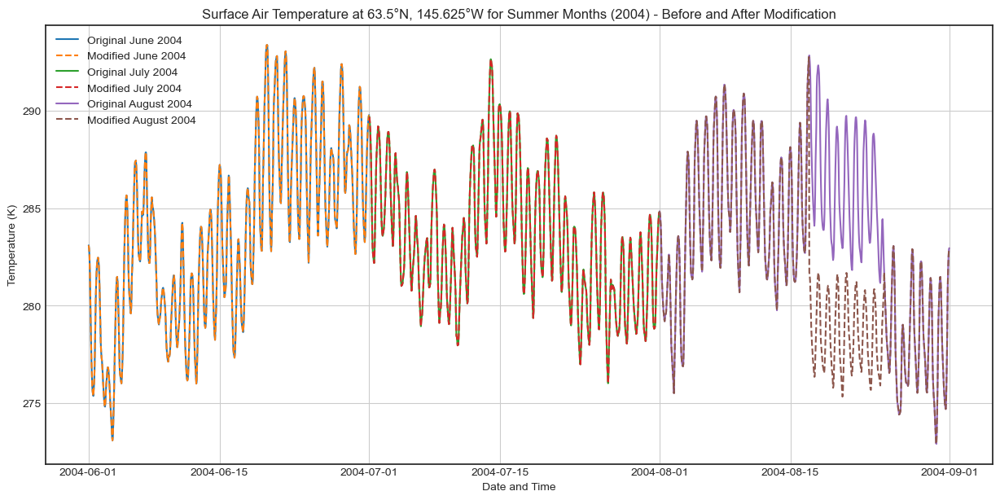

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/RH2M/MERRA2_RH2M_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_

In [7]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [
    ('2004-08-17', '2004-08-24')
]

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'

ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter data for summer months
is_summer = t2m_point['time.month'].isin(summer_months)
summer_t2m = t2m_point.sel(time=is_summer)

# Convert to DataFrame for easier handling
df_summer_t2m = summer_t2m.to_dataframe().reset_index()

# Calculate the average temperature for each hour of each day in the summer period
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Create a new DataFrame to hold the modified data
df_t2m_point = t2m_point.to_dataframe().reset_index()

# Replace heatwave days with the median temperature profile
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

unique_lats = np.unique(ds_modified['lat'].values)
unique_lons = np.unique(ds_modified['lon'].values)

# Create new coordinate arrays
lat_dim = xr.DataArray(unique_lats, dims='lat', name='lat')
lon_dim = xr.DataArray(unique_lons, dims='lon', name='lon')

# Reshape the T2M variable
reshaped_T2M = ds_modified['T2M'].values.reshape(len(ds_modified['time']), len(unique_lats), len(unique_lons))

# Create a new dataset with the desired structure
ds_new_restructured = xr.Dataset(
    {
        'T2M': (['time', 'lat', 'lon'], reshaped_T2M)
    },
    coords={
        'time': ds_modified['time'],
        'lat': lat_dim,
        'lon': lon_dim
    }
)

ds_new_restructured['T2M'].attrs['units'] = 'K'

ds_new_restructured.to_netcdf(output_file_path)

print(f"Modified dataset saved to {output_file_path}")

modified_years = [2004]
for year in modified_years:
    is_year = t2m_point['time.year'] == year
    ds_year = t2m_point.sel(time=is_year)
    ds_modified_year = ds_modified.sel(time=is_year)

    plt.figure(figsize=(15, 7))

    for month, month_name in zip(summer_months, ['June', 'July', 'August']):
        is_month = ds_year['time.month'] == month
        ds_month = ds_year.sel(time=is_month)
        ds_modified_month = ds_modified_year.sel(time=is_month)

        plt.plot(ds_month['time'], ds_month, label=f'Original {month_name} {year}')
        plt.plot(ds_modified_month['time'], ds_modified_month['T2M'], linestyle='--', label=f'Modified {month_name} {year}')

    plt.title(f'Surface Air Temperature at 63.5°N, 145.625°W for Summer Months ({year}) - Before and After Modification')
    plt.xlabel('Date and Time')
    plt.ylabel('Temperature (K)')
    plt.legend()
    plt.grid(True)
    plt.show()

import xarray as xr
import pandas as pd

# List of variables
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB',
        'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']

# Base date for replacement
replacement_date = '2020-08-08'

# Iterate over each variable
for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_60_-150.nc'
    data = xr.open_dataset(filename)
    
    # Select the nearest point to the specified lat/lon
    data_copy = data.copy()
    data_location = data_copy.sel(lat=lat, lon=lon, method='nearest')
    
    # Convert time to pandas datetime for easier handling
    data_location['time'] = pd.to_datetime(data_location['time'].values)
    
    # Extract data for the replacement date
    replacement_data = data_location.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    # Iterate over each heatwave period
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        # Iterate over each day in the heatwave period
        for date in pd.date_range(start_datetime, end_datetime):
            # Get the time slice for the current date
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            
            # Replace data for the current date with the replacement data
            data_location[var].loc[{'time': time_slice}] = replacement_data.values
    
    # Save the modified data to a new NetCDF file
    data_copy.loc[{'lat': lat, 'lon': lon}] = data_location
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data_copy.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_short_end_sum_2004.nc


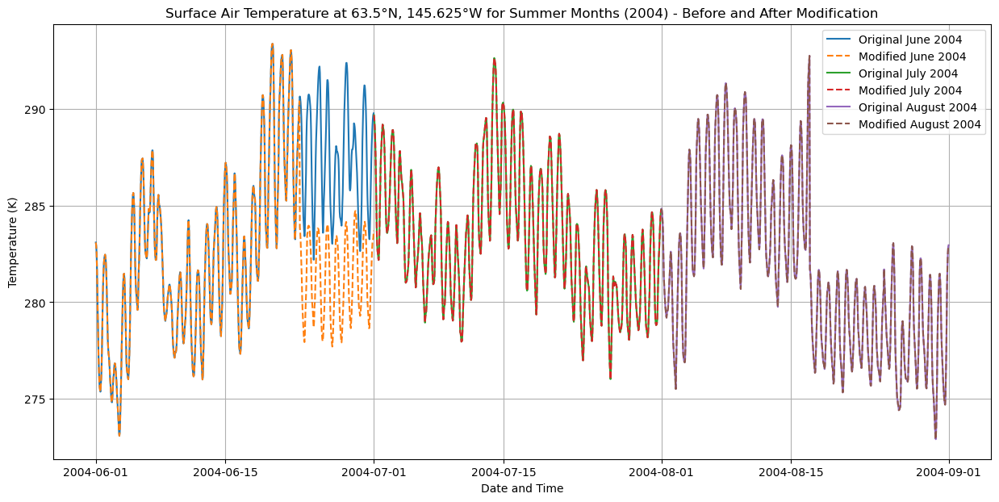

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_short_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_short_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_short_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_short_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_short_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_short_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_short_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_short_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/RH2M/MERRA2_RH2M_short_end_sum_2004.nc
Modified dataset saved t

In [2]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-23', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_short_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon and convert time to pandas datetime
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter data for summer months
is_summer = t2m_point['time.month'].isin(summer_months)
summer_t2m = t2m_point.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m_point.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset and restructure
ds_modified = df_t2m_point.set_index(['time']).to_xarray()
unique_lats = np.unique(ds_modified['lat'].values)
unique_lons = np.unique(ds_modified['lon'].values)

lat_dim = xr.DataArray(unique_lats, dims='lat', name='lat')
lon_dim = xr.DataArray(unique_lons, dims='lon', name='lon')
reshaped_T2M = ds_modified['T2M'].values.reshape(len(ds_modified['time']), len(unique_lats), len(unique_lons))

ds_new_restructured = xr.Dataset(
    {'T2M': (['time', 'lat', 'lon'], reshaped_T2M)},
    coords={'time': ds_modified['time'], 'lat': lat_dim, 'lon': lon_dim}
)
ds_new_restructured['T2M'].attrs['units'] = 'K'
ds_new_restructured.to_netcdf(output_file_path)
print(f"Modified dataset saved to {output_file_path}")

# Plot the original and modified datasets for comparison
modified_years = [2004]
for year in modified_years:
    is_year = t2m_point['time.year'] == year
    ds_year = t2m_point.sel(time=is_year)
    ds_modified_year = ds_modified.sel(time=is_year)

    plt.figure(figsize=(15, 7))
    for month, month_name in zip(summer_months, ['June', 'July', 'August']):
        is_month = ds_year['time.month'] == month
        ds_month = ds_year.sel(time=is_month)
        ds_modified_month = ds_modified_year.sel(time=is_month)

        plt.plot(ds_month['time'], ds_month, label=f'Original {month_name} {year}')
        plt.plot(ds_modified_month['time'], ds_modified_month['T2M'], linestyle='--', label=f'Modified {month_name} {year}')

    plt.title(f'Surface Air Temperature at 63.5°N, 145.625°W for Summer Months ({year}) - Before and After Modification')
    plt.xlabel('Date and Time')
    plt.ylabel('Temperature (K)')
    plt.legend()
    plt.grid(True)
    plt.show()

# Process other variables and replace heatwave data with the replacement date data
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename)
    
    data_copy = data.copy()
    data_location = data_copy.sel(lat=lat, lon=lon, method='nearest')
    data_location['time'] = pd.to_datetime(data_location['time'].values)
    
    replacement_data = data_location.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data_location[var].loc[{'time': time_slice}] = replacement_data.values
    
    data_copy.loc[{'lat': lat, 'lon': lon}] = data_location
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_short_end_sum_2004.nc'
    data_copy.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_short_beg_sum_2004.nc


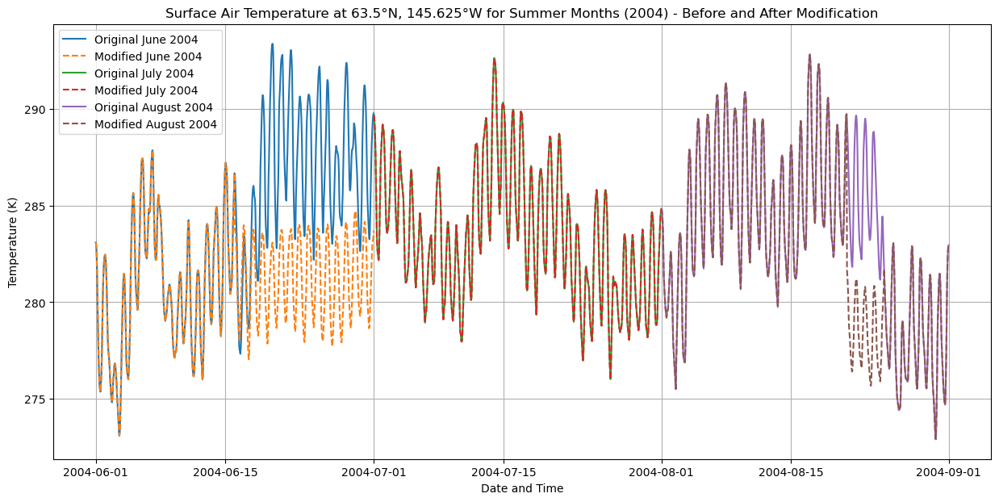

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_short_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_short_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_short_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_short_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_short_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_short_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_short_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_short_beg_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/RH2M/MERRA2_RH2M_short_beg_sum_2004.nc
Modified dataset saved t

In [2]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [
    ('2004-06-16', '2004-06-30'),
    ('2004-08-21', '2004-08-24')
]

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_short_beg_sum_2004.nc'

ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter data for summer months
is_summer = t2m_point['time.month'].isin(summer_months)
summer_t2m = t2m_point.sel(time=is_summer)

# Convert to DataFrame for easier handling
df_summer_t2m = summer_t2m.to_dataframe().reset_index()

# Calculate the average temperature for each hour of each day in the summer period
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Create a new DataFrame to hold the modified data
df_t2m_point = t2m_point.to_dataframe().reset_index()

# Replace heatwave days with the median temperature profile
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

unique_lats = np.unique(ds_modified['lat'].values)
unique_lons = np.unique(ds_modified['lon'].values)

# Create new coordinate arrays
lat_dim = xr.DataArray(unique_lats, dims='lat', name='lat')
lon_dim = xr.DataArray(unique_lons, dims='lon', name='lon')

# Reshape the T2M variable
reshaped_T2M = ds_modified['T2M'].values.reshape(len(ds_modified['time']), len(unique_lats), len(unique_lons))

# Create a new dataset with the desired structure
ds_new_restructured = xr.Dataset(
    {
        'T2M': (['time', 'lat', 'lon'], reshaped_T2M)
    },
    coords={
        'time': ds_modified['time'],
        'lat': lat_dim,
        'lon': lon_dim
    }
)

ds_new_restructured['T2M'].attrs['units'] = 'K'

ds_new_restructured.to_netcdf(output_file_path)

print(f"Modified dataset saved to {output_file_path}")

modified_years = [2004]
for year in modified_years:
    is_year = t2m_point['time.year'] == year
    ds_year = t2m_point.sel(time=is_year)
    ds_modified_year = ds_modified.sel(time=is_year)

    plt.figure(figsize=(15, 7))

    for month, month_name in zip(summer_months, ['June', 'July', 'August']):
        is_month = ds_year['time.month'] == month
        ds_month = ds_year.sel(time=is_month)
        ds_modified_month = ds_modified_year.sel(time=is_month)

        plt.plot(ds_month['time'], ds_month, label=f'Original {month_name} {year}')
        plt.plot(ds_modified_month['time'], ds_modified_month['T2M'], linestyle='--', label=f'Modified {month_name} {year}')

    plt.title(f'Surface Air Temperature at 63.5°N, 145.625°W for Summer Months ({year}) - Before and After Modification')
    plt.xlabel('Date and Time')
    plt.ylabel('Temperature (K)')
    plt.legend()
    plt.grid(True)
    plt.show()

import xarray as xr
import pandas as pd

# List of variables
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB',
        'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']

# Base date for replacement
replacement_date = '2020-08-08'

# Iterate over each variable
for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_60_-150.nc'
    data = xr.open_dataset(filename)
    
    # Select the nearest point to the specified lat/lon
    data_copy = data.copy()
    data_location = data_copy.sel(lat=lat, lon=lon, method='nearest')
    
    # Convert time to pandas datetime for easier handling
    data_location['time'] = pd.to_datetime(data_location['time'].values)
    
    # Extract data for the replacement date
    replacement_data = data_location.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    # Iterate over each heatwave period
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        # Iterate over each day in the heatwave period
        for date in pd.date_range(start_datetime, end_datetime):
            # Get the time slice for the current date
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            
            # Replace data for the current date with the replacement data
            data_location[var].loc[{'time': time_slice}] = replacement_data.values
    
    # Save the modified data to a new NetCDF file
    data_copy.loc[{'lat': lat, 'lon': lon}] = data_location
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_short_beg_sum_2004.nc'
    data_copy.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")

In [31]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-19', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_3_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M'].sel(lat=lat, lon=lon, method='nearest')

# Convert time to pandas datetime
t2m['time'] = pd.to_datetime(t2m['time'].values)

# Filter data for summer months
is_summer = t2m['time.month'].isin(summer_months)
summer_t2m = t2m.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

# Save the modified dataset
ds_modified['T2M'].attrs['units'] = 'K'
ds_modified.to_netcdf(output_file_path)
ds_modified = ds_modified.assign_coords(lat=('time', ds_modified.lat.data), 
                                         lon=('time', ds_modified.lon.data))
print(f"Modified dataset saved to {output_file_path}")

# Plotting logic remains the same...
# (Include the plotting part here as necessary)

# Process other variables while selecting only the specified pixel
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename).sel(lat=lat, lon=lon, method='nearest')
    
    data['time'] = pd.to_datetime(data['time'].values)
    
    replacement_data = data.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data[var].loc[{'time': time_slice}] = replacement_data.values
    
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_3_end_sum_2004.nc'
    data.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")

def access_cell(lat, lon, vn):
    try:
        # Print the coordinates before selection
        print("Coordinates before sel:")
        print(ds_notsubset.coords)  # Make sure to use the correct dataset

        # Attempt to access data using sel method
        data = ds_notsubset.sel(lat=lat, lon=lon, method='nearest')[vn].values

        # Further processing with data
        print("Data accessed successfully:", data)

    except KeyError as e:
        # Print error details and available coordinates
        print(f"KeyError: {e}")
        print("Available coordinates:", ds_notsubset.coords)
        print("Data variables:", ds_notsubset.data_vars)

# Call your function with appropriate arguments
access_cell(63.5, -145.625, 'T2M')  # Adjust longitude to match the exact value

def check_data_structure(ds):
    print("Available coordinates:", ds.coords)
    print("Data variables:", ds.data_vars)
    print("Dataset shape:", ds.dims)

# Call the function with your dataset
check_data_structure(ds_notsubset)


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_3_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_3_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_3_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_3_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_3_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_3_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_3_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_3_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_3_end_sum_2004.nc
Modified dataset saved to 

In [18]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-20', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_4_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M'].sel(lat=lat, lon=lon, method='nearest')

# Convert time to pandas datetime
t2m['time'] = pd.to_datetime(t2m['time'].values)

# Filter data for summer months
is_summer = t2m['time.month'].isin(summer_months)
summer_t2m = t2m.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

# Save the modified dataset
ds_modified['T2M'].attrs['units'] = 'K'
ds_modified.to_netcdf(output_file_path)
ds_modified = ds_modified.assign_coords(lat=('time', ds_modified.lat.data), 
                                         lon=('time', ds_modified.lon.data))
print(f"Modified dataset saved to {output_file_path}")

# Plotting logic remains the same...
# (Include the plotting part here as necessary)

# Process other variables while selecting only the specified pixel
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename).sel(lat=lat, lon=lon, method='nearest')
    
    data['time'] = pd.to_datetime(data['time'].values)
    
    replacement_data = data.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data[var].loc[{'time': time_slice}] = replacement_data.values
    
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_4_end_sum_2004.nc'
    data.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_4_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_4_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_4_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_4_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_4_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_4_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_4_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_4_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_4_end_sum_2004.nc
Modified dataset saved to 

In [19]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-21', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_5_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M'].sel(lat=lat, lon=lon, method='nearest')

# Convert time to pandas datetime
t2m['time'] = pd.to_datetime(t2m['time'].values)

# Filter data for summer months
is_summer = t2m['time.month'].isin(summer_months)
summer_t2m = t2m.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

# Save the modified dataset
ds_modified['T2M'].attrs['units'] = 'K'
ds_modified.to_netcdf(output_file_path)
ds_modified = ds_modified.assign_coords(lat=('time', ds_modified.lat.data), 
                                         lon=('time', ds_modified.lon.data))
print(f"Modified dataset saved to {output_file_path}")

# Plotting logic remains the same...
# (Include the plotting part here as necessary)

# Process other variables while selecting only the specified pixel
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename).sel(lat=lat, lon=lon, method='nearest')
    
    data['time'] = pd.to_datetime(data['time'].values)
    
    replacement_data = data.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data[var].loc[{'time': time_slice}] = replacement_data.values
    
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_5_end_sum_2004.nc'
    data.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_5_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_5_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_5_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_5_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_5_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_5_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_5_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_5_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_5_end_sum_2004.nc
Modified dataset saved to 

In [20]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-22', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_6_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M'].sel(lat=lat, lon=lon, method='nearest')

# Convert time to pandas datetime
t2m['time'] = pd.to_datetime(t2m['time'].values)

# Filter data for summer months
is_summer = t2m['time.month'].isin(summer_months)
summer_t2m = t2m.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

# Save the modified dataset
ds_modified['T2M'].attrs['units'] = 'K'
ds_modified.to_netcdf(output_file_path)
ds_modified = ds_modified.assign_coords(lat=('time', ds_modified.lat.data), 
                                         lon=('time', ds_modified.lon.data))
print(f"Modified dataset saved to {output_file_path}")

# Plotting logic remains the same...
# (Include the plotting part here as necessary)

# Process other variables while selecting only the specified pixel
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename).sel(lat=lat, lon=lon, method='nearest')
    
    data['time'] = pd.to_datetime(data['time'].values)
    
    replacement_data = data.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data[var].loc[{'time': time_slice}] = replacement_data.values
    
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_6_end_sum_2004.nc'
    data.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_6_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_6_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_6_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_6_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_6_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_6_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_6_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_6_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_6_end_sum_2004.nc
Modified dataset saved to 

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_7_end_sum_2004.nc


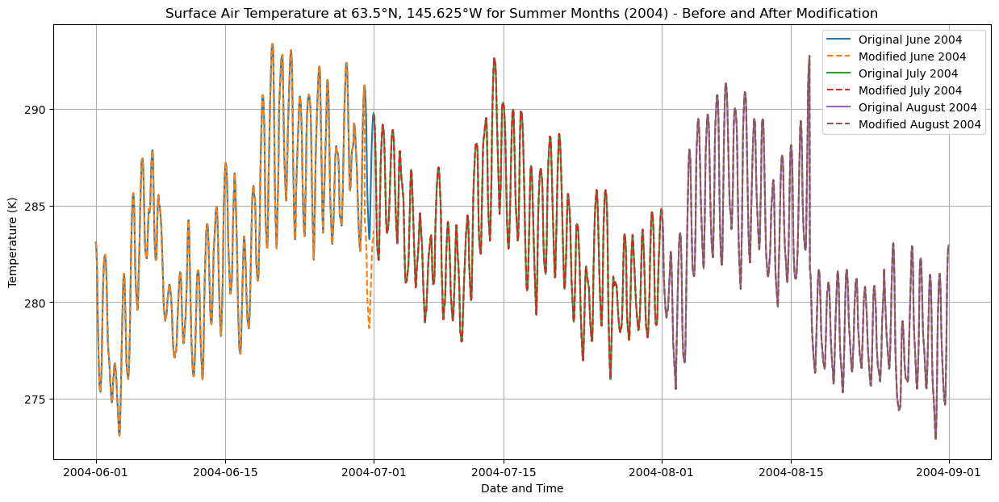

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_7_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_7_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_7_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_7_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_7_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_7_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_7_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_7_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/RH2M/MERRA2_RH2M_dur_7_end_sum_2004.nc
Modified dataset saved t

In [46]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-30', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_7_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon and convert time to pandas datetime
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter data for summer months
is_summer = t2m_point['time.month'].isin(summer_months)
summer_t2m = t2m_point.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m_point.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset and restructure
ds_modified = df_t2m_point.set_index(['time']).to_xarray()
unique_lats = np.unique(ds_modified['lat'].values)
unique_lons = np.unique(ds_modified['lon'].values)

lat_dim = xr.DataArray(unique_lats, dims='lat', name='lat')
lon_dim = xr.DataArray(unique_lons, dims='lon', name='lon')
reshaped_T2M = ds_modified['T2M'].values.reshape(len(ds_modified['time']), len(unique_lats), len(unique_lons))

ds_new_restructured = xr.Dataset(
    {'T2M': (['time', 'lat', 'lon'], reshaped_T2M)},
    coords={'time': ds_modified['time'], 'lat': lat_dim, 'lon': lon_dim}
)
ds_new_restructured['T2M'].attrs['units'] = 'K'
ds_new_restructured.to_netcdf(output_file_path)
print(f"Modified dataset saved to {output_file_path}")

# Plot the original and modified datasets for comparison
modified_years = [2004]
for year in modified_years:
    is_year = t2m_point['time.year'] == year
    ds_year = t2m_point.sel(time=is_year)
    ds_modified_year = ds_modified.sel(time=is_year)

    plt.figure(figsize=(15, 7))
    for month, month_name in zip(summer_months, ['June', 'July', 'August']):
        is_month = ds_year['time.month'] == month
        ds_month = ds_year.sel(time=is_month)
        ds_modified_month = ds_modified_year.sel(time=is_month)

        plt.plot(ds_month['time'], ds_month, label=f'Original {month_name} {year}')
        plt.plot(ds_modified_month['time'], ds_modified_month['T2M'], linestyle='--', label=f'Modified {month_name} {year}')

    plt.title(f'Surface Air Temperature at 63.5°N, 145.625°W for Summer Months ({year}) - Before and After Modification')
    plt.xlabel('Date and Time')
    plt.ylabel('Temperature (K)')
    plt.legend()
    plt.grid(True)
    plt.show()

# Process other variables and replace heatwave data with the replacement date data
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename)
    
    data_copy = data.copy()
    data_location = data_copy.sel(lat=lat, lon=lon, method='nearest')
    data_location['time'] = pd.to_datetime(data_location['time'].values)
    
    replacement_data = data_location.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data_location[var].loc[{'time': time_slice}] = replacement_data.values
    
    data_copy.loc[{'lat': lat, 'lon': lon}] = data_location
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_7_end_sum_2004.nc'
    data_copy.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")

In [22]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-24', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_8_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M'].sel(lat=lat, lon=lon, method='nearest')

# Convert time to pandas datetime
t2m['time'] = pd.to_datetime(t2m['time'].values)

# Filter data for summer months
is_summer = t2m['time.month'].isin(summer_months)
summer_t2m = t2m.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

# Save the modified dataset
ds_modified['T2M'].attrs['units'] = 'K'
ds_modified.to_netcdf(output_file_path)
ds_modified = ds_modified.assign_coords(lat=('time', ds_modified.lat.data), 
                                         lon=('time', ds_modified.lon.data))
print(f"Modified dataset saved to {output_file_path}")

# Plotting logic remains the same...
# (Include the plotting part here as necessary)

# Process other variables while selecting only the specified pixel
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename).sel(lat=lat, lon=lon, method='nearest')
    
    data['time'] = pd.to_datetime(data['time'].values)
    
    replacement_data = data.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data[var].loc[{'time': time_slice}] = replacement_data.values
    
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_8_end_sum_2004.nc'
    data.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_8_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_8_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_8_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_8_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_8_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_8_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_8_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_8_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_8_end_sum_2004.nc
Modified dataset saved to 

In [23]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-25', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_9_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M'].sel(lat=lat, lon=lon, method='nearest')

# Convert time to pandas datetime
t2m['time'] = pd.to_datetime(t2m['time'].values)

# Filter data for summer months
is_summer = t2m['time.month'].isin(summer_months)
summer_t2m = t2m.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

# Save the modified dataset
ds_modified['T2M'].attrs['units'] = 'K'
ds_modified.to_netcdf(output_file_path)
ds_modified = ds_modified.assign_coords(lat=('time', ds_modified.lat.data), 
                                         lon=('time', ds_modified.lon.data))
print(f"Modified dataset saved to {output_file_path}")

# Plotting logic remains the same...
# (Include the plotting part here as necessary)

# Process other variables while selecting only the specified pixel
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename).sel(lat=lat, lon=lon, method='nearest')
    
    data['time'] = pd.to_datetime(data['time'].values)
    
    replacement_data = data.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data[var].loc[{'time': time_slice}] = replacement_data.values
    
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_9_end_sum_2004.nc'
    data.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_9_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_9_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_9_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_9_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_9_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_9_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_9_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_9_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_9_end_sum_2004.nc
Modified dataset saved to 

In [24]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-26', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_10_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M'].sel(lat=lat, lon=lon, method='nearest')

# Convert time to pandas datetime
t2m['time'] = pd.to_datetime(t2m['time'].values)

# Filter data for summer months
is_summer = t2m['time.month'].isin(summer_months)
summer_t2m = t2m.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

# Save the modified dataset
ds_modified['T2M'].attrs['units'] = 'K'
ds_modified.to_netcdf(output_file_path)
ds_modified = ds_modified.assign_coords(lat=('time', ds_modified.lat.data), 
                                         lon=('time', ds_modified.lon.data))
print(f"Modified dataset saved to {output_file_path}")

# Plotting logic remains the same...
# (Include the plotting part here as necessary)

# Process other variables while selecting only the specified pixel
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename).sel(lat=lat, lon=lon, method='nearest')
    
    data['time'] = pd.to_datetime(data['time'].values)
    
    replacement_data = data.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data[var].loc[{'time': time_slice}] = replacement_data.values
    
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_10_end_sum_2004.nc'
    data.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_10_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_10_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_10_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_10_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_10_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_10_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_10_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_10_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_10_end_sum_2004.nc
Modified dataset 

In [25]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-27', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_11_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M'].sel(lat=lat, lon=lon, method='nearest')

# Convert time to pandas datetime
t2m['time'] = pd.to_datetime(t2m['time'].values)

# Filter data for summer months
is_summer = t2m['time.month'].isin(summer_months)
summer_t2m = t2m.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

# Save the modified dataset
ds_modified['T2M'].attrs['units'] = 'K'
ds_modified.to_netcdf(output_file_path)
ds_modified = ds_modified.assign_coords(lat=('time', ds_modified.lat.data), 
                                         lon=('time', ds_modified.lon.data))
print(f"Modified dataset saved to {output_file_path}")

# Plotting logic remains the same...
# (Include the plotting part here as necessary)

# Process other variables while selecting only the specified pixel
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename).sel(lat=lat, lon=lon, method='nearest')
    
    data['time'] = pd.to_datetime(data['time'].values)
    
    replacement_data = data.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data[var].loc[{'time': time_slice}] = replacement_data.values
    
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_11_end_sum_2004.nc'
    data.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_11_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_11_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_11_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_11_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_11_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_11_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_11_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_11_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_11_end_sum_2004.nc
Modified dataset 

In [26]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-28', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_12_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M'].sel(lat=lat, lon=lon, method='nearest')

# Convert time to pandas datetime
t2m['time'] = pd.to_datetime(t2m['time'].values)

# Filter data for summer months
is_summer = t2m['time.month'].isin(summer_months)
summer_t2m = t2m.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

# Save the modified dataset
ds_modified['T2M'].attrs['units'] = 'K'
ds_modified.to_netcdf(output_file_path)
ds_modified = ds_modified.assign_coords(lat=('time', ds_modified.lat.data), 
                                         lon=('time', ds_modified.lon.data))
print(f"Modified dataset saved to {output_file_path}")

# Plotting logic remains the same...
# (Include the plotting part here as necessary)

# Process other variables while selecting only the specified pixel
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename).sel(lat=lat, lon=lon, method='nearest')
    
    data['time'] = pd.to_datetime(data['time'].values)
    
    replacement_data = data.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data[var].loc[{'time': time_slice}] = replacement_data.values
    
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_12_end_sum_2004.nc'
    data.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_12_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_12_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_12_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_12_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_12_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_12_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_12_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_12_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_12_end_sum_2004.nc
Modified dataset 

In [27]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [('2004-06-29', '2004-06-30')]
file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_end_sum_2004.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_13_end_sum_2004.nc'

# Load dataset and select the T2M variable
ds_notsubset = xr.open_dataset(file_path)
t2m = ds_notsubset['T2M'].sel(lat=lat, lon=lon, method='nearest')

# Convert time to pandas datetime
t2m['time'] = pd.to_datetime(t2m['time'].values)

# Filter data for summer months
is_summer = t2m['time.month'].isin(summer_months)
summer_t2m = t2m.sel(time=is_summer)

# Convert to DataFrame for easier handling and calculate hourly median temperatures
df_summer_t2m = summer_t2m.to_dataframe().reset_index()
df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Replace heatwave days with the median temperature profile
df_t2m_point = t2m.to_dataframe().reset_index()
for start_date, end_date in heatwave_periods:
    start_datetime = pd.to_datetime(start_date)
    end_datetime = pd.to_datetime(end_date)
    year = start_datetime.year
    
    for date in pd.date_range(start_datetime, end_datetime):
        day_of_year = date.dayofyear
        for hour in range(24):
            mask = (df_t2m_point['time'].dt.year == year) & (df_t2m_point['time'].dt.dayofyear == day_of_year) & (df_t2m_point['time'].dt.hour == hour)
            median_temp = hourly_median_temps[(hourly_median_temps['day_of_year'] == day_of_year) & (hourly_median_temps['hour'] == hour)]['T2M'].values[0]
            df_t2m_point.loc[mask, 'T2M'] = median_temp

# Convert the modified DataFrame back to an xarray Dataset
ds_modified = df_t2m_point.set_index(['time']).to_xarray()

# Save the modified dataset
ds_modified['T2M'].attrs['units'] = 'K'
ds_modified.to_netcdf(output_file_path)
ds_modified = ds_modified.assign_coords(lat=('time', ds_modified.lat.data), 
                                         lon=('time', ds_modified.lon.data))
print(f"Modified dataset saved to {output_file_path}")

# Plotting logic remains the same...
# (Include the plotting part here as necessary)

# Process other variables while selecting only the specified pixel
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_end_sum_2004.nc'
    data = xr.open_dataset(filename).sel(lat=lat, lon=lon, method='nearest')
    
    data['time'] = pd.to_datetime(data['time'].values)
    
    replacement_data = data.sel(time=slice(f'{replacement_date} 00:30:00', f'{replacement_date} 23:30:00'))[var]
    
    for start_date, end_date in heatwave_periods:
        start_datetime = pd.to_datetime(start_date)
        end_datetime = pd.to_datetime(end_date)
        
        for date in pd.date_range(start_datetime, end_datetime):
            time_slice = slice(f'{date.strftime("%Y-%m-%d")} 00:30:00', f'{date.strftime("%Y-%m-%d")} 23:30:00')
            data[var].loc[{'time': time_slice}] = replacement_data.values
    
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_dur_13_end_sum_2004.nc'
    data.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")


Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_dur_13_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_dur_13_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_dur_13_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_dur_13_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_dur_13_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_dur_13_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_dur_13_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_dur_13_end_sum_2004.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_dur_13_end_sum_2004.nc
Modified dataset 

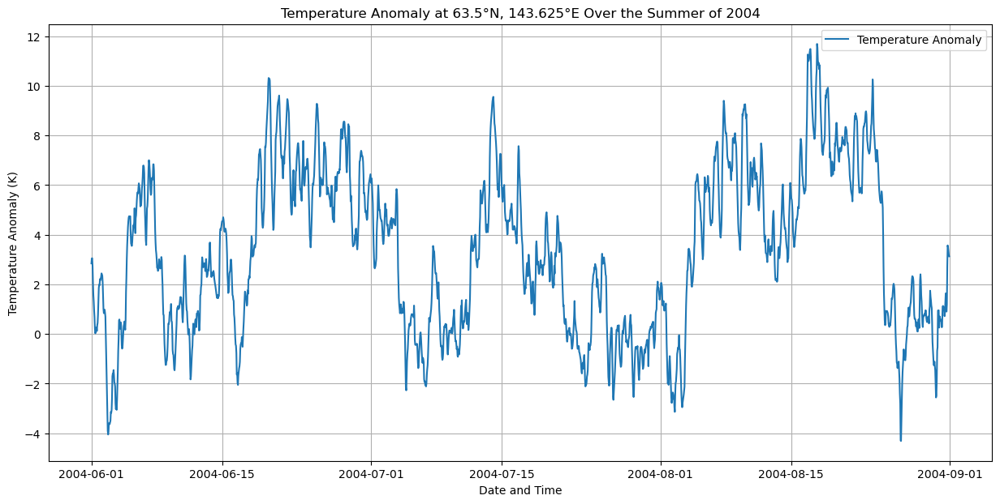

In [3]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2004, 2005, 2023]

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'

# Load the dataset
ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years for median calculation
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)

# Convert to DataFrame for easier handling
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()

# Calculate the median temperature for each hour of each day in the summer period
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear

# Group by day of the year and hour to get the median temperature
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

# Filter data for summer months in 2004
is_summer_2004 = (t2m_point['time.year'] == 2004) & (t2m_point['time.month'].isin(summer_months))
summer_t2m_2004 = t2m_point.sel(time=is_summer_2004)

# Convert to DataFrame for easier handling
df_summer_t2m_2004 = summer_t2m_2004.to_dataframe().reset_index()

# Add hour and day_of_year columns
df_summer_t2m_2004['hour'] = df_summer_t2m_2004['time'].dt.hour
df_summer_t2m_2004['day_of_year'] = df_summer_t2m_2004['time'].dt.dayofyear

# Merge the median temperatures with the 2004 DataFrame
df_summer_t2m_2004 = df_summer_t2m_2004.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))

# Calculate the temperature anomaly
df_summer_t2m_2004['temperature_anomaly'] = df_summer_t2m_2004['T2M'] - df_summer_t2m_2004['T2M_median']

# Convert back to datetime for plotting
# Assuming the year 2004 for creating datetime objects
df_summer_t2m_2004['time'] = pd.to_datetime('2004') + pd.to_timedelta(df_summer_t2m_2004['day_of_year'] - 1, unit='D') + pd.to_timedelta(df_summer_t2m_2004['hour'], unit='h')

# Plot the temperature anomaly for 2004 over the summer period
plt.figure(figsize=(15, 7))
plt.plot(df_summer_t2m_2004['time'], df_summer_t2m_2004['temperature_anomaly'], label='Temperature Anomaly')
plt.title('Temperature Anomaly at 63.5°N, 143.625°E Over the Summer of 2004')
plt.xlabel('Date and Time')
plt.ylabel('Temperature Anomaly (K)')
plt.legend()
plt.grid(True)
plt.show()


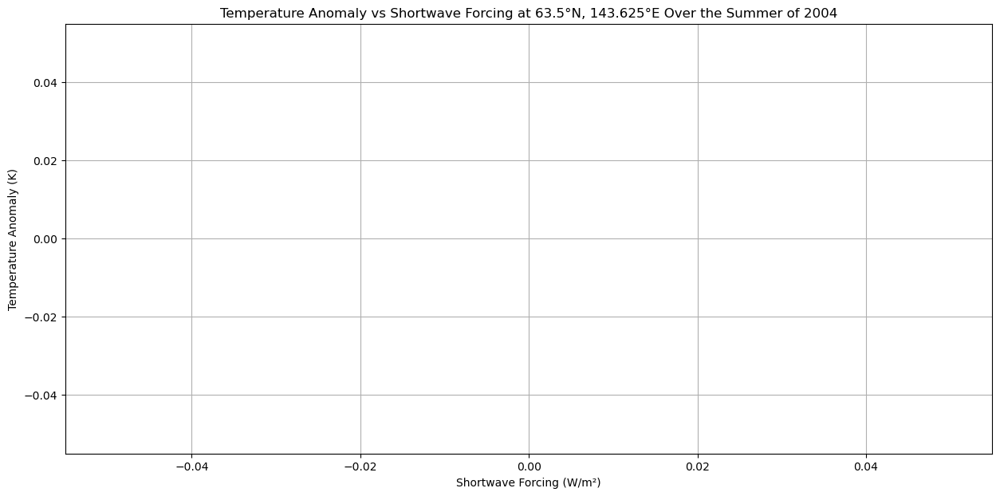

In [7]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2004, 2005, 2006, 2007, 2023]

temp_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
shortwave_file_path = '/Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_SWGDN_60_-150.nc'

# Load the temperature dataset
ds_temp = xr.open_dataset(temp_file_path)
t2m = ds_temp['T2M']
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()
is_summer_2004 = (t2m_point['time.year'] == 2004) & (t2m_point['time.month'].isin(summer_months))
summer_t2m_2004 = t2m_point.sel(time=is_summer_2004)
df_summer_t2m_2004 = summer_t2m_2004.to_dataframe().reset_index()
df_summer_t2m_2004['hour'] = df_summer_t2m_2004['time'].dt.hour
df_summer_t2m_2004['day_of_year'] = df_summer_t2m_2004['time'].dt.dayofyear
df_summer_t2m_2004 = df_summer_t2m_2004.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))
df_summer_t2m_2004['temperature_anomaly'] = df_summer_t2m_2004['T2M'] - df_summer_t2m_2004['T2M_median']
df_summer_t2m_2004['time'] = pd.to_datetime('2004') + pd.to_timedelta(df_summer_t2m_2004['day_of_year'] - 1, unit='D') + pd.to_timedelta(df_summer_t2m_2004['hour'], unit='h')

# Load the shortwave forcing dataset
ds_sw = xr.open_dataset(shortwave_file_path)
sw = ds_sw['SWGDN']
sw_point = sw.sel(lat=lat, lon=lon, method='nearest')
sw_point['time'] = pd.to_datetime(sw_point['time'].values)
is_summer_sw_2004 = (sw_point['time.year'] == 2004) & (sw_point['time.month'].isin(summer_months))
summer_sw_2004 = sw_point.sel(time=is_summer_sw_2004)
df_summer_sw_2004 = summer_sw_2004.to_dataframe().reset_index()
df_summer_sw_2004['hour'] = df_summer_sw_2004['time'].dt.hour
df_summer_sw_2004['day_of_year'] = df_summer_sw_2004['time'].dt.dayofyear

# Merge temperature anomaly and shortwave forcing data
df_summer_2004 = df_summer_t2m_2004.merge(df_summer_sw_2004, on=['time', 'lat', 'lon', 'hour', 'day_of_year'])

# Plot the temperature anomaly vs shortwave forcing
plt.figure(figsize=(15, 7))
plt.scatter(df_summer_2004['SWGDN'], df_summer_2004['temperature_anomaly'], alpha=0.5)
plt.title('Temperature Anomaly vs Shortwave Forcing at 63.5°N, 143.625°E Over the Summer of 2004')
plt.xlabel('Shortwave Forcing (W/m²)')
plt.ylabel('Temperature Anomaly (K)')
plt.grid(True)
plt.show()


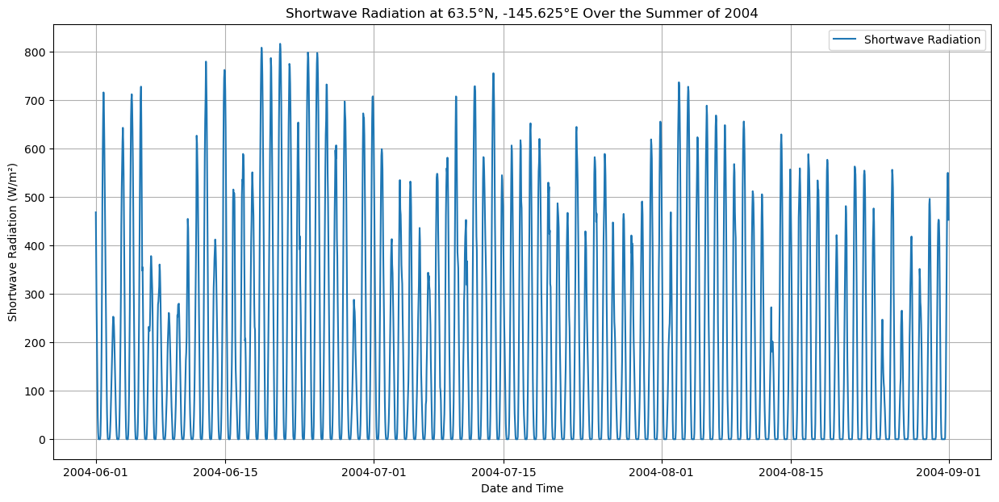

In [8]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]

shortwave_file_path = '/Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_SWGDN_60_-150.nc'

# Load the shortwave forcing dataset
ds_sw = xr.open_dataset(shortwave_file_path)
sw = ds_sw['SWGDN']
sw_point = sw.sel(lat=lat, lon=lon, method='nearest')
sw_point['time'] = pd.to_datetime(sw_point['time'].values)

# Filter data for summer months in 2004
is_summer_sw_2004 = (sw_point['time.year'] == 2004) & (sw_point['time.month'].isin(summer_months))
summer_sw_2004 = sw_point.sel(time=is_summer_sw_2004)

# Convert to DataFrame for easier handling
df_summer_sw_2004 = summer_sw_2004.to_dataframe().reset_index()

# Plot the shortwave radiation for the summer of 2004
plt.figure(figsize=(15, 7))
plt.plot(df_summer_sw_2004['time'], df_summer_sw_2004['SWGDN'], label='Shortwave Radiation')
plt.title('Shortwave Radiation at 63.5°N, -145.625°E Over the Summer of 2004')
plt.xlabel('Date and Time')
plt.ylabel('Shortwave Radiation (W/m²)')
plt.legend()
plt.grid(True)
plt.show()


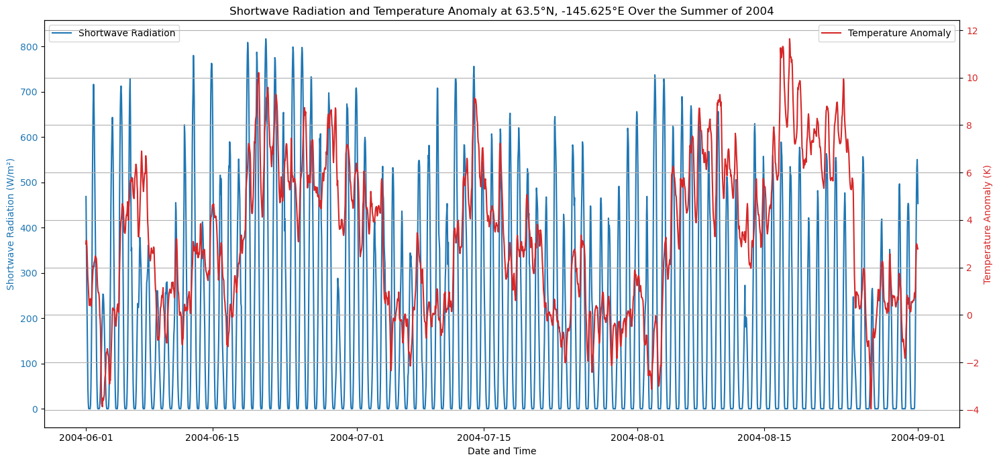

In [9]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2005, 2006, 2007, 2023]

temp_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
shortwave_file_path = '/Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_SWGDN_60_-150.nc'

# Load the temperature dataset
ds_temp = xr.open_dataset(temp_file_path)
t2m = ds_temp['T2M']
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years for median calculation
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)

# Convert to DataFrame for easier handling
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear

# Group by day of the year and hour to get the median temperature
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

# Filter data for summer months in 2004
is_summer_2004 = (t2m_point['time.year'] == 2004) & (t2m_point['time.month'].isin(summer_months))
summer_t2m_2004 = t2m_point.sel(time=is_summer_2004)

# Convert to DataFrame for easier handling
df_summer_t2m_2004 = summer_t2m_2004.to_dataframe().reset_index()
df_summer_t2m_2004['hour'] = df_summer_t2m_2004['time'].dt.hour
df_summer_t2m_2004['day_of_year'] = df_summer_t2m_2004['time'].dt.dayofyear

# Merge the median temperatures with the 2004 DataFrame
df_summer_t2m_2004 = df_summer_t2m_2004.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))

# Calculate the temperature anomaly
df_summer_t2m_2004['temperature_anomaly'] = df_summer_t2m_2004['T2M'] - df_summer_t2m_2004['T2M_median']

# Convert back to datetime for plotting
df_summer_t2m_2004['time'] = pd.to_datetime('2004') + pd.to_timedelta(df_summer_t2m_2004['day_of_year'] - 1, unit='D') + pd.to_timedelta(df_summer_t2m_2004['hour'], unit='h')

# Load the shortwave forcing dataset
ds_sw = xr.open_dataset(shortwave_file_path)
sw = ds_sw['SWGDN']
sw_point = sw.sel(lat=lat, lon=lon, method='nearest')
sw_point['time'] = pd.to_datetime(sw_point['time'].values)

# Filter data for summer months in 2004
is_summer_sw_2004 = (sw_point['time.year'] == 2004) & (sw_point['time.month'].isin(summer_months))
summer_sw_2004 = sw_point.sel(time=is_summer_sw_2004)

# Convert to DataFrame for easier handling
df_summer_sw_2004 = summer_sw_2004.to_dataframe().reset_index()

# Plot the shortwave radiation and temperature anomaly on the same plot
fig, ax1 = plt.subplots(figsize=(15, 7))

ax1.plot(df_summer_sw_2004['time'], df_summer_sw_2004['SWGDN'], label='Shortwave Radiation', color='tab:blue')
ax1.set_xlabel('Date and Time')
ax1.set_ylabel('Shortwave Radiation (W/m²)', color='tab:blue')
ax1.tick_params(axis='y', labelcolor='tab:blue')
ax1.legend(loc='upper left')

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.plot(df_summer_t2m_2004['time'], df_summer_t2m_2004['temperature_anomaly'], label='Temperature Anomaly', color='tab:red')
ax2.set_ylabel('Temperature Anomaly (K)', color='tab:red')  # we already handled the x-label with ax1
ax2.tick_params(axis='y', labelcolor='tab:red')
ax2.legend(loc='upper right')

plt.title('Shortwave Radiation and Temperature Anomaly at 63.5°N, -145.625°E Over the Summer of 2004')
fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.grid(True)
plt.show()


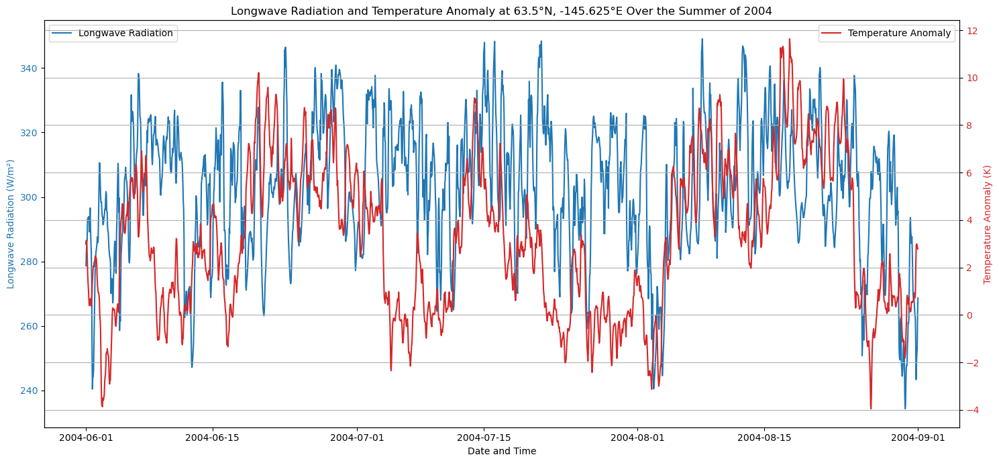

In [10]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2005, 2006, 2007, 2023]

temp_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
longwave_file_path = '/Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_60_-150.nc'

# Load the temperature dataset
ds_temp = xr.open_dataset(temp_file_path)
t2m = ds_temp['T2M']
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years for median calculation
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)

# Convert to DataFrame for easier handling
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear

# Group by day of the year and hour to get the median temperature
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

# Filter data for summer months in 2004
is_summer_2004 = (t2m_point['time.year'] == 2004) & (t2m_point['time.month'].isin(summer_months))
summer_t2m_2004 = t2m_point.sel(time=is_summer_2004)

# Convert to DataFrame for easier handling
df_summer_t2m_2004 = summer_t2m_2004.to_dataframe().reset_index()
df_summer_t2m_2004['hour'] = df_summer_t2m_2004['time'].dt.hour
df_summer_t2m_2004['day_of_year'] = df_summer_t2m_2004['time'].dt.dayofyear

# Merge the median temperatures with the 2004 DataFrame
df_summer_t2m_2004 = df_summer_t2m_2004.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))

# Calculate the temperature anomaly
df_summer_t2m_2004['temperature_anomaly'] = df_summer_t2m_2004['T2M'] - df_summer_t2m_2004['T2M_median']

# Convert back to datetime for plotting
df_summer_t2m_2004['time'] = pd.to_datetime('2004') + pd.to_timedelta(df_summer_t2m_2004['day_of_year'] - 1, unit='D') + pd.to_timedelta(df_summer_t2m_2004['hour'], unit='h')

# Load the longwave forcing dataset
ds_lw = xr.open_dataset(longwave_file_path)
lw = ds_lw['LWGAB']
lw_point = lw.sel(lat=lat, lon=lon, method='nearest')
lw_point['time'] = pd.to_datetime(lw_point['time'].values)

# Filter data for summer months in 2004
is_summer_lw_2004 = (lw_point['time.year'] == 2004) & (lw_point['time.month'].isin(summer_months))
summer_lw_2004 = lw_point.sel(time=is_summer_lw_2004)

# Convert to DataFrame for easier handling
df_summer_lw_2004 = summer_lw_2004.to_dataframe().reset_index()

# Plot the longwave radiation and temperature anomaly on the same plot
fig, ax1 = plt.subplots(figsize=(15, 7))

ax1.plot(df_summer_lw_2004['time'], df_summer_lw_2004['LWGAB'], label='Longwave Radiation', color='tab:blue')
ax1.set_xlabel('Date and Time')
ax1.set_ylabel('Longwave Radiation (W/m²)', color='tab:blue')
ax1.tick_params(axis='y', labelcolor='tab:blue')
ax1.legend(loc='upper left')

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.plot(df_summer_t2m_2004['time'], df_summer_t2m_2004['temperature_anomaly'], label='Temperature Anomaly', color='tab:red')
ax2.set_ylabel('Temperature Anomaly (K)', color='tab:red')  # we already handled the x-label with ax1
ax2.tick_params(axis='y', labelcolor='tab:red')
ax2.legend(loc='upper right')

plt.title('Longwave Radiation and Temperature Anomaly at 63.5°N, -145.625°E Over the Summer of 2004')
fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.grid(True)
plt.show()


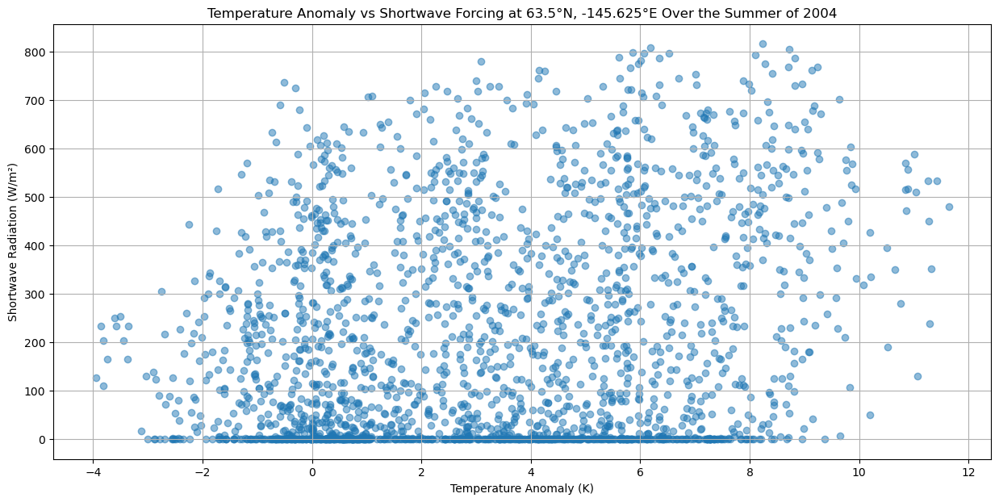

In [21]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2005, 2006, 2007, 2023]

temp_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
shortwave_file_path = '/Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_SWGDN_60_-150.nc'

# Load the temperature dataset
ds_temp = xr.open_dataset(temp_file_path)
t2m = ds_temp['T2M']
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years for median calculation
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)

# Convert to DataFrame for easier handling
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear

# Group by day of the year and hour to get the median temperature
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

# Filter data for summer months in 2004
is_summer_2004 = (t2m_point['time.year'] == 2004) & (t2m_point['time.month'].isin(summer_months))
summer_t2m_2004 = t2m_point.sel(time=is_summer_2004)

# Convert to DataFrame for easier handling
df_summer_t2m_2004 = summer_t2m_2004.to_dataframe().reset_index()
df_summer_t2m_2004['hour'] = df_summer_t2m_2004['time'].dt.hour
df_summer_t2m_2004['day_of_year'] = df_summer_t2m_2004['time'].dt.dayofyear

# Merge the median temperatures with the 2004 DataFrame
df_summer_t2m_2004 = df_summer_t2m_2004.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))

# Calculate the temperature anomaly
df_summer_t2m_2004['temperature_anomaly'] = df_summer_t2m_2004['T2M'] - df_summer_t2m_2004['T2M_median']

# Convert back to datetime for plotting
df_summer_t2m_2004['time'] = pd.to_datetime('2004') + pd.to_timedelta(df_summer_t2m_2004['day_of_year'] - 1, unit='D') + pd.to_timedelta(df_summer_t2m_2004['hour'], unit='h')

# Load the shortwave forcing dataset
ds_sw = xr.open_dataset(shortwave_file_path)
sw = ds_sw['SWGDN']
sw_point = sw.sel(lat=lat, lon=lon, method='nearest')
sw_point['time'] = pd.to_datetime(sw_point['time'].values)

# Filter data for summer months in 2004
is_summer_sw_2004 = (sw_point['time.year'] == 2004) & (sw_point['time.month'].isin(summer_months))
summer_sw_2004 = sw_point.sel(time=is_summer_sw_2004)

# Convert to DataFrame for easier handling
df_summer_sw_2004 = summer_sw_2004.to_dataframe().reset_index()

# Plot the temperature anomaly vs shortwave forcing
plt.figure(figsize=(15, 7))
plt.scatter(df_summer_t2m_2004['temperature_anomaly'], df_summer_sw_2004['SWGDN'], alpha=0.5, color='tab:blue')
plt.title('Temperature Anomaly vs Shortwave Forcing at 63.5°N, -145.625°E Over the Summer of 2004')
plt.xlabel('Temperature Anomaly (K)')
plt.ylabel('Shortwave Radiation (W/m²)')
plt.grid(True)
plt.show()


Empty DataFrame
Columns: [temperature_anomaly, SWGDN]
Index: []


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/2143248825.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/2143248825.py:78: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_sw_2004['time'] = df_summer_sw_2004['time'].dt.round('H')


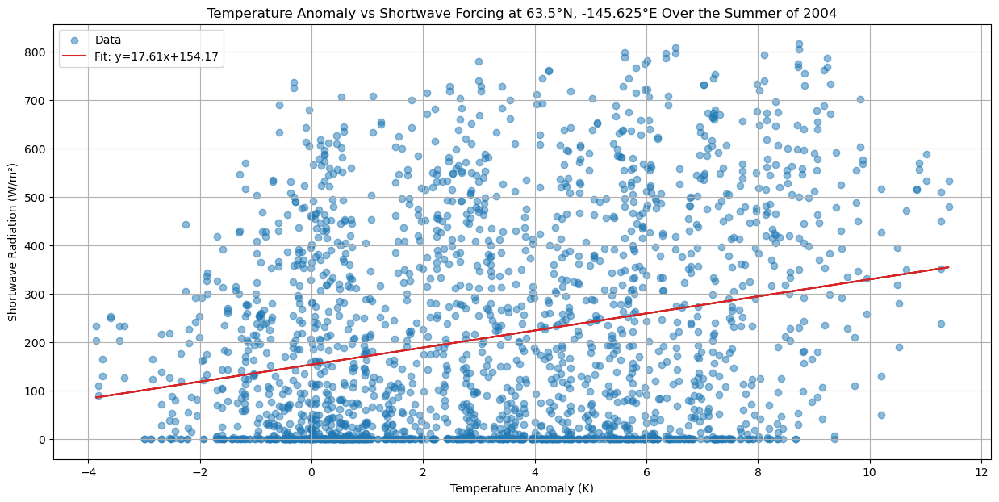

In [28]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import linregress

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2005, 2006, 2007, 2023]

temp_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
shortwave_file_path = '/Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_SWGDN_60_-150.nc'

# Load the temperature dataset
ds_temp = xr.open_dataset(temp_file_path)
t2m = ds_temp['T2M']
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years for median calculation
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)

# Convert to DataFrame for easier handling
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear

# Group by day of the year and hour to get the median temperature
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

# Filter data for summer months in 2004
is_summer_2004 = (t2m_point['time.year'] == 2004) & (t2m_point['time.month'].isin(summer_months))
summer_t2m_2004 = t2m_point.sel(time=is_summer_2004)

# Convert to DataFrame for easier handling
df_summer_t2m_2004 = summer_t2m_2004.to_dataframe().reset_index()
df_summer_t2m_2004['hour'] = df_summer_t2m_2004['time'].dt.hour
df_summer_t2m_2004['day_of_year'] = df_summer_t2m_2004['time'].dt.dayofyear

# Merge the median temperatures with the 2004 DataFrame
df_summer_t2m_2004 = df_summer_t2m_2004.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))

# Calculate the temperature anomaly
df_summer_t2m_2004['temperature_anomaly'] = df_summer_t2m_2004['T2M'] - df_summer_t2m_2004['T2M_median']

# Convert back to datetime for plotting
df_summer_t2m_2004['time'] = pd.to_datetime('2004') + pd.to_timedelta(df_summer_t2m_2004['day_of_year'] - 1, unit='D') + pd.to_timedelta(df_summer_t2m_2004['hour'], unit='h')

# Load the shortwave forcing dataset
ds_sw = xr.open_dataset(shortwave_file_path)
sw = ds_sw['SWGDN']
sw_point = sw.sel(lat=lat, lon=lon, method='nearest')
sw_point['time'] = pd.to_datetime(sw_point['time'].values)

# Filter data for summer months in 2004
is_summer_sw_2004 = (sw_point['time.year'] == 2004) & (sw_point['time.month'].isin(summer_months))
summer_sw_2004 = sw_point.sel(time=is_summer_sw_2004)

# Convert to DataFrame for easier handling
df_summer_sw_2004 = summer_sw_2004.to_dataframe().reset_index()

# Ensure both DataFrames have the same time format and overlap
df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.tz_localize(None)
df_summer_sw_2004['time'] = df_summer_sw_2004['time'].dt.tz_localize(None)

# Merge temperature anomaly with shortwave data
df_combined = pd.merge(df_summer_t2m_2004, df_summer_sw_2004, on='time', how='inner')
print(df_combined[['temperature_anomaly', 'SWGDN']].head())  # Check the combined data

# Round the timestamps to the nearest hour
df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
df_summer_sw_2004['time'] = df_summer_sw_2004['time'].dt.round('H')

# Merge temperature anomaly with shortwave data
df_combined = pd.merge(df_summer_t2m_2004, df_summer_sw_2004, on='time', how='inner')

# Perform linear regression
if not df_combined.empty:
    slope, intercept, r_value, p_value, std_err = linregress(df_combined['temperature_anomaly'], df_combined['SWGDN'])

    # Plot the temperature anomaly vs shortwave forcing with regression line
    plt.figure(figsize=(15, 7))
    plt.scatter(df_combined['temperature_anomaly'], df_combined['SWGDN'], alpha=0.5, color='tab:blue', label='Data')
    plt.plot(df_combined['temperature_anomaly'], intercept + slope * df_combined['temperature_anomaly'], color='tab:red', label=f'Fit: y={slope:.2f}x+{intercept:.2f}')
    plt.title('Temperature Anomaly vs Shortwave Forcing at 63.5°N, -145.625°E Over the Summer of 2004')
    plt.xlabel('Temperature Anomaly (K)')
    plt.ylabel('Shortwave Radiation (W/m²)')
    plt.legend()
    plt.grid(True)
    plt.show()
else:
    print("No data available for regression.")


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/2030517692.py:73: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/2030517692.py:74: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_sw_2004['time'] = df_summer_sw_2004['time'].dt.round('H')


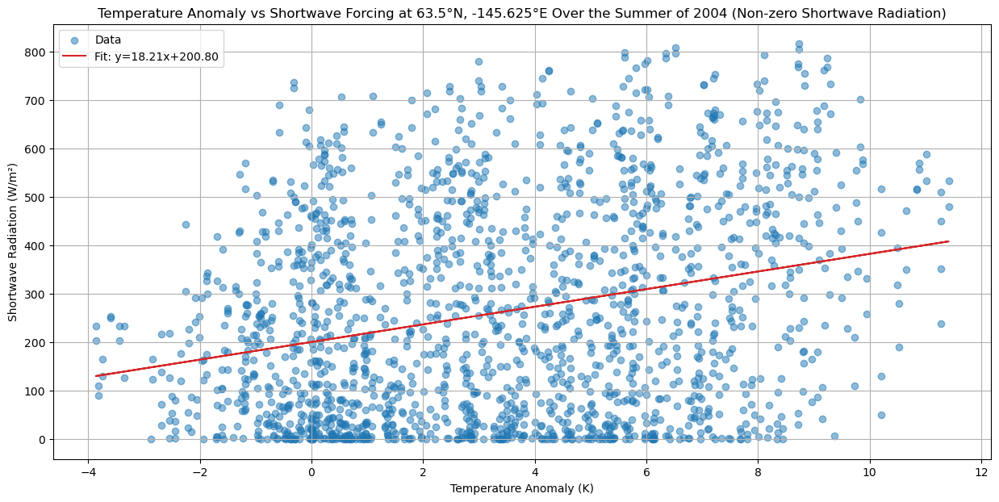

R-squared value: 0.07


In [30]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import linregress

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2005, 2006, 2007, 2023]

temp_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
shortwave_file_path = '/Users/manda/REU24/climate_data/MERRA2/SWGDN/MERRA2_SWGDN_60_-150.nc'

# Load the temperature dataset
ds_temp = xr.open_dataset(temp_file_path)
t2m = ds_temp['T2M']
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years for median calculation
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)

# Convert to DataFrame for easier handling
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear

# Group by day of the year and hour to get the median temperature
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

# Filter data for summer months in 2004
is_summer_2004 = (t2m_point['time.year'] == 2004) & (t2m_point['time.month'].isin(summer_months))
summer_t2m_2004 = t2m_point.sel(time=is_summer_2004)

# Convert to DataFrame for easier handling
df_summer_t2m_2004 = summer_t2m_2004.to_dataframe().reset_index()
df_summer_t2m_2004['hour'] = df_summer_t2m_2004['time'].dt.hour
df_summer_t2m_2004['day_of_year'] = df_summer_t2m_2004['time'].dt.dayofyear

# Merge the median temperatures with the 2004 DataFrame
df_summer_t2m_2004 = df_summer_t2m_2004.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))

# Calculate the temperature anomaly
df_summer_t2m_2004['temperature_anomaly'] = df_summer_t2m_2004['T2M'] - df_summer_t2m_2004['T2M_median']

# Convert back to datetime for plotting
df_summer_t2m_2004['time'] = pd.to_datetime('2004') + pd.to_timedelta(df_summer_t2m_2004['day_of_year'] - 1, unit='D') + pd.to_timedelta(df_summer_t2m_2004['hour'], unit='h')

# Load the shortwave forcing dataset
ds_sw = xr.open_dataset(shortwave_file_path)
sw = ds_sw['SWGDN']
sw_point = sw.sel(lat=lat, lon=lon, method='nearest')
sw_point['time'] = pd.to_datetime(sw_point['time'].values)

# Filter data for summer months in 2004
is_summer_sw_2004 = (sw_point['time.year'] == 2004) & (sw_point['time.month'].isin(summer_months))
summer_sw_2004 = sw_point.sel(time=is_summer_sw_2004)

# Convert to DataFrame for easier handling
df_summer_sw_2004 = summer_sw_2004.to_dataframe().reset_index()

# Ensure both DataFrames have the same time format and overlap
df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.tz_localize(None)
df_summer_sw_2004['time'] = df_summer_sw_2004['time'].dt.tz_localize(None)

# Round the timestamps to the nearest hour
df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
df_summer_sw_2004['time'] = df_summer_sw_2004['time'].dt.round('H')

# Merge temperature anomaly with shortwave data
df_combined = pd.merge(df_summer_t2m_2004, df_summer_sw_2004, on='time', how='inner')

# Exclude points where shortwave radiation is zero
df_combined_nonzero_sw = df_combined[df_combined['SWGDN'] > 0]

# Perform linear regression
if not df_combined_nonzero_sw.empty:
    slope, intercept, r_value, p_value, std_err = linregress(df_combined_nonzero_sw['temperature_anomaly'], df_combined_nonzero_sw['SWGDN'])
    r_squared = r_value**2

    # Plot the temperature anomaly vs shortwave forcing with regression line
    plt.figure(figsize=(15, 7))
    plt.scatter(df_combined_nonzero_sw['temperature_anomaly'], df_combined_nonzero_sw['SWGDN'], alpha=0.5, color='tab:blue', label='Data')
    plt.plot(df_combined_nonzero_sw['temperature_anomaly'], intercept + slope * df_combined_nonzero_sw['temperature_anomaly'], color='tab:red', label=f'Fit: y={slope:.2f}x+{intercept:.2f}')
    plt.title('Temperature Anomaly vs Shortwave Forcing at 63.5°N, -145.625°E Over the Summer of 2004 (Non-zero Shortwave Radiation)')
    plt.xlabel('Temperature Anomaly (K)')
    plt.ylabel('Shortwave Radiation (W/m²)')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    print(f"R-squared value: {r_squared:.2f}")
else:
    print("No data available for regression after excluding zero shortwave radiation.")


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/1510479366.py:73: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/1510479366.py:74: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_lw_2004['time'] = df_summer_lw_2004['time'].dt.round('H')


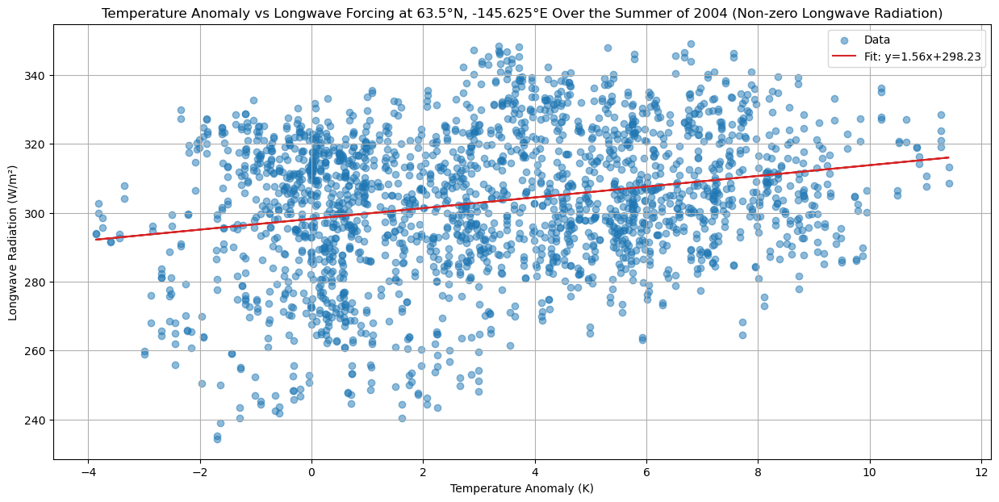

R-squared value: 0.06


In [31]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import linregress

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2005, 2006, 2007, 2023]

temp_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
longwave_file_path = '/Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_60_-150.nc'

# Load the temperature dataset
ds_temp = xr.open_dataset(temp_file_path)
t2m = ds_temp['T2M']
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years for median calculation
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)

# Convert to DataFrame for easier handling
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear

# Group by day of the year and hour to get the median temperature
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

# Filter data for summer months in 2004
is_summer_2004 = (t2m_point['time.year'] == 2004) & (t2m_point['time.month'].isin(summer_months))
summer_t2m_2004 = t2m_point.sel(time=is_summer_2004)

# Convert to DataFrame for easier handling
df_summer_t2m_2004 = summer_t2m_2004.to_dataframe().reset_index()
df_summer_t2m_2004['hour'] = df_summer_t2m_2004['time'].dt.hour
df_summer_t2m_2004['day_of_year'] = df_summer_t2m_2004['time'].dt.dayofyear

# Merge the median temperatures with the 2004 DataFrame
df_summer_t2m_2004 = df_summer_t2m_2004.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))

# Calculate the temperature anomaly
df_summer_t2m_2004['temperature_anomaly'] = df_summer_t2m_2004['T2M'] - df_summer_t2m_2004['T2M_median']

# Convert back to datetime for plotting
df_summer_t2m_2004['time'] = pd.to_datetime('2004') + pd.to_timedelta(df_summer_t2m_2004['day_of_year'] - 1, unit='D') + pd.to_timedelta(df_summer_t2m_2004['hour'], unit='h')

# Load the longwave forcing dataset
ds_lw = xr.open_dataset(longwave_file_path)
lw = ds_lw['LWGAB']
lw_point = lw.sel(lat=lat, lon=lon, method='nearest')
lw_point['time'] = pd.to_datetime(lw_point['time'].values)

# Filter data for summer months in 2004
is_summer_lw_2004 = (lw_point['time.year'] == 2004) & (lw_point['time.month'].isin(summer_months))
summer_lw_2004 = lw_point.sel(time=is_summer_lw_2004)

# Convert to DataFrame for easier handling
df_summer_lw_2004 = summer_lw_2004.to_dataframe().reset_index()

# Ensure both DataFrames have the same time format and overlap
df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.tz_localize(None)
df_summer_lw_2004['time'] = df_summer_lw_2004['time'].dt.tz_localize(None)

# Round the timestamps to the nearest hour
df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
df_summer_lw_2004['time'] = df_summer_lw_2004['time'].dt.round('H')

# Merge temperature anomaly with longwave data
df_combined_lw = pd.merge(df_summer_t2m_2004, df_summer_lw_2004, on='time', how='inner')

# Exclude points where longwave radiation is zero
df_combined_lw_nonzero = df_combined_lw[df_combined_lw['LWGAB'] > 0]

# Perform linear regression
if not df_combined_lw_nonzero.empty:
    slope, intercept, r_value, p_value, std_err = linregress(df_combined_lw_nonzero['temperature_anomaly'], df_combined_lw_nonzero['LWGAB'])
    r_squared = r_value**2

    # Plot the temperature anomaly vs longwave forcing with regression line
    plt.figure(figsize=(15, 7))
    plt.scatter(df_combined_lw_nonzero['temperature_anomaly'], df_combined_lw_nonzero['LWGAB'], alpha=0.5, color='tab:blue', label='Data')
    plt.plot(df_combined_lw_nonzero['temperature_anomaly'], intercept + slope * df_combined_lw_nonzero['temperature_anomaly'], color='tab:red', label=f'Fit: y={slope:.2f}x+{intercept:.2f}')
    plt.title('Temperature Anomaly vs Longwave Forcing at 63.5°N, -145.625°E Over the Summer of 2004 (Non-zero Longwave Radiation)')
    plt.xlabel('Temperature Anomaly (K)')
    plt.ylabel('Longwave Radiation (W/m²)')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    print(f"R-squared value: {r_squared:.2f}")
else:
    print("No data available for regression after excluding zero longwave radiation.")


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:76: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')


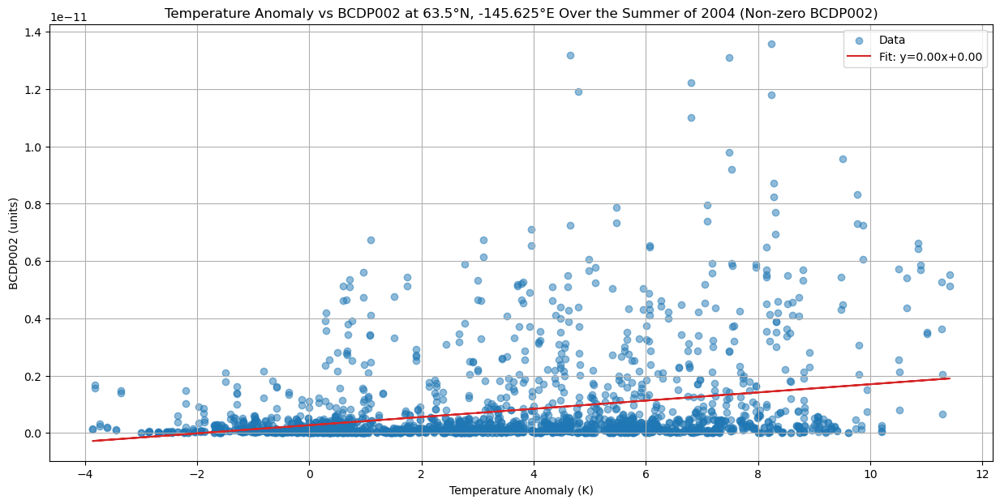

BCDP002 - R-squared value: 0.09


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:76: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')


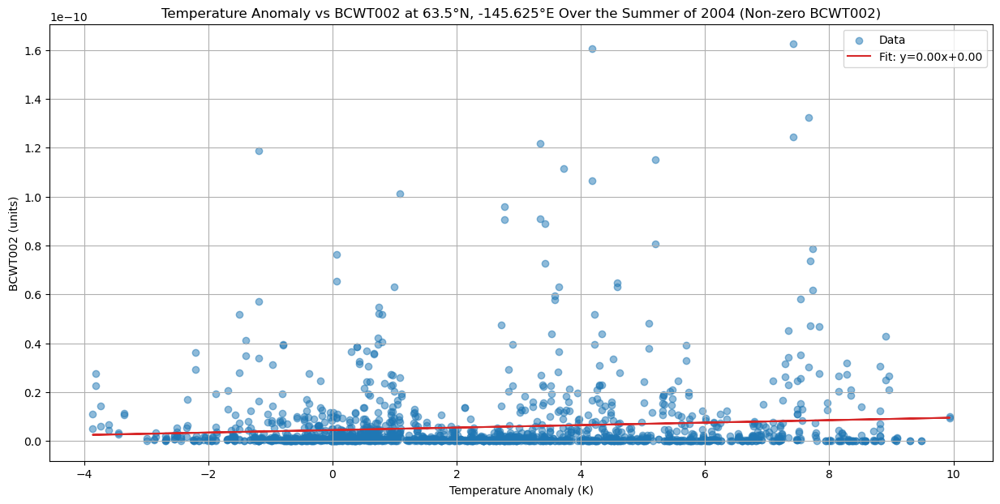

BCWT002 - R-squared value: 0.01


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:76: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')


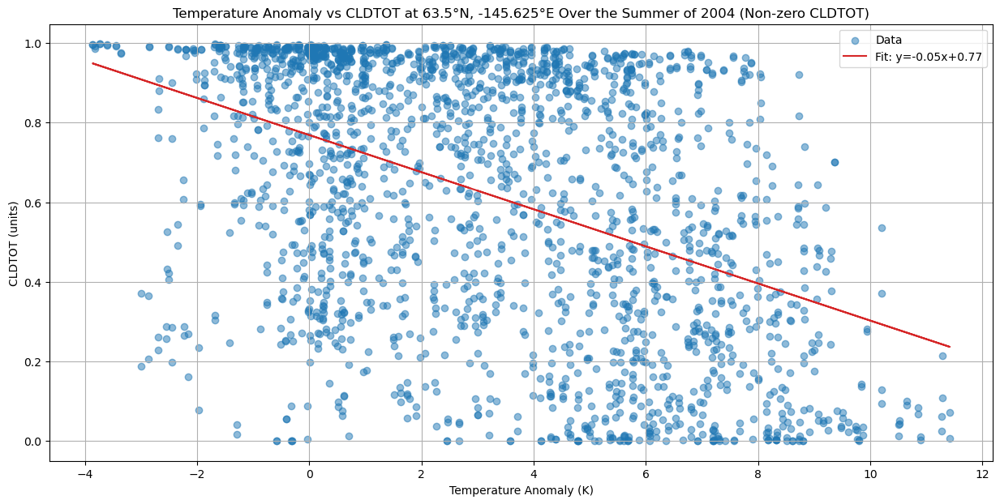

CLDTOT - R-squared value: 0.20


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:76: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')


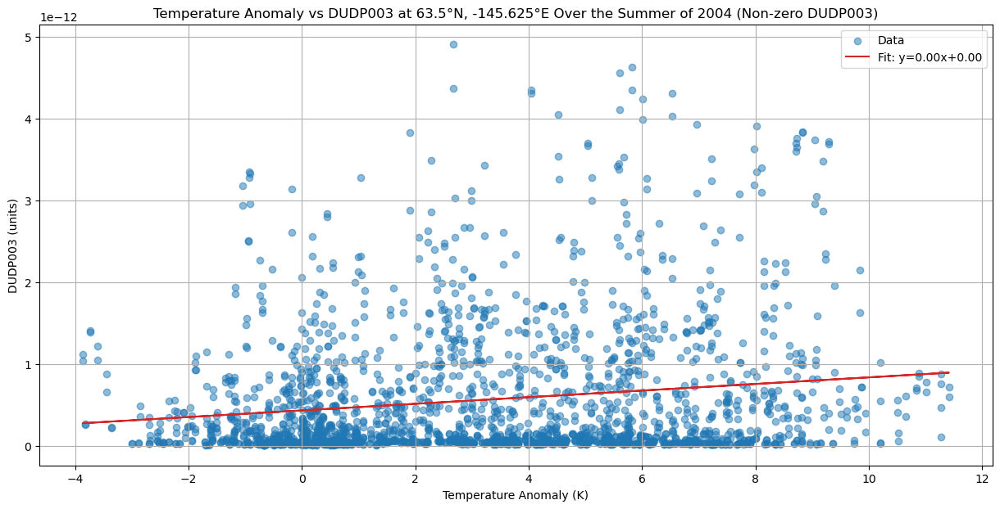

DUDP003 - R-squared value: 0.03


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:76: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')


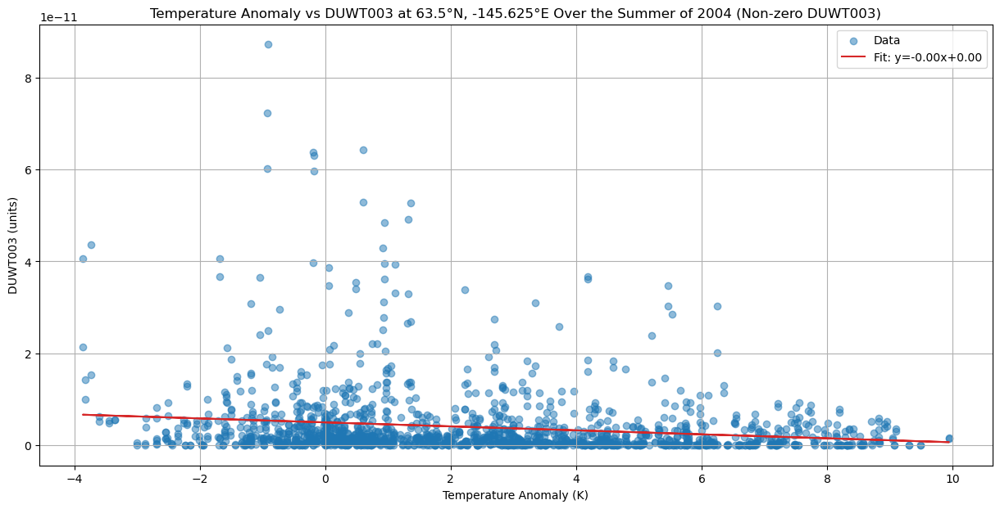

DUWT003 - R-squared value: 0.03


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:76: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')


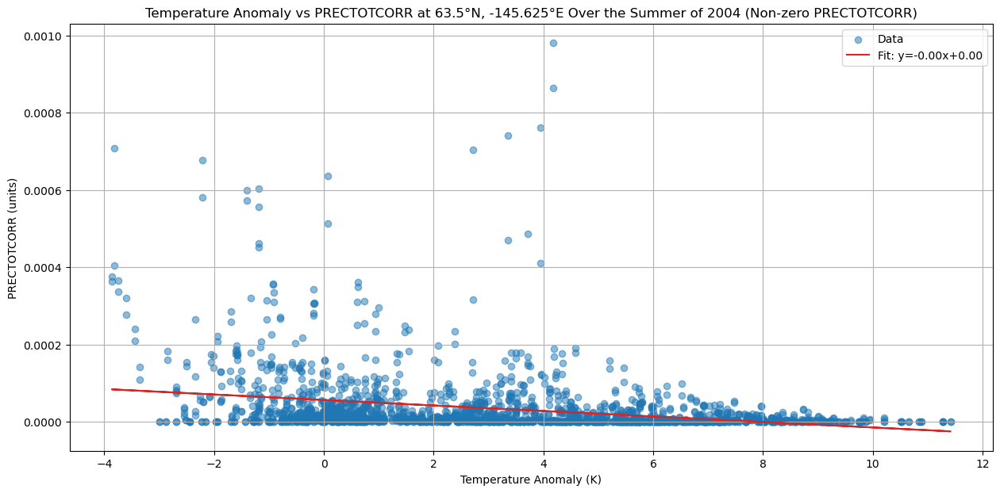

PRECTOTCORR - R-squared value: 0.08


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:76: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')


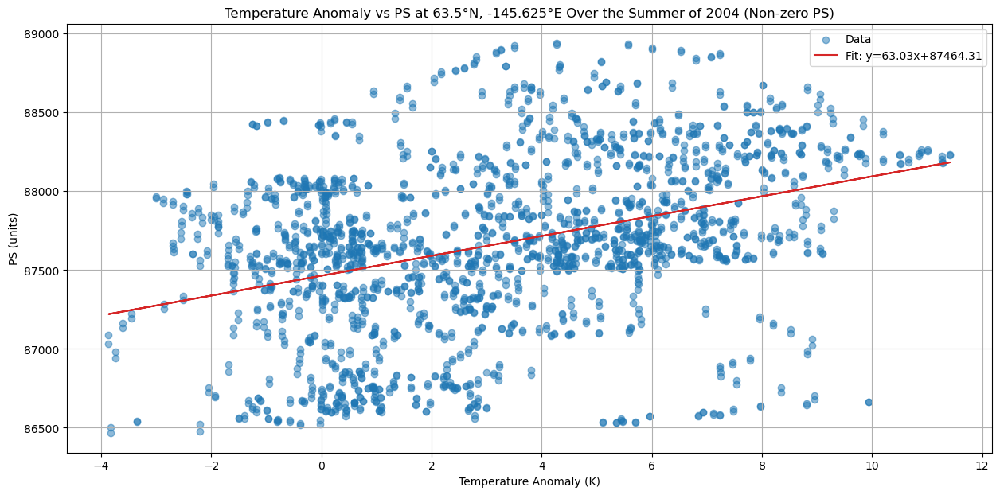

PS - R-squared value: 0.14


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:76: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')


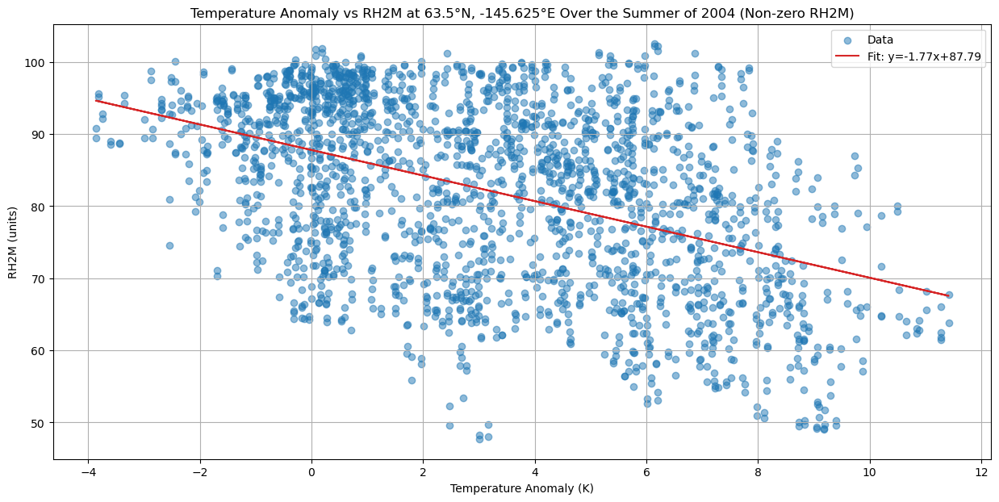

RH2M - R-squared value: 0.20


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:76: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')


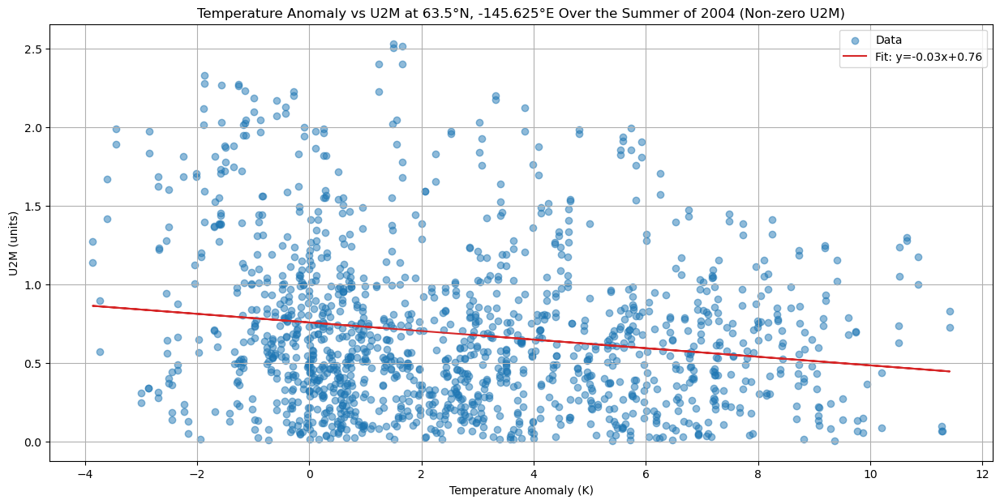

U2M - R-squared value: 0.03


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:76: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_12729/763537696.py:77: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')


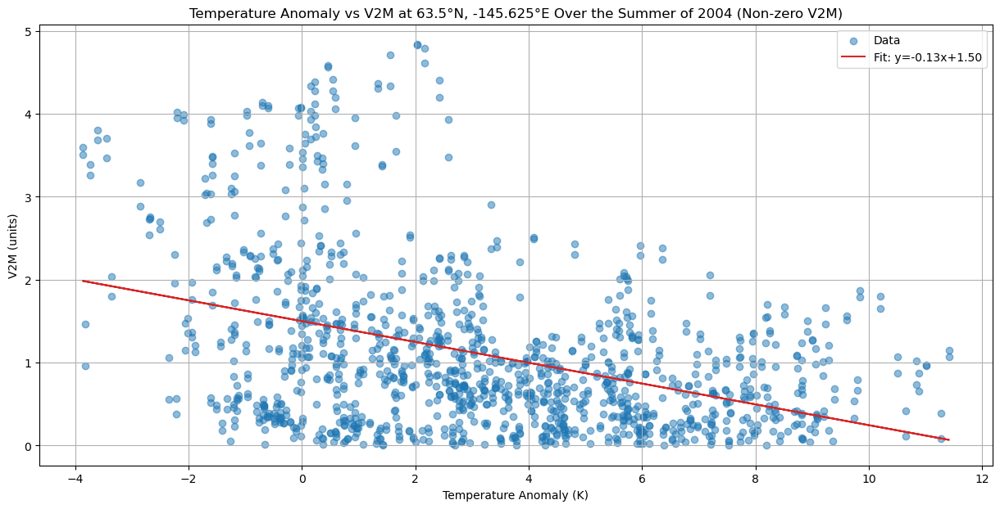

V2M - R-squared value: 0.16


In [33]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import linregress

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2005, 2006, 2007, 2023]

temp_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
variables = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'PRECTOTCORR', 'PS', 'RH2M', 'U2M', 'V2M']

# Load the temperature dataset
ds_temp = xr.open_dataset(temp_file_path)
t2m = ds_temp['T2M']
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years for median calculation
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)

# Convert to DataFrame for easier handling
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear

# Group by day of the year and hour to get the median temperature
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

# Filter data for summer months in 2004
is_summer_2004 = (t2m_point['time.year'] == 2004) & (t2m_point['time.month'].isin(summer_months))
summer_t2m_2004 = t2m_point.sel(time=is_summer_2004)

# Convert to DataFrame for easier handling
df_summer_t2m_2004 = summer_t2m_2004.to_dataframe().reset_index()
df_summer_t2m_2004['hour'] = df_summer_t2m_2004['time'].dt.hour
df_summer_t2m_2004['day_of_year'] = df_summer_t2m_2004['time'].dt.dayofyear

# Merge the median temperatures with the 2004 DataFrame
df_summer_t2m_2004 = df_summer_t2m_2004.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))

# Calculate the temperature anomaly
df_summer_t2m_2004['temperature_anomaly'] = df_summer_t2m_2004['T2M'] - df_summer_t2m_2004['T2M_median']

# Convert back to datetime for plotting
df_summer_t2m_2004['time'] = pd.to_datetime('2004') + pd.to_timedelta(df_summer_t2m_2004['day_of_year'] - 1, unit='D') + pd.to_timedelta(df_summer_t2m_2004['hour'], unit='h')

# Process each variable
for var in variables:
    # Load the dataset for the variable
    file_path = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_60_-150.nc'
    ds_var = xr.open_dataset(file_path)
    data_var = ds_var[var]
    data_point = data_var.sel(lat=lat, lon=lon, method='nearest')
    data_point['time'] = pd.to_datetime(data_point['time'].values)

    # Filter data for summer months in 2004
    is_summer_var_2004 = (data_point['time.year'] == 2004) & (data_point['time.month'].isin(summer_months))
    summer_var_2004 = data_point.sel(time=is_summer_var_2004)

    # Convert to DataFrame for easier handling
    df_summer_var_2004 = summer_var_2004.to_dataframe().reset_index()

    # Ensure both DataFrames have the same time format and overlap
    df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.tz_localize(None)
    df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.tz_localize(None)

    # Round the timestamps to the nearest hour
    df_summer_t2m_2004['time'] = df_summer_t2m_2004['time'].dt.round('H')
    df_summer_var_2004['time'] = df_summer_var_2004['time'].dt.round('H')

    # Merge temperature anomaly with the variable data
    df_combined_var = pd.merge(df_summer_t2m_2004, df_summer_var_2004, on='time', how='inner')

    # Exclude points where the variable data is zero
    df_combined_var_nonzero = df_combined_var[df_combined_var[var] > 0]

    # Perform linear regression
    if not df_combined_var_nonzero.empty:
        slope, intercept, r_value, p_value, std_err = linregress(df_combined_var_nonzero['temperature_anomaly'], df_combined_var_nonzero[var])
        r_squared = r_value**2

        # Plot the temperature anomaly vs the variable with regression line
        plt.figure(figsize=(15, 7))
        plt.scatter(df_combined_var_nonzero['temperature_anomaly'], df_combined_var_nonzero[var], alpha=0.5, color='tab:blue', label='Data')
        plt.plot(df_combined_var_nonzero['temperature_anomaly'], intercept + slope * df_combined_var_nonzero['temperature_anomaly'], color='tab:red', label=f'Fit: y={slope:.2f}x+{intercept:.2f}')
        plt.title(f'Temperature Anomaly vs {var} at 63.5°N, -145.625°E Over the Summer of 2004 (Non-zero {var})')
        plt.xlabel('Temperature Anomaly (K)')
        plt.ylabel(f'{var} (units)')
        plt.legend()
        plt.grid(True)
        plt.show()
        
        print(f"{var} - R-squared value: {r_squared:.2f}")
    else:
        print(f"{var} - No data available for regression after excluding zero values.")


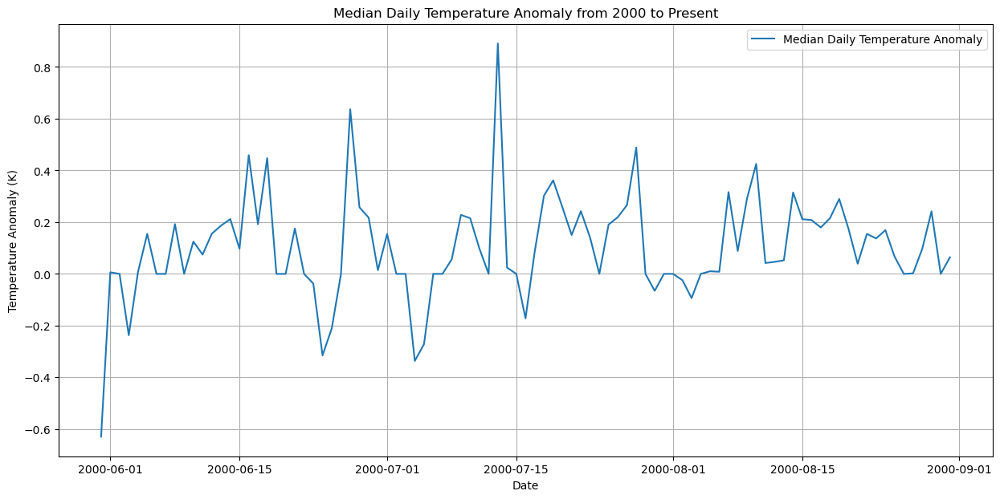

In [37]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2004, 2005, 2006, 2007, 2023]
start_year = 2000
end_year = 2024  # Adjust to your needs

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'

# Load the dataset
ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)

# Convert to DataFrame for easier handling
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()

# Add hour and day_of_year columns
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear

# Calculate the median temperature for each hour of each day in the summer period
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

# Initialize a list to store daily temperature anomalies
daily_anomalies = []

# Process each year from start_year to end_year
for year in range(start_year, end_year):
    # Filter data for the given year and summer months
    is_summer_year = (t2m_point['time.year'] == year) & (t2m_point['time.month'].isin(summer_months))
    summer_t2m_year = t2m_point.sel(time=is_summer_year)

    # Convert to DataFrame for easier handling
    df_summer_t2m_year = summer_t2m_year.to_dataframe().reset_index()

    # Add hour and day_of_year columns
    df_summer_t2m_year['hour'] = df_summer_t2m_year['time'].dt.hour
    df_summer_t2m_year['day_of_year'] = df_summer_t2m_year['time'].dt.dayofyear

    # Merge the median temperatures with the yearly DataFrame
    df_summer_t2m_year = df_summer_t2m_year.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))

    # Calculate the temperature anomaly
    df_summer_t2m_year['temperature_anomaly'] = df_summer_t2m_year['T2M'] - df_summer_t2m_year['T2M_median']

    # Append daily anomalies
    daily_anomalies.append(df_summer_t2m_year[['day_of_year', 'temperature_anomaly']])

# Concatenate all daily anomalies into a single DataFrame
df_all_anomalies = pd.concat(daily_anomalies)

# Calculate the median temperature anomaly for each day across all years
median_daily_anomalies = df_all_anomalies.groupby('day_of_year')['temperature_anomaly'].median().reset_index()

# Convert back to datetime for plotting
median_daily_anomalies['date'] = pd.to_datetime('2000') + pd.to_timedelta(median_daily_anomalies['day_of_year'] - 1, unit='D')

# Plot the median temperature anomaly for each day
plt.figure(figsize=(15, 7))
plt.plot(median_daily_anomalies['date'], median_daily_anomalies['temperature_anomaly'], label='Median Daily Temperature Anomaly')
plt.title('Median Daily Temperature Anomaly from 2000 to Present')
plt.xlabel('Date')
plt.ylabel('Temperature Anomaly (K)')
plt.legend()
plt.grid(True)
plt.show()


The summer with the temperature anomaly that matches the median the best is: 2016


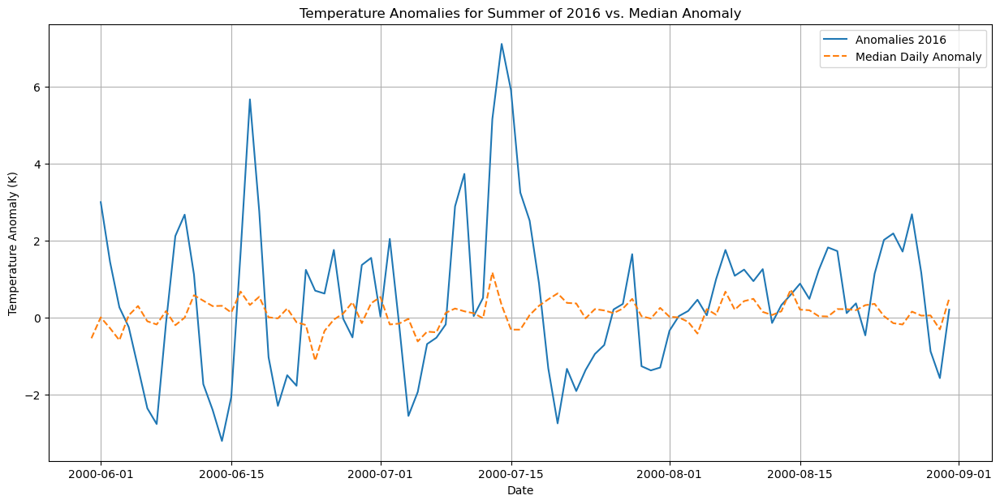

In [38]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Define the coordinates and file path
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
exclude_years = [2004, 2005, 2006, 2007, 2023]
start_year = 2000
end_year = 2024  # Adjust to your needs

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'

# Load the dataset
ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter out the heatwave years
is_not_heatwave_year = ~t2m_point['time.year'].isin(exclude_years)
t2m_point_excl = t2m_point.sel(time=is_not_heatwave_year)

# Filter data for summer months
is_summer_excl = t2m_point_excl['time.month'].isin(summer_months)
summer_t2m_excl = t2m_point_excl.sel(time=is_summer_excl)

# Convert to DataFrame for easier handling
df_summer_t2m_excl = summer_t2m_excl.to_dataframe().reset_index()

# Add hour and day_of_year columns
df_summer_t2m_excl['hour'] = df_summer_t2m_excl['time'].dt.hour
df_summer_t2m_excl['day_of_year'] = df_summer_t2m_excl['time'].dt.dayofyear

# Calculate the median temperature for each hour of each day in the summer period
hourly_median_temps = df_summer_t2m_excl.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

# Initialize a DataFrame to store the deviation from median for each summer
deviation_data = []

# Process each year from start_year to end_year
for year in range(start_year, end_year):
    # Filter data for the given year and summer months
    is_summer_year = (t2m_point['time.year'] == year) & (t2m_point['time.month'].isin(summer_months))
    summer_t2m_year = t2m_point.sel(time=is_summer_year)

    # Convert to DataFrame for easier handling
    df_summer_t2m_year = summer_t2m_year.to_dataframe().reset_index()

    # Add hour and day_of_year columns
    df_summer_t2m_year['hour'] = df_summer_t2m_year['time'].dt.hour
    df_summer_t2m_year['day_of_year'] = df_summer_t2m_year['time'].dt.dayofyear

    # Merge the median temperatures with the yearly DataFrame
    df_summer_t2m_year = df_summer_t2m_year.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))

    # Calculate the temperature anomaly
    df_summer_t2m_year['temperature_anomaly'] = df_summer_t2m_year['T2M'] - df_summer_t2m_year['T2M_median']

    # Calculate the daily average anomaly
    daily_anomaly = df_summer_t2m_year.groupby('day_of_year')['temperature_anomaly'].mean().reset_index()
    daily_anomaly['year'] = year

    # Append the daily anomalies to the list
    deviation_data.append(daily_anomaly)

# Concatenate all daily anomalies into a single DataFrame
df_all_anomalies = pd.concat(deviation_data)

# Calculate the median temperature anomaly for each day across all years
median_daily_anomalies = df_all_anomalies.groupby('day_of_year')['temperature_anomaly'].median().reset_index()

# Compute the deviation of each summer from the median
def calculate_deviation(yearly_anomalies, median_anomalies):
    merged = yearly_anomalies.merge(median_anomalies, on='day_of_year', suffixes=('', '_median'))
    deviation = np.abs(merged['temperature_anomaly'] - merged['temperature_anomaly_median']).sum()
    return deviation

# Find the summer with the smallest deviation from the median
best_match_year = None
best_match_deviation = float('inf')

for year in range(start_year, end_year):
    yearly_anomalies = df_all_anomalies[df_all_anomalies['year'] == year]
    deviation = calculate_deviation(yearly_anomalies, median_daily_anomalies)
    
    if deviation < best_match_deviation:
        best_match_deviation = deviation
        best_match_year = year

print(f"The summer with the temperature anomaly that matches the median the best is: {best_match_year}")

# Optional: Plotting the anomalies for the best match year
best_match_anomalies = df_all_anomalies[df_all_anomalies['year'] == best_match_year]
best_match_anomalies = best_match_anomalies.merge(median_daily_anomalies, on='day_of_year', suffixes=('', '_median'))

plt.figure(figsize=(15, 7))
plt.plot(pd.to_datetime('2000') + pd.to_timedelta(best_match_anomalies['day_of_year'] - 1, unit='D'),
         best_match_anomalies['temperature_anomaly'], label=f'Anomalies {best_match_year}')
plt.plot(pd.to_datetime('2000') + pd.to_timedelta(median_daily_anomalies['day_of_year'] - 1, unit='D'),
         median_daily_anomalies['temperature_anomaly'], label='Median Daily Anomaly', linestyle='--')
plt.title(f'Temperature Anomalies for Summer of {best_match_year} vs. Median Anomaly')
plt.xlabel('Date')
plt.ylabel('Temperature Anomaly (K)')
plt.legend()
plt.grid(True)
plt.show()


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_28299/3174174526.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_heatwave['hour'] = df_heatwave['time'].dt.hour
/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_28299/3174174526.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_heatwave['day_of_year'] = df_heatwave['time'].dt.dayofyear


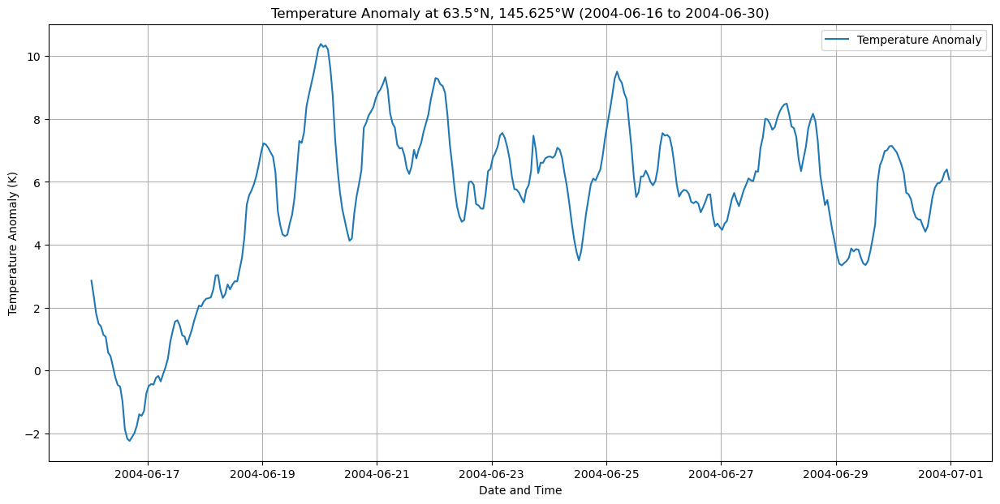

In [68]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file path
lat = 63.5
lon = -145.625
summer_months = [6, 7, 8]
heatwave_periods = [
    ('2004-06-16', '2004-06-30'),
    ('2004-08-17', '2004-08-24'),
    ('2005-06-09', '2005-06-14'),
    ('2005-08-10', '2005-08-16'),
    ('2006-06-10', '2006-06-15'),
    ('2007-08-26', '2007-08-31'),
    ('2023-07-23', '2023-07-29')
]

file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'
output_csv_path = '/Users/manda/REU24/Output/MERRA2_processing/heatwave_anomalies.csv'

# Load the dataset
ds_notsubset = xr.open_dataset(file_path)

# Select the T2M variable
t2m = ds_notsubset['T2M']

# Select the nearest point to the given lat/lon
t2m_point = t2m.sel(lat=lat, lon=lon, method='nearest')

# Convert the time dimension to pandas datetime
t2m_point['time'] = pd.to_datetime(t2m_point['time'].values)

# Filter data for summer months
is_summer = t2m_point['time.month'].isin(summer_months)
summer_t2m = t2m_point.sel(time=is_summer)

# Convert to DataFrame for easier handling
df_summer_t2m = summer_t2m.to_dataframe().reset_index()

df_summer_t2m['hour'] = df_summer_t2m['time'].dt.hour
df_summer_t2m['day_of_year'] = df_summer_t2m['time'].dt.dayofyear

hourly_median_temps = df_summer_t2m.groupby(['day_of_year', 'hour'])['T2M'].median().reset_index()

hourly_median_temps['time'] = pd.to_datetime('2000') + pd.to_timedelta(hourly_median_temps['day_of_year'] - 1, unit='D') + pd.to_timedelta(hourly_median_temps['hour'], unit='h')

# Filter data for the heatwave period
start_date = '2004-06-16T00:30:00'
end_date = '2004-06-30T23:30:00'

mask = (df_summer_t2m['time'] >= start_date) & (df_summer_t2m['time'] <= end_date)
df_heatwave = df_summer_t2m[mask]

# Calculate the temperature anomaly for the heatwave period
df_heatwave['hour'] = df_heatwave['time'].dt.hour
df_heatwave['day_of_year'] = df_heatwave['time'].dt.dayofyear

df_heatwave = df_heatwave.merge(hourly_median_temps, on=['day_of_year', 'hour'], suffixes=('', '_median'))
df_heatwave['temperature_anomaly'] = df_heatwave['T2M'] - df_heatwave['T2M_median']

# Convert back to datetime for plotting
df_heatwave['datetime'] = df_heatwave['time']
df_heatwave.to_csv(output_csv_path, index=False)

# Plot the temperature anomaly for the heatwave period
plt.figure(figsize=(15, 7))
plt.plot(df_heatwave['datetime'], df_heatwave['temperature_anomaly'], label='Temperature Anomaly')
plt.title('Temperature Anomaly at 63.5°N, 145.625°W (2004-06-16 to 2004-06-30)')
plt.xlabel('Date and Time')
plt.ylabel('Temperature Anomaly (K)')
plt.legend()
plt.grid(True)
plt.show()

In [131]:
import xarray as xr
import pandas as pd
import numpy as np

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
heatwave_period = ('2004-05-01T00:30:00', '2004-05-13T23:30:00')  # Example new heatwave period
original_heatwave_period = ('2004-06-16T00:30:00', '2004-06-30T23:30:00')  # Original period of heatwave
input_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave.nc'
output_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave_with_anomaly.nc'
csv_path = '/Users/manda/REU24/Output/MERRA2_processing/heatwave_anomalies.csv'

# Load the dataset to be modified
ds_modify = xr.open_dataset(input_file_path)

# Select the T2M variable for the dataset to be modified
t2m_modify = ds_modify['T2M']

# Load precomputed temperature anomalies
df_heatwave = pd.read_csv(csv_path)

# Convert CSV datetime to pandas datetime
df_heatwave['datetime'] = pd.to_datetime(df_heatwave['datetime'])

# Define the heatwave start and end dates for the new period
heatwave_start = pd.to_datetime(heatwave_period[0])
heatwave_end = pd.to_datetime(heatwave_period[1])

# Define the original heatwave start and end dates
original_heatwave_start = pd.to_datetime(original_heatwave_period[0])
original_heatwave_end = pd.to_datetime(original_heatwave_period[1])

# Calculate the offset between the original and new heatwave periods
original_period_days = (original_heatwave_end - original_heatwave_start).days
new_period_days = (heatwave_end - heatwave_start).days

# Create a mask for the new heatwave period
mask_time_range = (t2m_modify['time'] >= heatwave_start) & (t2m_modify['time'] <= heatwave_end)

# Extract the subset of the data for the new heatwave period
t2m_subset = t2m_modify.sel(time=slice(heatwave_start, heatwave_end))

# Ensure the anomalies are aligned with the original heatwave period
anomaly_data = df_heatwave.set_index('datetime').reindex(pd.date_range(start=original_heatwave_start, end=original_heatwave_end, freq='H'))['temperature_anomaly'].values

# Handle any potential NaNs
if np.any(np.isnan(anomaly_data)):
    print("Warning: NaNs detected in anomaly data")

# Adjust the anomalies to the new period
anomaly_data_expanded = np.tile(anomaly_data, int(np.ceil(new_period_days / original_period_days)))[:len(t2m_subset.time)]
anomaly_data_expanded = anomaly_data_expanded.reshape(-1, 1, 1)  # Expand dimensions to match (time, lat, lon)

# Add the temperature anomalies to the subset
t2m_subset.values += anomaly_data_expanded

# Update the original dataset with the modified values
ds_modify['T2M'].loc[dict(time=slice(heatwave_start, heatwave_end))] = t2m_subset

unique_lats = np.unique(ds_modify['lat'].values)
unique_lons = np.unique(ds_modify['lon'].values)

lat_dim = xr.DataArray(unique_lats, dims='lat', name='lat')
lon_dim = xr.DataArray(unique_lons, dims='lon', name='lon')
reshaped_T2M = ds_modify['T2M'].values.reshape(len(ds_modify['time']), len(unique_lats), len(unique_lons))

ds_new_restructured = xr.Dataset(
    {'T2M': (['time', 'lat', 'lon'], reshaped_T2M)},
    coords={'time': ds_modify['time'], 'lat': lat_dim, 'lon': lon_dim}
)
ds_new_restructured['T2M'].attrs['units'] = 'K'

# Save the modified dataset
ds_modify.to_netcdf(output_file_path)


/var/folders/rx/xkkczlh53n733bz1yn18f8zr0000gn/T/ipykernel_28299/3237739950.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  anomaly_data = df_heatwave.set_index('datetime').reindex(pd.date_range(start=original_heatwave_start, end=original_heatwave_end, freq='H'))['temperature_anomaly'].values


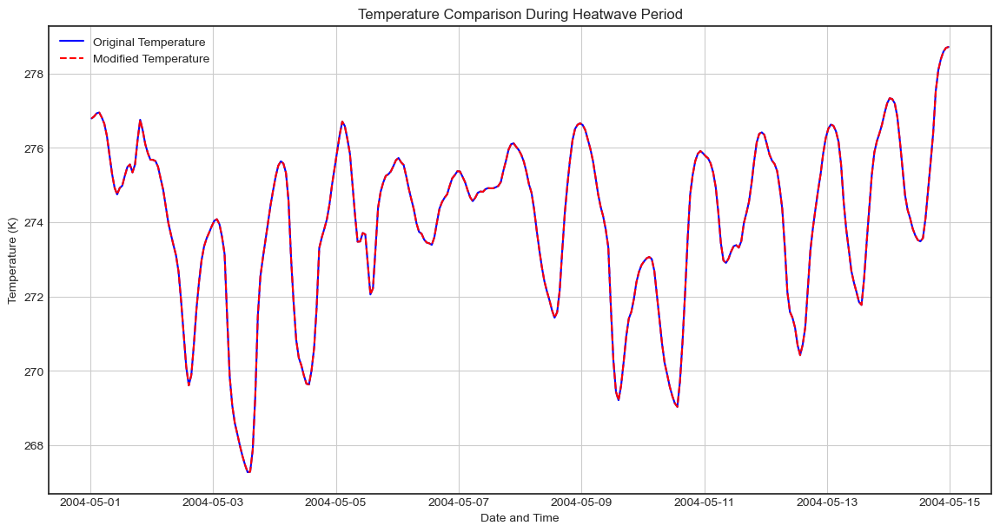

In [127]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
heatwave_period = ('2004-05-01T00:30:00', '2004-05-14T23:30:00')  # Example heatwave period
input_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave.nc'
modified_file_path = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave_with_anomaly.nc'

# Load the original dataset
ds_original = xr.open_dataset(input_file_path)
t2m_original = ds_original['T2M']

# Load the modified dataset
ds_modified = xr.open_dataset(modified_file_path)
t2m_modified = ds_modified['T2M']

# Convert the time dimension to pandas datetime for easier filtering
t2m_original['time'] = pd.to_datetime(t2m_original['time'].values)
t2m_modified['time'] = pd.to_datetime(t2m_modified['time'].values)

# Define the heatwave start and end dates
heatwave_start = pd.to_datetime(heatwave_period[0])
heatwave_end = pd.to_datetime(heatwave_period[1])

# Extract the time period for comparison
t2m_original_subset = t2m_original.sel(time=slice(heatwave_start, heatwave_end)).sel(lat=lat, lon=lon, method='nearest')
t2m_modified_subset = t2m_modified.sel(time=slice(heatwave_start, heatwave_end)).sel(lat=lat, lon=lon, method='nearest')

# Convert to pandas DataFrames for plotting
df_original = t2m_original_subset.to_dataframe().reset_index()
df_modified = t2m_modified_subset.to_dataframe().reset_index()

# Plot the original and modified temperatures
plt.figure(figsize=(14, 7))

plt.plot(df_original['time'], df_original['T2M'], label='Original Temperature', color='blue')
plt.plot(df_modified['time'], df_modified['T2M'], label='Modified Temperature', color='red', linestyle='--')

plt.title('Temperature Comparison During Heatwave Period')
plt.xlabel('Date and Time')
plt.ylabel('Temperature (K)')
plt.legend()
plt.grid(True)
plt.show()


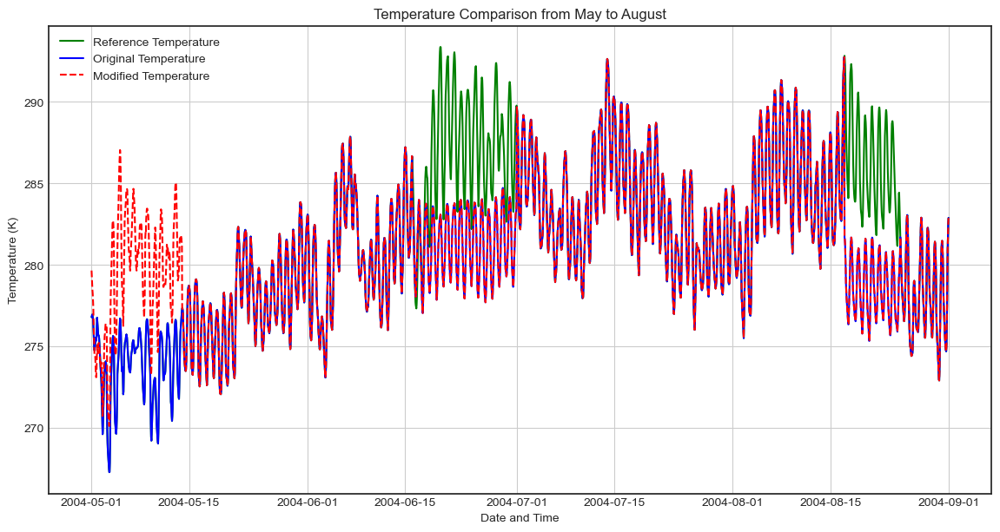

In [132]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625
start_date = '2004-05-01T00:00:00'
end_date = '2004-08-31T23:00:00'
input_file_path_original = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave.nc'
input_file_path_modified = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_no_heatwave_with_anomaly.nc'
input_file_path_reference = '/Users/manda/REU24/climate_data/MERRA2/T2M/MERRA2_T2M_60_-150.nc'

# Load the datasets
ds_original = xr.open_dataset(input_file_path_original)
t2m_original = ds_original['T2M']

ds_modified = xr.open_dataset(input_file_path_modified)
t2m_modified = ds_modified['T2M']

ds_reference = xr.open_dataset(input_file_path_reference)
t2m_reference = ds_reference['T2M']

# Convert the time dimension to pandas datetime for easier filtering
t2m_original['time'] = pd.to_datetime(t2m_original['time'].values)
t2m_modified['time'] = pd.to_datetime(t2m_modified['time'].values)
t2m_reference['time'] = pd.to_datetime(t2m_reference['time'].values)

# Define the date range for comparison
comparison_start = pd.to_datetime(start_date)
comparison_end = pd.to_datetime(end_date)

# Extract the time period for comparison
t2m_original_subset = t2m_original.sel(time=slice(comparison_start, comparison_end)).sel(lat=lat, lon=lon, method='nearest')
t2m_modified_subset = t2m_modified.sel(time=slice(comparison_start, comparison_end)).sel(lat=lat, lon=lon, method='nearest')
t2m_reference_subset = t2m_reference.sel(time=slice(comparison_start, comparison_end)).sel(lat=lat, lon=lon, method='nearest')

# Convert to pandas DataFrames for plotting
df_original = t2m_original_subset.to_dataframe().reset_index()
df_modified = t2m_modified_subset.to_dataframe().reset_index()
df_reference = t2m_reference_subset.to_dataframe().reset_index()

# Plot the temperatures from all three datasets
plt.figure(figsize=(14, 7))

plt.plot(df_reference['time'], df_reference['T2M'], label='Reference Temperature', color='green')
plt.plot(df_original['time'], df_original['T2M'], label='Original Temperature', color='blue')
plt.plot(df_modified['time'], df_modified['T2M'], label='Modified Temperature', color='red', linestyle='--')

plt.title('Temperature Comparison from May to August')
plt.xlabel('Date and Time')
plt.ylabel('Temperature (K)')
plt.legend()
plt.grid(True)
plt.show()


In [84]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the coordinates and file paths
lat = 63.5
lon = -145.625

# Process other variables and replace heatwave data with the replacement date data
vars = ['BCDP002', 'BCWT002', 'CLDTOT', 'DUDP003', 'DUWT003', 'LWGAB', 'PRECTOTCORR', 'PS', 'RH2M', 'SWGDN', 'U2M', 'V2M']
replacement_date = '2020-08-08'

for var in vars:
    filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_no_heatwave.nc'
    data = xr.open_dataset(filename)
    
    data_copy = data.copy()
    data_location = data_copy.sel(lat=lat, lon=lon, method='nearest')
    data_location['time'] = pd.to_datetime(data_location['time'].values)

    data_copy.loc[{'lat': lat, 'lon': lon}] = data_location
    output_filename = f'/Users/manda/REU24/climate_data/MERRA2/{var}/MERRA2_{var}_no_heatwave_with_anomaly.nc'
    data_copy.to_netcdf(output_filename)
    print(f"Modified dataset saved to {output_filename}")

Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCDP002/MERRA2_BCDP002_no_heatwave_with_anomaly.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/BCWT002/MERRA2_BCWT002_no_heatwave_with_anomaly.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/CLDTOT/MERRA2_CLDTOT_no_heatwave_with_anomaly.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUDP003/MERRA2_DUDP003_no_heatwave_with_anomaly.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/DUWT003/MERRA2_DUWT003_no_heatwave_with_anomaly.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/LWGAB/MERRA2_LWGAB_no_heatwave_with_anomaly.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PRECTOTCORR/MERRA2_PRECTOTCORR_no_heatwave_with_anomaly.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/PS/MERRA2_PS_no_heatwave_with_anomaly.nc
Modified dataset saved to /Users/manda/REU24/climate_data/MERRA2/RH2M/MERRA2_RH2